[![Open in Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/rsarka34/RS-2-BP/blob/main/Model/RS-2-BP.ipynb)





**RS-2-BP: A Unified Deep Learning Framework for Deriving EIT-Based Breathing Patterns from Respiratory Sounds**

**Coder: Arka Roy**

**Github Profile:** **[https://github.com/rsarka34](https://github.com/rsarka34)**

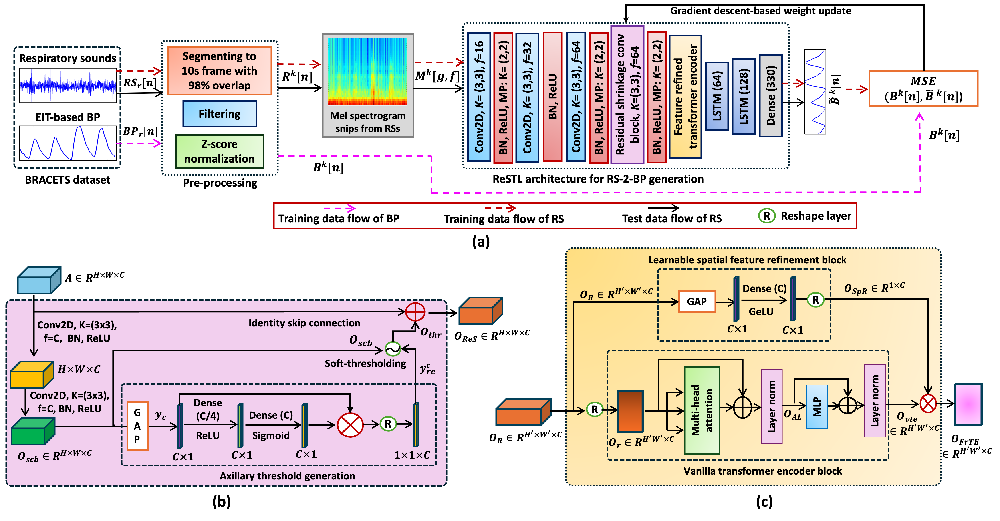

# **Training with TbDb data**

In [ ]:
!pip install mat73
import mat73
import cv2 as cvlib
import librosa
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy import signal
from google.colab import drive
drive.mount('/content/gdrive')
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder

Mounted at /content/gdrive


## **10-sec**

In [ ]:
# load the lung sound data (5 sec/ 10 sec/ 15 sec)and create mel spectrogram
'''LS_98_dict=mat73.loadmat('/content/gdrive/MyDrive/ARKA/EIT_work/TbDb/5_sec_data/LSs_TbDb_5sec.mat')
LS_98_sigs=LS_98_dict['LSs_TbDb_5sec']
r=len(LS_98_sigs[1,:])
nfft=1024
win_length=1024
sr=4000
melspec_list=[];mfcc_list=[]; cqt_list=[];
d_shape=64

import cv2 as cvlib
for i in range (r):
  clip=LS_98_sigs[:,i]
  # melspectrogram
  mel_spec=librosa.feature.melspectrogram(y=clip,sr=4000,n_mels=64,n_fft=1024,hop_length=524,win_length=1024,window='hann')
  log_melspec = librosa.amplitude_to_db(mel_spec)
  norm_melspec=(log_melspec-np.min(log_melspec))/(np.max(log_melspec)-np.min(log_melspec))
  mel_img=np.flip(norm_melspec, 0)
  melspec_list.append(mel_img)

melspec_set=np.array(melspec_list)
print('shape of melspectrogram dataset'+str(np.shape(melspec_set)))

import pickle
def pickle_save(location_to_save,dumping_var):
    outfile = open(location_to_save,'wb')
    pickle.dump(dumping_var,outfile)
    outfile.close()
    print('=========done=========')

base_location='/content/gdrive/MyDrive/ARKA/EIT_work/TbDb/5_sec_data/'
saving_melspec=base_location+'Melspecs_TbDb_5sec'

pickle_save(saving_melspec,melspec_set)

In [ ]:
EIT_98_dict=mat73.loadmat('/content/gdrive/MyDrive/ARKA/EIT_work/TbDb/10_sec_data/EIT_98d5ov_TbDb.mat')
EIT_98_sigs=EIT_98_dict['EITs_98d5ov']

import pickle
def load_pickle_file(name_of_file):
    infile = open(name_of_file,'rb')
    wgt = pickle.load(infile)
    infile.close()
    return wgt

Melspecs= load_pickle_file('/content/gdrive/MyDrive/ARKA/EIT_work/TbDb/10_sec_data/Melspecs_TbDb')
Melspecs_re=np.expand_dims(Melspecs, axis=-1)
EITs_re = np.expand_dims(EIT_98_sigs.T, axis=-1)

print('shape of melspectrogram dataset'+str(np.shape(Melspecs_re)))
print('shape of EIT dataset'+str(np.shape(EITs_re)))


shape of melspectrogram dataset(12904, 64, 77, 1)
shape of EIT dataset(12904, 330, 1)


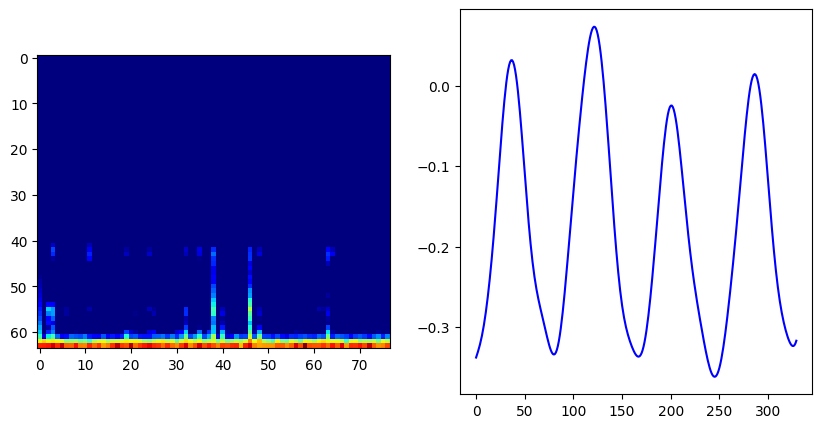

In [ ]:
idx=201
plt.figure(figsize=(10,5))
plt.subplot(122); plt.plot(EIT_98_sigs[:,idx],'b');
plt.subplot(121); plt.imshow(Melspecs[idx,:,:], cmap="jet");

In [ ]:
seed=10
X_train1, X_test, Y_train1,Y_test = train_test_split(Melspecs_re,EITs_re, test_size=0.1,random_state=seed)
X_train, X_valid,Y_train, Y_valid = train_test_split(X_train1,Y_train1,test_size=0.1,random_state=seed)

In [ ]:
import tensorflow as tf
from tensorflow.keras.layers import Layer, Conv2D, BatchNormalization, Activation, GlobalAveragePooling2D, Dense, Reshape, Multiply,MaxPooling2D,MultiHeadAttention, LayerNormalization, Dropout, Flatten, Add, Input,GlobalAveragePooling1D, LSTM, Reshape
from tensorflow.keras.models import Model

class ResidualShrinkage(Layer):
    def __init__(self, filters, **kwargs):
        super(ResidualShrinkage, self).__init__(**kwargs)
        self.filters = filters

    def build(self, input_shape):
        self.global_avg_pool = GlobalAveragePooling2D()
        self.dense_1 = Dense(self.filters // 4, activation='relu')
        self.dense_2 = Dense(self.filters, activation='sigmoid')
        super(ResidualShrinkage, self).build(input_shape)

    def call(self, inputs):
        # Global average pooling
        x = self.global_avg_pool(inputs)

        # Fully connected layers for learning thresholds
        x = self.dense_1(x)
        scales = self.dense_2(x)

        # Reshape to match input dimensions
        scales = Reshape((1, 1, self.filters))(scales)

        # Apply soft thresholding
        residual = inputs - tf.sign(inputs) * tf.maximum(tf.abs(inputs) - scales, 0)
        return residual

def residual_shrinkage_block(inputs, filters, kernel_size=3, strides=1):
    x = Conv2D(filters, kernel_size, strides=strides, padding='same')(inputs)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    x = Conv2D(filters, kernel_size, strides=1, padding='same')(x)
    x = BatchNormalization()(x)

    if strides > 1 or inputs.shape[-1] != filters:
        inputs = Conv2D(filters, kernel_size=1, strides=strides, padding='same')(inputs)

    x = ResidualShrinkage(filters)(x)

    x = tf.keras.layers.add([x, inputs])
    x = Activation('relu')(x)

    return x

class TransformerBlock(Layer):
    def __init__(self, embed_dim, num_heads, ff_dim, rate=0.1):
        super(TransformerBlock, self).__init__()
        self.att = MultiHeadAttention(num_heads=num_heads, key_dim=embed_dim)
        self.ffn = tf.keras.Sequential(
            [Dense(ff_dim, activation="relu"), Dense(embed_dim),]
        )
        self.layernorm1 = LayerNormalization(epsilon=1e-6)
        self.layernorm2 = LayerNormalization(epsilon=1e-6)
        self.dropout1 = Dropout(rate)
        self.dropout2 = Dropout(rate)

    def call(self, inputs, training):
        attn_output = self.att(inputs, inputs)
        attn_output = self.dropout1(attn_output, training=training)
        out1 = self.layernorm1(inputs + attn_output)
        ffn_output = self.ffn(out1)
        ffn_output = self.dropout2(ffn_output, training=training)
        return self.layernorm2(out1 + ffn_output)


In [ ]:
def build_model(input_shape):
    inputs = tf.keras.Input(shape=input_shape)
    x = Conv2D(16, kernel_size=3, strides=1)(inputs)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)
    x = MaxPooling2D((2, 2))(x)

    x = Conv2D(32, kernel_size=3, strides=1)(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    x = Conv2D(64, kernel_size=3, strides=1, padding='same')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)
    x = MaxPooling2D((2, 2))(x)

    x = residual_shrinkage_block(x, 64)
    x = MaxPooling2D((2, 2))(x)
    # Reshape the output to (batch_size, num_patches, embed_dim)
    x = Reshape((x.shape[1] * x.shape[2], x.shape[3]))(x)

    # Transformer Block
    x = TransformerBlock(embed_dim=64, num_heads=4, ff_dim=128)(x)

    x = LSTM(64, return_sequences=True)(x)
    x = LSTM(64)(x)

    outputs = Dense(330)(x)
    outputs = Reshape((330, 1))(outputs)
    model = Model(inputs, outputs)
    return model

EIT_model= build_model((64, 77, 1))
EIT_model.compile(optimizer='adam', loss='mse')
EIT_model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 64, 77, 1)]          0         []                            
                                                                                                  
 conv2d (Conv2D)             (None, 62, 75, 16)           160       ['input_1[0][0]']             
                                                                                                  
 batch_normalization (Batch  (None, 62, 75, 16)           64        ['conv2d[0][0]']              
 Normalization)                                                                                   
                                                                                                  
 activation (Activation)     (None, 62, 75, 16)           0         ['batch_normalization[0][0

In [ ]:
history = EIT_model.fit(
    X_train, Y_train,
    epochs=150,
    batch_size=32,
    validation_data=(X_valid, Y_valid )
)

Epoch 1/200
327/327 [==============================] - 30s 47ms/step - loss: 0.0583 - val_loss: 0.0566
Epoch 2/200
327/327 [==============================] - 13s 39ms/step - loss: 0.0315 - val_loss: 0.0314
Epoch 3/200
327/327 [==============================] - 11s 34ms/step - loss: 0.0238 - val_loss: 0.0209
Epoch 4/200
327/327 [==============================] - 13s 41ms/step - loss: 0.0186 - val_loss: 0.0182
Epoch 5/200
327/327 [==============================] - 10s 31ms/step - loss: 0.0147 - val_loss: 0.0164
Epoch 6/200
327/327 [==============================] - 12s 36ms/step - loss: 0.0124 - val_loss: 0.0129
Epoch 7/200
327/327 [==============================] - 15s 46ms/step - loss: 0.0103 - val_loss: 0.0118
Epoch 8/200
327/327 [==============================] - 12s 38ms/step - loss: 0.0088 - val_loss: 0.0109
Epoch 9/200
327/327 [==============================] - 11s 33ms/step - loss: 0.0076 - val_loss: 0.0139
Epoch 10/200
327/327 [==============================] - 14s 42ms/step - l

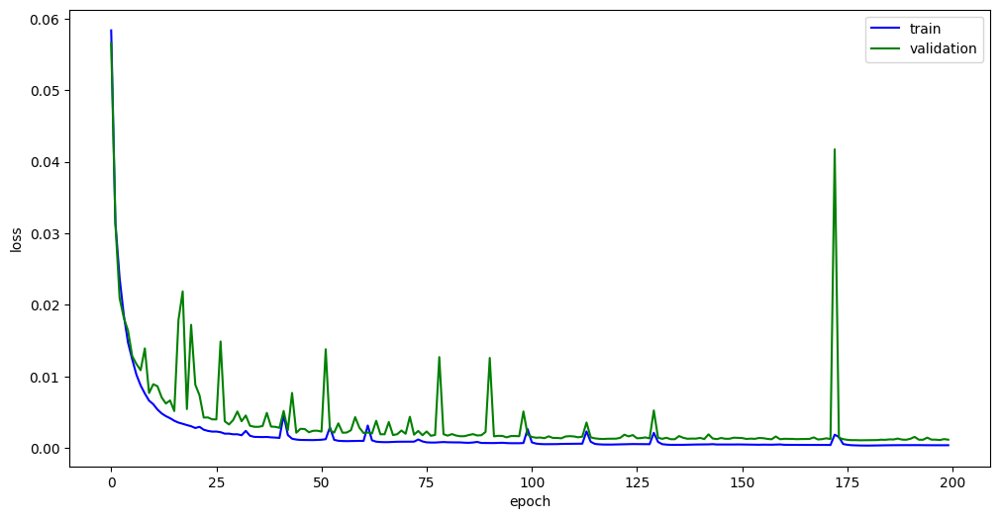

In [ ]:
plt.figure(figsize=(12,6))
plt.plot(history.history['loss'],'b')
plt.plot(history.history['val_loss'],'g')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'validation',], loc='best')
plt.show()

In [ ]:
predictions = EIT_model.predict(X_test)
# Print the outputs
print("Output Shape:", predictions.shape)

41/41 [==============================] - 1s 27ms/step
Output Shape: (1291, 330, 1)


In [ ]:
# Save the model architecture to a JSON file
model_json = EIT_model.to_json()
with open("/content/gdrive/MyDrive/ARKA/Cycle_work/shrinkcnn_transformer_lstm/Model/EIT_model.json", "w") as json_file:
    json_file.write(model_json)

# Save the model weights to an HDF5 file
EIT_model.save_weights("/content/gdrive/MyDrive/ARKA/Cycle_work/shrinkcnn_transformer_lstm/Model/EIT_model_weights.h5")


filenames = []

# Generate and save each plot as a PNG file
for i in range(predictions.shape[0]):
    plt.figure(figsize=(10, 5))

    plt.subplot(121)
    plt.plot(Y_test[i])
    plt.title("Actual EIT")

    plt.subplot(122)
    plt.plot(predictions[i])
    plt.title("Predicted EIT")

    filename = f'figure_{i}.png'
    plt.savefig(filename)
    plt.close()  # Close the figure to free memory
    filenames.append(filename)

!pip install imageio
import imageio

# Create a GIF from the saved PNG images
with imageio.get_writer('/content/gdrive/MyDrive/ARKA/Cycle_work/shrinkcnn_transformer_lstm/Prediction_images/output.gif', mode='I', duration=0.5) as writer:
    for filename in filenames:
        image = imageio.imread(filename)
        writer.append_data(image)

# Optionally, clean up the PNG files after creating the GIF
import os
for filename in filenames:
    os.remove(filename)

41/41 [==============================] - 4s 81ms/step
Output Shape: (1291, 330, 1)
(1291, 330)
(1291, 330)
saved data


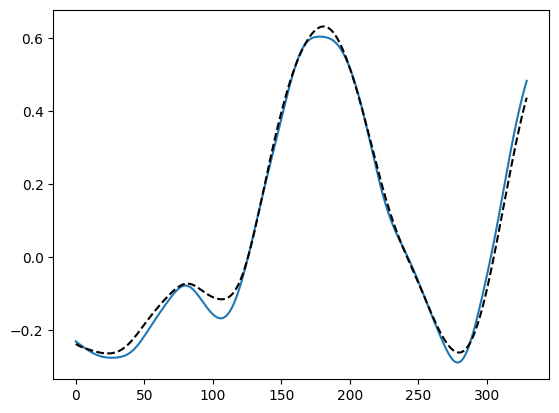

In [ ]:
import tensorflow as tf
from tensorflow.keras.layers import Layer, Conv2D, BatchNormalization, Activation, GlobalAveragePooling2D, Dense, Reshape, Add, MaxPooling2D, MultiHeadAttention, LayerNormalization, Dropout, LSTM, Input
from tensorflow.keras.models import Model

@tf.keras.utils.register_keras_serializable()
class ResidualShrinkage(Layer):
    def __init__(self, filters, **kwargs):
        super(ResidualShrinkage, self).__init__(**kwargs)
        self.filters = filters

    def build(self, input_shape):
        self.global_avg_pool = GlobalAveragePooling2D()
        self.dense_1 = Dense(self.filters // 4, activation='relu')
        self.dense_2 = Dense(self.filters, activation='sigmoid')
        super(ResidualShrinkage, self).build(input_shape)

    def call(self, inputs):
        # Global average pooling
        x = self.global_avg_pool(inputs)

        # Fully connected layers for learning thresholds
        x = self.dense_1(x)
        scales = self.dense_2(x)

        # Reshape to match input dimensions
        scales = Reshape((1, 1, self.filters))(scales)

        # Apply soft thresholding
        residual = inputs - tf.sign(inputs) * tf.maximum(tf.abs(inputs) - scales, 0)
        return residual

def residual_shrinkage_block(inputs, filters, kernel_size=3, strides=1):
    x = Conv2D(filters, kernel_size, strides=strides, padding='same')(inputs)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    x = Conv2D(filters, kernel_size, strides=1, padding='same')(x)
    x = BatchNormalization()(x)

    if strides > 1 or inputs.shape[-1] != filters:
        inputs = Conv2D(filters, kernel_size=1, strides=strides, padding='same')(inputs)

    x = ResidualShrinkage(filters)(x)

    x = Add()([x, inputs])
    x = Activation('relu')(x)

    return x

@tf.keras.utils.register_keras_serializable()
class TransformerBlock(Layer):
    def __init__(self, embed_dim, num_heads, ff_dim, rate=0.1):
        super(TransformerBlock, self).__init__()
        self.att = MultiHeadAttention(num_heads=num_heads, key_dim=embed_dim)
        self.ffn = tf.keras.Sequential(
            [Dense(ff_dim, activation="relu"), Dense(embed_dim)]
        )
        self.layernorm1 = LayerNormalization(epsilon=1e-6)
        self.layernorm2 = LayerNormalization(epsilon=1e-6)
        self.dropout1 = Dropout(rate)
        self.dropout2 = Dropout(rate)

    def call(self, inputs, training):
        attn_output = self.att(inputs, inputs)
        attn_output = self.dropout1(attn_output, training=training)
        out1 = self.layernorm1(inputs + attn_output)
        ffn_output = self.ffn(out1)
        ffn_output = self.dropout2(ffn_output, training=training)
        return self.layernorm2(out1 + ffn_output)

def build_model(input_shape):
    inputs = Input(shape=input_shape)
    x = Conv2D(16, kernel_size=3, strides=1)(inputs)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)
    x = MaxPooling2D((2, 2))(x)

    x = Conv2D(32, kernel_size=3, strides=1)(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    x = Conv2D(64, kernel_size=3, strides=1, padding='same')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)
    x = MaxPooling2D((2, 2))(x)

    x = residual_shrinkage_block(x, 64)
    x = MaxPooling2D((2, 2))(x)
    # Reshape the output to (batch_size, num_patches, embed_dim)
    x = Reshape((x.shape[1] * x.shape[2], x.shape[3]))(x)

    # Transformer Block
    x = TransformerBlock(embed_dim=64, num_heads=4, ff_dim=128)(x)

    x = LSTM(64, return_sequences=True)(x)
    x = LSTM(64)(x)

    outputs = Dense(330)(x)
    outputs = Reshape((330, 1))(outputs)
    model = Model(inputs, outputs)
    return model

EIT_model = build_model((64, 77, 1))
EIT_model.compile(optimizer='adam', loss='mse')
# EIT_model.summary()

from tensorflow.keras.models import model_from_json

# Load json
json_file = open('/content/gdrive/MyDrive/ARKA/EIT_work/Results/shrinkcnn_transformer_lstm/TbDb/Model/EIT_model.json', 'r')
EIT_model_json = json_file.read()
json_file.close()

# Register custom objects
custom_objects = {
    'ResidualShrinkage': ResidualShrinkage,
    'TransformerBlock': TransformerBlock
}

# Load model
EIT_model = model_from_json(EIT_model_json, custom_objects=custom_objects)
EIT_model.load_weights("/content/gdrive/MyDrive/ARKA/EIT_work/Results/shrinkcnn_transformer_lstm/TbDb/Model/EIT_model_weights.h5")

predictions = EIT_model.predict(X_test)
# Print the outputs
print("Output Shape:", predictions.shape)


pred_sqz=np.squeeze(predictions,axis=-1);
true=np.squeeze(Y_test,axis=-1)


plt.plot(true[1,:]);plt.plot(pred_sqz[1,:],'k--'); plt.show()

np.savetxt('/content/gdrive/MyDrive/ARKA/EIT_work/TbDb/10_sec_data/TbDb_true_10sec.txt',true)
np.savetxt('/content/gdrive/MyDrive/ARKA/EIT_work/TbDb/10_sec_data/TbDb_preds_10sec.txt',pred_sqz)
print('saved data')

In [ ]:
@tf.keras.utils.register_keras_serializable()
class ResidualShrinkage(Layer):
    def __init__(self, filters, **kwargs):
        super(ResidualShrinkage, self).__init__(**kwargs)
        self.filters = filters

    def build(self, input_shape):
        self.global_avg_pool = GlobalAveragePooling2D()
        self.dense_1 = Dense(self.filters // 4, activation='relu')
        self.dense_2 = Dense(self.filters, activation='sigmoid')
        super(ResidualShrinkage, self).build(input_shape)

    def call(self, inputs):
        # Global average pooling
        x = self.global_avg_pool(inputs)

        # Fully connected layers for learning thresholds
        x = self.dense_1(x)
        scales = self.dense_2(x)

        # Reshape to match input dimensions
        scales = Reshape((1, 1, self.filters))(scales)

        # Apply soft thresholding
        residual = inputs - tf.sign(inputs) * tf.maximum(tf.abs(inputs) - scales, 0)
        return residual

def residual_shrinkage_block(inputs, filters, kernel_size=3, strides=1):
    x = Conv2D(filters, kernel_size, strides=strides, padding='same')(inputs)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    x = Conv2D(filters, kernel_size, strides=1, padding='same')(x)
    x = BatchNormalization()(x)

    if strides > 1 or inputs.shape[-1] != filters:
        inputs = Conv2D(filters, kernel_size=1, strides=strides, padding='same')(inputs)

    x = ResidualShrinkage(filters)(x)

    x = Add()([x, inputs])
    x = Activation('relu')(x)

    return x

@tf.keras.utils.register_keras_serializable()
class TransformerBlock(Layer):
    def __init__(self, embed_dim, num_heads, ff_dim, rate=0.1):
        super(TransformerBlock, self).__init__()
        self.att = MultiHeadAttention(num_heads=num_heads, key_dim=embed_dim)
        self.ffn = tf.keras.Sequential(
            [Dense(ff_dim, activation="relu"), Dense(embed_dim)]
        )
        self.layernorm1 = LayerNormalization(epsilon=1e-6)
        self.layernorm2 = LayerNormalization(epsilon=1e-6)
        self.dropout1 = Dropout(rate)
        self.dropout2 = Dropout(rate)

    def call(self, inputs, training):
        attn_output = self.att(inputs, inputs)
        attn_output = self.dropout1(attn_output, training=training)
        out1 = self.layernorm1(inputs + attn_output)
        ffn_output = self.ffn(out1)
        ffn_output = self.dropout2(ffn_output, training=training)
        return self.layernorm2(out1 + ffn_output)

def build_model(input_shape):
    inputs = Input(shape=input_shape)
    x = Conv2D(16, kernel_size=3, strides=1)(inputs)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)
    x = MaxPooling2D((2, 2))(x)

    x = Conv2D(32, kernel_size=3, strides=1)(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    x = Conv2D(64, kernel_size=3, strides=1, padding='same')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)
    x = MaxPooling2D((2, 2))(x)

    x = residual_shrinkage_block(x, 64)
    x = MaxPooling2D((2, 2))(x)
    # Reshape the output to (batch_size, num_patches, embed_dim)
    x = Reshape((x.shape[1] * x.shape[2], x.shape[3]))(x)

    # Transformer Block
    x = TransformerBlock(embed_dim=64, num_heads=4, ff_dim=128)(x)

    x = LSTM(64, return_sequences=True)(x)
    x = LSTM(64)(x)

    outputs = Dense(330)(x)
    outputs = Reshape((330, 1))(outputs)
    model = Model(inputs, outputs)
    return model

EIT_model = build_model((64, 77, 1))
EIT_model.compile(optimizer='adam', loss='mse')
# EIT_model.summary()

from tensorflow.keras.models import model_from_json

# Load json
json_file = open('/content/gdrive/MyDrive/ARKA/Cycle_work/shrinkcnn_transformer_lstm/Model/EIT_model.json', 'r')
EIT_model_json = json_file.read()
json_file.close()

# Register custom objects
custom_objects = {
    'ResidualShrinkage': ResidualShrinkage,
    'TransformerBlock': TransformerBlock
}

# Load model
EIT_model = model_from_json(EIT_model_json, custom_objects=custom_objects)
EIT_model.load_weights("/content/gdrive/MyDrive/ARKA/Cycle_work/shrinkcnn_transformer_lstm/Model/EIT_model_weights.h5")


def get_melchunks_signal(window_length,overlap_percentage,signal):
    chunks = []
    step_size = window_length - round(window_length * overlap_percentage / 100)
    size_of_ls = len(signal)
    c = 0

    while c + window_length <= size_of_ls:
        seg_ls = signal[c:c + window_length]
        mel_spec=librosa.feature.melspectrogram(y=seg_ls,sr=4000,n_mels=64,n_fft=1024,hop_length=524,win_length=1024,window='hann')
        log_melspec = librosa.amplitude_to_db(mel_spec)
        norm_melspec=(log_melspec-np.min(log_melspec))/(np.max(log_melspec)-np.min(log_melspec))
        mel_img=np.flip(norm_melspec, 0)
        chunks.append(mel_img)  # Store the segment
        c += step_size

    chunks=np.array(chunks)
    chunks_re=np.expand_dims(chunks, axis=-1)
    return chunks_re

def get_timechunks_signal(window_length,overlap_percentage,signal):
    chunks = []
    step_size = window_length - round(window_length * overlap_percentage / 100)
    size_of_ls = len(signal)
    c = 0

    while c + window_length <= size_of_ls:
        seg_ls = signal[c:c + window_length]
        chunks.append(seg_ls)  # Store the segment
        c += step_size

    chunks=np.array(chunks)
    return chunks

# Function definition
def reconstruct_signal(predictions, window_length, overlap_percentage):
    step_size = window_length - round(window_length * overlap_percentage / 100)
    signal_length = step_size * (len(predictions) - 1) + window_length
    reconstructed_signal = np.zeros((signal_length, 1))  # Initialize with shape (signal_length, 1)
    overlap_count = np.zeros((signal_length, 1))         # Initialize with shape (signal_length, 1)

    for i, pred in enumerate(predictions):
        start = i * step_size
        end = start + window_length
        reconstructed_signal[start:end] += pred
        overlap_count[start:end] += 1

    overlap_count[overlap_count == 0] = 1
    reconstructed_signal /= overlap_count

    return reconstructed_signal

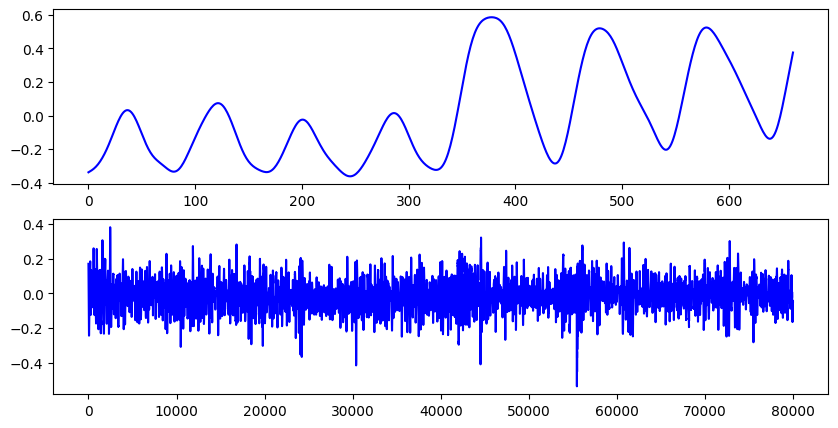

In [ ]:
EIT_dict=mat73.loadmat('/content/eit.mat')
EIT=EIT_dict['eit']
LS_dict=mat73.loadmat('/content/ls.mat')
LS=LS_dict['ls']

idx=2;
LS_sigs=LS
EIT_sigs=EIT


plt.figure(figsize=(10,5))
plt.subplot(211); plt.plot(EIT_sigs,'b');
plt.subplot(212); plt.plot(LS_sigs,'b');

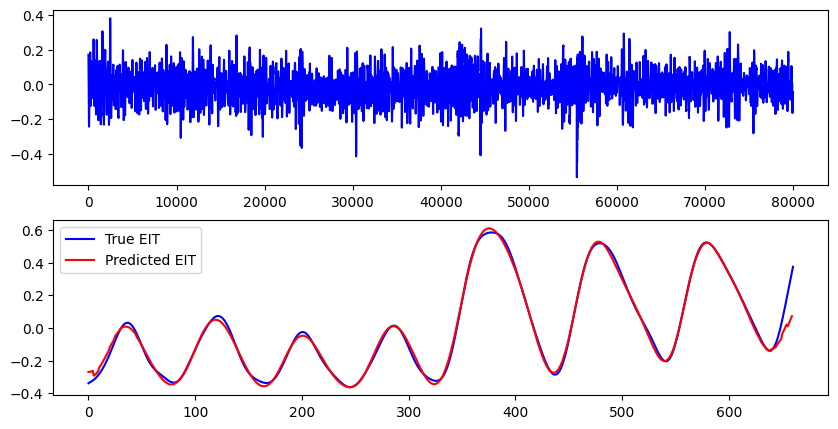

In [ ]:
LSs_chunk=get_timechunks_signal(40000,98.5,LS_sigs)
EITs_chunk=get_timechunks_signal(330,98.5,EIT_sigs)
EITs_chunk_re=np.expand_dims(EITs_chunk, axis=-1)

LSs_mel_chunk=get_melchunks_signal(40000,98.5,LS_sigs)
predictions = EIT_model.predict(LSs_mel_chunk)

full_eit_recons=reconstruct_signal(predictions, predictions.shape[1], 98.5)

plt.figure(figsize=(10,5))
plt.subplot(211); plt.plot(LS_sigs,'b');
plt.subplot(212); plt.plot(EIT_sigs,'b',label='True EIT');
plt.plot(full_eit_recons,'r',label='Predicted EIT');
plt.legend()
plt.show()

## **15-sec**

In [ ]:
!pip install mat73
import mat73
import cv2 as cvlib
import librosa
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy import signal
from google.colab import drive
drive.mount('/content/gdrive')
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder

Mounted at /content/gdrive


In [ ]:
EIT_98_dict=mat73.loadmat('/content/gdrive/MyDrive/ARKA/EIT_work/TbDb/15_sec_data/EITs_TbDb_15sec.mat')
EIT_98_sigs=EIT_98_dict['EITs_TbDb_15sec']

import pickle
def load_pickle_file(name_of_file):
    infile = open(name_of_file,'rb')
    wgt = pickle.load(infile)
    infile.close()
    return wgt

Melspecs= load_pickle_file('/content/gdrive/MyDrive/ARKA/EIT_work/TbDb/15_sec_data/Melspecs_TbDb_15sec')
Melspecs_re=np.expand_dims(Melspecs, axis=-1)
EITs_re = np.expand_dims(EIT_98_sigs.T, axis=-1)

print('shape of melspectrogram dataset'+str(np.shape(Melspecs_re)))
print('shape of EIT dataset'+str(np.shape(EITs_re)))

seed=10
X_train1, X_test, Y_train1,Y_test = train_test_split(Melspecs_re,EITs_re, test_size=0.1,random_state=seed)
X_train, X_valid,Y_train, Y_valid = train_test_split(X_train1,Y_train1,test_size=0.1,random_state=seed)

shape of melspectrogram dataset(4561, 64, 115, 1)
shape of EIT dataset(4561, 495, 1)


Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_3 (InputLayer)        [(None, 64, 115, 1)]         0         []                            
                                                                                                  
 conv2d_10 (Conv2D)          (None, 62, 113, 16)          160       ['input_3[0][0]']             
                                                                                                  
 batch_normalization_10 (Ba  (None, 62, 113, 16)          64        ['conv2d_10[0][0]']           
 tchNormalization)                                                                                
                                                                                                  
 activation_10 (Activation)  (None, 62, 113, 16)          0         ['batch_normalization_10

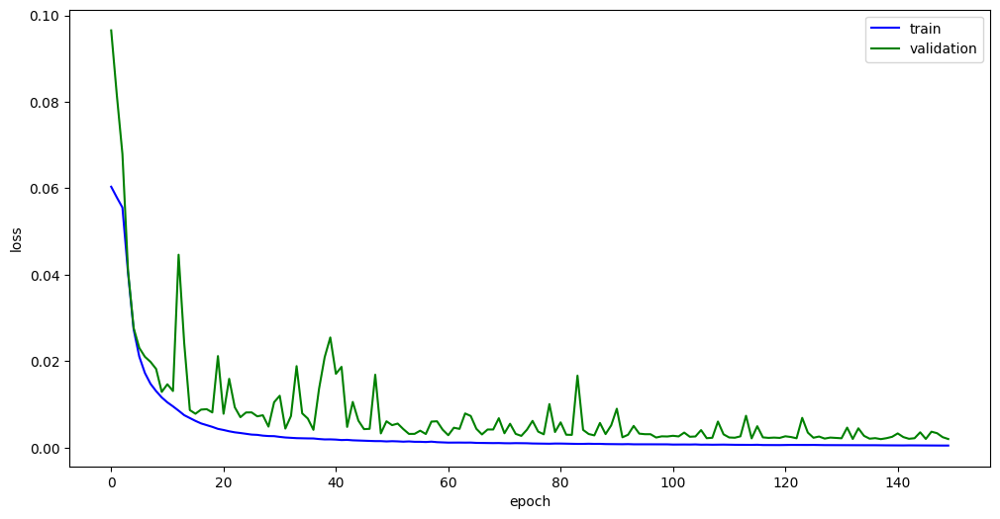

In [ ]:

import tensorflow as tf
from tensorflow.keras.layers import Layer, Conv2D, BatchNormalization, Activation, GlobalAveragePooling2D, Dense, Reshape, Multiply,MaxPooling2D,MultiHeadAttention, LayerNormalization, Dropout, Flatten, Add, Input,GlobalAveragePooling1D, LSTM, Reshape
from tensorflow.keras.models import Model

class ResidualShrinkage(Layer):
    def __init__(self, filters, **kwargs):
        super(ResidualShrinkage, self).__init__(**kwargs)
        self.filters = filters

    def build(self, input_shape):
        self.global_avg_pool = GlobalAveragePooling2D()
        self.dense_1 = Dense(self.filters // 4, activation='relu')
        self.dense_2 = Dense(self.filters, activation='sigmoid')
        super(ResidualShrinkage, self).build(input_shape)

    def call(self, inputs):
        # Global average pooling
        x = self.global_avg_pool(inputs)

        # Fully connected layers for learning thresholds
        x = self.dense_1(x)
        scales = self.dense_2(x)

        # Reshape to match input dimensions
        scales = Reshape((1, 1, self.filters))(scales)

        # Apply soft thresholding
        residual = inputs - tf.sign(inputs) * tf.maximum(tf.abs(inputs) - scales, 0)
        return residual

def residual_shrinkage_block(inputs, filters, kernel_size=3, strides=1):
    x = Conv2D(filters, kernel_size, strides=strides, padding='same')(inputs)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    x = Conv2D(filters, kernel_size, strides=1, padding='same')(x)
    x = BatchNormalization()(x)

    if strides > 1 or inputs.shape[-1] != filters:
        inputs = Conv2D(filters, kernel_size=1, strides=strides, padding='same')(inputs)

    x = ResidualShrinkage(filters)(x)

    x = tf.keras.layers.add([x, inputs])
    x = Activation('relu')(x)

    return x

class TransformerBlock(Layer):
    def __init__(self, embed_dim, num_heads, ff_dim, rate=0.1):
        super(TransformerBlock, self).__init__()
        self.att = MultiHeadAttention(num_heads=num_heads, key_dim=embed_dim)
        self.ffn = tf.keras.Sequential(
            [Dense(ff_dim, activation="relu"), Dense(embed_dim),]
        )
        self.layernorm1 = LayerNormalization(epsilon=1e-6)
        self.layernorm2 = LayerNormalization(epsilon=1e-6)
        self.dropout1 = Dropout(rate)
        self.dropout2 = Dropout(rate)

    def call(self, inputs, training):
        attn_output = self.att(inputs, inputs)
        attn_output = self.dropout1(attn_output, training=training)
        out1 = self.layernorm1(inputs + attn_output)
        ffn_output = self.ffn(out1)
        ffn_output = self.dropout2(ffn_output, training=training)
        return self.layernorm2(out1 + ffn_output)

def build_model(input_shape):
    inputs = tf.keras.Input(shape=input_shape)
    x = Conv2D(16, kernel_size=3, strides=1)(inputs)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)
    x = MaxPooling2D((2, 2))(x)

    x = Conv2D(32, kernel_size=3, strides=1)(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    x = Conv2D(64, kernel_size=3, strides=1, padding='same')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)
    x = MaxPooling2D((2, 2))(x)

    x = residual_shrinkage_block(x, 64)
    x = MaxPooling2D((2, 2))(x)
    # Reshape the output to (batch_size, num_patches, embed_dim)
    x = Reshape((x.shape[1] * x.shape[2], x.shape[3]))(x)

    # Transformer Block
    x = TransformerBlock(embed_dim=64, num_heads=4, ff_dim=128)(x)

    x = LSTM(64, return_sequences=True)(x)
    x = LSTM(64)(x)

    outputs = Dense(EITs_re.shape[1])(x)
    outputs = Reshape((EITs_re.shape[1], 1))(outputs)
    model = Model(inputs, outputs)
    return model

EIT_model_tbdb_15sec= build_model((Melspecs_re.shape[1], Melspecs_re.shape[2], 1))
EIT_model_tbdb_15sec.compile(optimizer='adam', loss='mse')
EIT_model_tbdb_15sec.summary()

history = EIT_model_tbdb_15sec.fit(
    X_train, Y_train,
    epochs=150,
    batch_size=32,
    validation_data=(X_valid, Y_valid )
)

plt.figure(figsize=(12,6))
plt.plot(history.history['loss'],'b')
plt.plot(history.history['val_loss'],'g')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'validation',], loc='best')
plt.show()

In [ ]:
new_loc='/content/gdrive/MyDrive/ARKA/EIT_work/TbDb/15_sec_data/'
# save the plot varriables
filepath_tloss=new_loc+'/train_loss_15sec_tbdb.txt'; np.savetxt(filepath_tloss,history.history['loss'])
filepath_vloss=new_loc+'/val_loss_15sec_tbdb.txt'; np.savetxt(filepath_vloss,history.history['val_loss'])

In [ ]:
# Save the model architecture to a JSON file
model_json = EIT_model_tbdb_15sec.to_json()
with open("/content/gdrive/MyDrive/ARKA/EIT_work/TbDb/15_sec_data/EIT_model_tbdb_15sec.json", "w") as json_file:
    json_file.write(model_json)

# Save the model weights to an HDF5 file
EIT_model_tbdb_15sec.save_weights("/content/gdrive/MyDrive/ARKA/EIT_work/TbDb/15_sec_data/EIT_model_tbdb_15sec_weights.h5")


## **5-sec**

shape of melspectrogram dataset(5208, 64, 39, 1)
shape of EIT dataset(5208, 165, 1)
Model: "model_3"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_4 (InputLayer)        [(None, 64, 39, 1)]          0         []                            
                                                                                                  
 conv2d_15 (Conv2D)          (None, 62, 37, 16)           160       ['input_4[0][0]']             
                                                                                                  
 batch_normalization_15 (Ba  (None, 62, 37, 16)           64        ['conv2d_15[0][0]']           
 tchNormalization)                                                                                
                                                                                                  
 activat

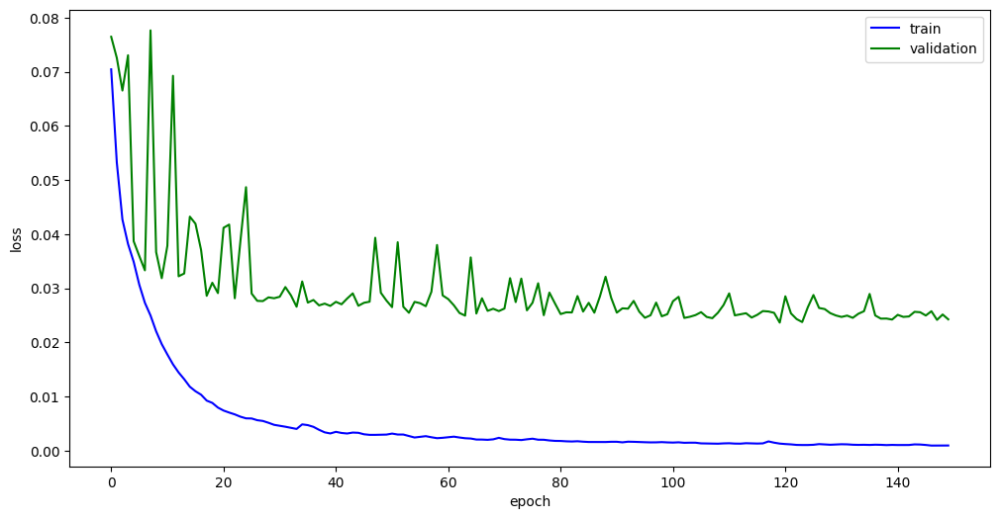

In [ ]:
EIT_98_dict=mat73.loadmat('/content/gdrive/MyDrive/ARKA/EIT_work/TbDb/5_sec_data/EITs_TbDb_5sec.mat')
EIT_98_sigs=EIT_98_dict['EITs_TbDb_5sec']

import pickle
def load_pickle_file(name_of_file):
    infile = open(name_of_file,'rb')
    wgt = pickle.load(infile)
    infile.close()
    return wgt

Melspecs= load_pickle_file('/content/gdrive/MyDrive/ARKA/EIT_work/TbDb/5_sec_data/Melspecs_TbDb_5sec')
Melspecs_re=np.expand_dims(Melspecs, axis=-1)
EITs_re = np.expand_dims(EIT_98_sigs.T, axis=-1)

print('shape of melspectrogram dataset'+str(np.shape(Melspecs_re)))
print('shape of EIT dataset'+str(np.shape(EITs_re)))

seed=10
X_train1, X_test, Y_train1,Y_test = train_test_split(Melspecs_re,EITs_re, test_size=0.1,random_state=seed)
X_train, X_valid,Y_train, Y_valid = train_test_split(X_train1,Y_train1,test_size=0.1,random_state=seed)


import tensorflow as tf
from tensorflow.keras.layers import Layer, Conv2D, BatchNormalization, Activation, GlobalAveragePooling2D, Dense, Reshape, Multiply,MaxPooling2D,MultiHeadAttention, LayerNormalization, Dropout, Flatten, Add, Input,GlobalAveragePooling1D, LSTM, Reshape
from tensorflow.keras.models import Model

class ResidualShrinkage(Layer):
    def __init__(self, filters, **kwargs):
        super(ResidualShrinkage, self).__init__(**kwargs)
        self.filters = filters

    def build(self, input_shape):
        self.global_avg_pool = GlobalAveragePooling2D()
        self.dense_1 = Dense(self.filters // 4, activation='relu')
        self.dense_2 = Dense(self.filters, activation='sigmoid')
        super(ResidualShrinkage, self).build(input_shape)

    def call(self, inputs):
        # Global average pooling
        x = self.global_avg_pool(inputs)

        # Fully connected layers for learning thresholds
        x = self.dense_1(x)
        scales = self.dense_2(x)

        # Reshape to match input dimensions
        scales = Reshape((1, 1, self.filters))(scales)

        # Apply soft thresholding
        residual = inputs - tf.sign(inputs) * tf.maximum(tf.abs(inputs) - scales, 0)
        return residual

def residual_shrinkage_block(inputs, filters, kernel_size=3, strides=1):
    x = Conv2D(filters, kernel_size, strides=strides, padding='same')(inputs)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    x = Conv2D(filters, kernel_size, strides=1, padding='same')(x)
    x = BatchNormalization()(x)

    if strides > 1 or inputs.shape[-1] != filters:
        inputs = Conv2D(filters, kernel_size=1, strides=strides, padding='same')(inputs)

    x = ResidualShrinkage(filters)(x)

    x = tf.keras.layers.add([x, inputs])
    x = Activation('relu')(x)

    return x

class TransformerBlock(Layer):
    def __init__(self, embed_dim, num_heads, ff_dim, rate=0.1):
        super(TransformerBlock, self).__init__()
        self.att = MultiHeadAttention(num_heads=num_heads, key_dim=embed_dim)
        self.ffn = tf.keras.Sequential(
            [Dense(ff_dim, activation="relu"), Dense(embed_dim),]
        )
        self.layernorm1 = LayerNormalization(epsilon=1e-6)
        self.layernorm2 = LayerNormalization(epsilon=1e-6)
        self.dropout1 = Dropout(rate)
        self.dropout2 = Dropout(rate)

    def call(self, inputs, training):
        attn_output = self.att(inputs, inputs)
        attn_output = self.dropout1(attn_output, training=training)
        out1 = self.layernorm1(inputs + attn_output)
        ffn_output = self.ffn(out1)
        ffn_output = self.dropout2(ffn_output, training=training)
        return self.layernorm2(out1 + ffn_output)

def build_model(input_shape):
    inputs = tf.keras.Input(shape=input_shape)
    x = Conv2D(16, kernel_size=3, strides=1)(inputs)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)
    x = MaxPooling2D((2, 2))(x)

    x = Conv2D(32, kernel_size=3, strides=1)(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    x = Conv2D(64, kernel_size=3, strides=1, padding='same')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)
    x = MaxPooling2D((2, 2))(x)

    x = residual_shrinkage_block(x, 64)
    x = MaxPooling2D((2, 2))(x)
    # Reshape the output to (batch_size, num_patches, embed_dim)
    x = Reshape((x.shape[1] * x.shape[2], x.shape[3]))(x)

    # Transformer Block
    x = TransformerBlock(embed_dim=64, num_heads=4, ff_dim=128)(x)

    x = LSTM(64, return_sequences=True)(x)
    x = LSTM(64)(x)

    outputs = Dense(EITs_re.shape[1])(x)
    outputs = Reshape((EITs_re.shape[1], 1))(outputs)
    model = Model(inputs, outputs)
    return model

EIT_model_tbdb_5sec= build_model((Melspecs_re.shape[1], Melspecs_re.shape[2], 1))
EIT_model_tbdb_5sec.compile(optimizer='adam', loss='mse')
EIT_model_tbdb_5sec.summary()

history = EIT_model_tbdb_5sec.fit(
    X_train, Y_train,
    epochs=150,
    batch_size=32,
    validation_data=(X_valid, Y_valid )
)

plt.figure(figsize=(12,6))
plt.plot(history.history['loss'],'b')
plt.plot(history.history['val_loss'],'g')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'validation',], loc='best')
plt.show()

In [ ]:
new_loc='/content/gdrive/MyDrive/ARKA/EIT_work/TbDb/5_sec_data/'
# save the plot varriables
filepath_tloss=new_loc+'/train_loss_5sec_tbdb.txt'; np.savetxt(filepath_tloss,history.history['loss'])
filepath_vloss=new_loc+'/val_loss_5sec_tbdb.txt'; np.savetxt(filepath_vloss,history.history['val_loss'])

# Save the model architecture to a JSON file
model_json = EIT_model_tbdb_5sec.to_json()
with open("/content/gdrive/MyDrive/ARKA/EIT_work/TbDb/5_sec_data/EIT_model_tbdb_5sec.json", "w") as json_file:
    json_file.write(model_json)

# Save the model weights to an HDF5 file
EIT_model_tbdb_5sec.save_weights("/content/gdrive/MyDrive/ARKA/EIT_work/TbDb/5_sec_data/EIT_model_tbdb_5sec_weights.h5")


# **Training with TBCS data**

In [ ]:
!pip install mat73
import mat73
import cv2 as cvlib
import librosa
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy import signal
from google.colab import drive
drive.mount('/content/gdrive')
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder

Mounted at /content/gdrive


In [ ]:
EIT_98_dict=mat73.loadmat('/content/gdrive/MyDrive/ARKA/EIT_work/TbCS/5_sec_data/EITs_tbcs_5sec.mat')
EIT_98_sigs=EIT_98_dict['EITs_tbcs_5sec']
LS_98_dict=mat73.loadmat('/content/gdrive/MyDrive/ARKA/EIT_work/TbCS/5_sec_data/LSs_tbcs_5sec.mat')
LS_98_sigs=LS_98_dict['LSs_tbcs_5sec']

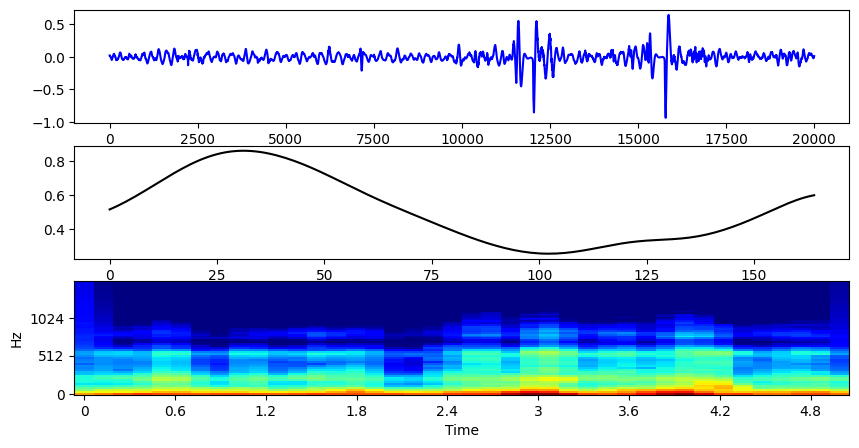

In [ ]:
idx=201; sr=4000;
plt.figure(figsize=(10,5))
plt.subplot(311); plt.plot(LS_98_sigs[:,idx],'b');
plt.subplot(312); plt.plot(EIT_98_sigs[:,idx],'k')
S = librosa.feature.melspectrogram(y=LS_98_sigs[:,idx], sr=4000, n_mels=64)
S_dB = librosa.power_to_db(S, ref=np.max)
plt.subplot(313);librosa.display.specshow(S_dB, x_axis='time',
                         y_axis='mel', sr=sr,cmap='jet');

In [ ]:
r=len(LS_98_sigs[1,:])
nfft=1024
win_length=1024
sr=4000
melspec_list=[];mfcc_list=[]; cqt_list=[];
d_shape=64

import cv2 as cvlib
for i in range (r):
  clip=LS_98_sigs[:,i]
  # melspectrogram
  mel_spec=librosa.feature.melspectrogram(y=clip,sr=4000,n_mels=64,n_fft=1024,hop_length=524,win_length=1024,window='hann')
  log_melspec = librosa.amplitude_to_db(mel_spec)
  norm_melspec=(log_melspec-np.min(log_melspec))/(np.max(log_melspec)-np.min(log_melspec))
  mel_img=np.flip(norm_melspec, 0)
  melspec_list.append(mel_img)

melspec_set=np.array(melspec_list)
print('shape of melspectrogram dataset'+str(np.shape(melspec_set)))


shape of melspectrogram dataset(5208, 64, 39)


In [ ]:
import pickle
def pickle_save(location_to_save,dumping_var):
    outfile = open(location_to_save,'wb')
    pickle.dump(dumping_var,outfile)
    outfile.close()
    print('=========done=========')

base_location='/content/gdrive/MyDrive/ARKA/EIT_work/TbCS/5_sec_data/'
saving_melspec=base_location+'Melspecs_tbcs_5sec'

pickle_save(saving_melspec,melspec_set)

=========done=========


## **10-sec**

In [ ]:
EIT_98_dict=mat73.loadmat('/content/gdrive/MyDrive/ARKA/EIT_work/TbCS/EIT_tbcs.mat')
EIT_98_sigs=EIT_98_dict['EITs_tbcs']

import pickle
def load_pickle_file(name_of_file):
    infile = open(name_of_file,'rb')
    wgt = pickle.load(infile)
    infile.close()
    return wgt

Melspecs= load_pickle_file('/content/gdrive/MyDrive/ARKA/EIT_work/TbCS/Melspecs_tbcs')
Melspecs_re=np.expand_dims(Melspecs, axis=-1)
EITs_re = np.expand_dims(EIT_98_sigs.T, axis=-1)

print('shape of melspectrogram dataset'+str(np.shape(Melspecs_re)))
print('shape of EIT dataset'+str(np.shape(EITs_re)))


shape of melspectrogram dataset(12900, 64, 77, 1)
shape of EIT dataset(12900, 330, 1)


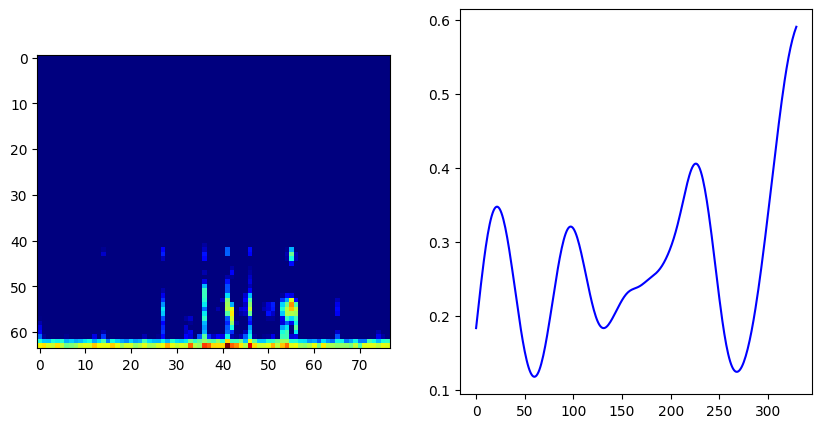

In [ ]:
idx=201
plt.figure(figsize=(10,5))
plt.subplot(122); plt.plot(EIT_98_sigs[:,idx],'b');
plt.subplot(121); plt.imshow(Melspecs[idx,:,:], cmap="jet");

In [ ]:
seed=10
X_train1, X_test, Y_train1,Y_test = train_test_split(Melspecs_re,EITs_re, test_size=0.1,random_state=seed)
X_train, X_valid,Y_train, Y_valid = train_test_split(X_train1,Y_train1,test_size=0.1,random_state=seed)

In [ ]:
import tensorflow as tf
from tensorflow.keras.layers import Layer, Conv2D, BatchNormalization, Activation, GlobalAveragePooling2D, Dense, Reshape, Multiply,MaxPooling2D,MultiHeadAttention, LayerNormalization, Dropout, Flatten, Add, Input,GlobalAveragePooling1D, LSTM, Reshape
from tensorflow.keras.models import Model

class ResidualShrinkage(Layer):
    def __init__(self, filters, **kwargs):
        super(ResidualShrinkage, self).__init__(**kwargs)
        self.filters = filters

    def build(self, input_shape):
        self.global_avg_pool = GlobalAveragePooling2D()
        self.dense_1 = Dense(self.filters // 4, activation='relu')
        self.dense_2 = Dense(self.filters, activation='sigmoid')
        super(ResidualShrinkage, self).build(input_shape)

    def call(self, inputs):
        # Global average pooling
        x = self.global_avg_pool(inputs)

        # Fully connected layers for learning thresholds
        x = self.dense_1(x)
        scales = self.dense_2(x)

        # Reshape to match input dimensions
        scales = Reshape((1, 1, self.filters))(scales)

        # Apply soft thresholding
        residual = inputs - tf.sign(inputs) * tf.maximum(tf.abs(inputs) - scales, 0)
        return residual

def residual_shrinkage_block(inputs, filters, kernel_size=3, strides=1):
    x = Conv2D(filters, kernel_size, strides=strides, padding='same')(inputs)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    x = Conv2D(filters, kernel_size, strides=1, padding='same')(x)
    x = BatchNormalization()(x)

    if strides > 1 or inputs.shape[-1] != filters:
        inputs = Conv2D(filters, kernel_size=1, strides=strides, padding='same')(inputs)

    x = ResidualShrinkage(filters)(x)

    x = tf.keras.layers.add([x, inputs])
    x = Activation('relu')(x)

    return x

class TransformerBlock(Layer):
    def __init__(self, embed_dim, num_heads, ff_dim, rate=0.1):
        super(TransformerBlock, self).__init__()
        self.att = MultiHeadAttention(num_heads=num_heads, key_dim=embed_dim)
        self.ffn = tf.keras.Sequential(
            [Dense(ff_dim, activation="relu"), Dense(embed_dim),]
        )
        self.layernorm1 = LayerNormalization(epsilon=1e-6)
        self.layernorm2 = LayerNormalization(epsilon=1e-6)
        self.dropout1 = Dropout(rate)
        self.dropout2 = Dropout(rate)

    def call(self, inputs, training):
        attn_output = self.att(inputs, inputs)
        attn_output = self.dropout1(attn_output, training=training)
        out1 = self.layernorm1(inputs + attn_output)
        ffn_output = self.ffn(out1)
        ffn_output = self.dropout2(ffn_output, training=training)
        return self.layernorm2(out1 + ffn_output)


In [ ]:
def build_model(input_shape):
    inputs = tf.keras.Input(shape=input_shape)
    x = Conv2D(16, kernel_size=3, strides=1)(inputs)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)
    x = MaxPooling2D((2, 2))(x)

    x = Conv2D(32, kernel_size=3, strides=1)(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    x = Conv2D(64, kernel_size=3, strides=1, padding='same')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)
    x = MaxPooling2D((2, 2))(x)

    x = residual_shrinkage_block(x, 64)
    x = MaxPooling2D((2, 2))(x)
    # Reshape the output to (batch_size, num_patches, embed_dim)
    x = Reshape((x.shape[1] * x.shape[2], x.shape[3]))(x)

    # Transformer Block
    x = TransformerBlock(embed_dim=64, num_heads=4, ff_dim=128)(x)

    x = LSTM(64, return_sequences=True)(x)
    x = LSTM(64)(x)

    outputs = Dense(330)(x)
    outputs = Reshape((330, 1))(outputs)
    model = Model(inputs, outputs)
    return model

EIT_model_tbcs= build_model((64, 77, 1))
EIT_model_tbcs.compile(optimizer='adam', loss='mse')

In [ ]:
history = EIT_model_tbcs.fit(
    X_train, Y_train,
    epochs=150,
    batch_size=32,
    validation_data=(X_valid, Y_valid )
)

Epoch 1/150
327/327 [==============================] - 26s 35ms/step - loss: 0.0479 - val_loss: 0.0539
Epoch 2/150
327/327 [==============================] - 8s 25ms/step - loss: 0.0329 - val_loss: 0.0300
Epoch 3/150
327/327 [==============================] - 12s 36ms/step - loss: 0.0248 - val_loss: 0.0255
Epoch 4/150
327/327 [==============================] - 13s 39ms/step - loss: 0.0207 - val_loss: 0.0201
Epoch 5/150
327/327 [==============================] - 10s 30ms/step - loss: 0.0170 - val_loss: 0.0156
Epoch 6/150
327/327 [==============================] - 10s 30ms/step - loss: 0.0140 - val_loss: 0.0132
Epoch 7/150
327/327 [==============================] - 10s 32ms/step - loss: 0.0116 - val_loss: 0.0126
Epoch 8/150
327/327 [==============================] - 11s 33ms/step - loss: 0.0099 - val_loss: 0.0102
Epoch 9/150
327/327 [==============================] - 9s 27ms/step - loss: 0.0084 - val_loss: 0.0091
Epoch 10/150
327/327 [==============================] - 9s 29ms/step - loss

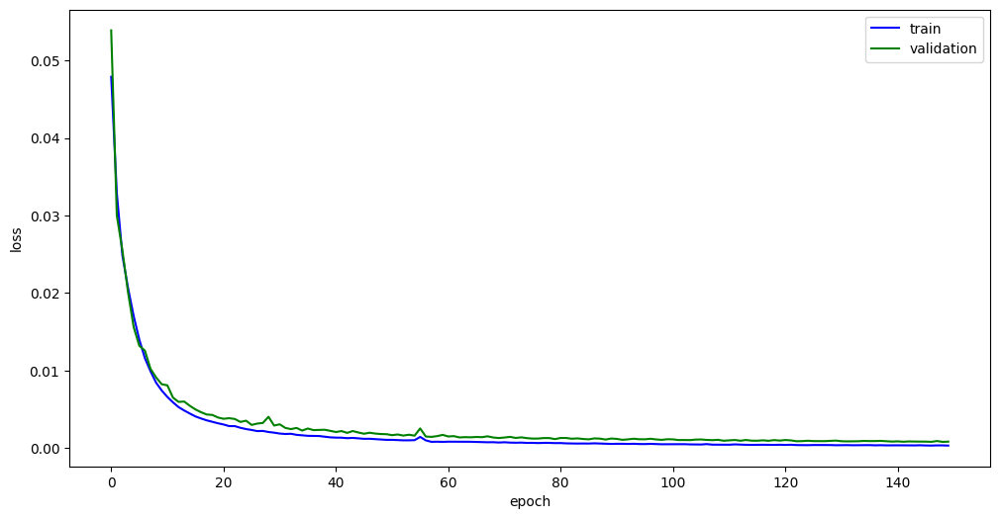

In [ ]:
plt.figure(figsize=(12,6))
plt.plot(history.history['loss'],'b')
plt.plot(history.history['val_loss'],'g')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'validation',], loc='best')
plt.show()

In [ ]:
predictions = EIT_model_tbcs.predict(X_test)
# Print the outputs
print("Output Shape:", predictions.shape)

41/41 [==============================] - 4s 70ms/step
Output Shape: (1290, 330, 1)


In [ ]:
import matplotlib.pyplot as plt

# Plot actual and decoded EIT
for i in range (predictions.shape[0]):
    plt.figure(figsize=(10, 5))
    plt.subplot(121)
    plt.plot(Y_test[i])
    plt.title("Actual EIT")
    plt.subplot(122)
    plt.plot(predictions[i])
    plt.title("Predicted EIT")
    plt.show()

In [ ]:
# Save the model architecture to a JSON file
model_json = EIT_model_tbcs.to_json()
with open("/content/gdrive/MyDrive/ARKA/EIT_work/shrinkcnn_transformer_lstm/TbCS/Model/EIT_model_tbcs.json", "w") as json_file:
    json_file.write(model_json)

# Save the model weights to an HDF5 file
EIT_model_tbcs.save_weights("/content/gdrive/MyDrive/ARKA/EIT_work/shrinkcnn_transformer_lstm/TbCS/Model/EIT_model_weights_tbcs.h5")

In [ ]:
filenames = []

# Generate and save each plot as a PNG file
for i in range(predictions.shape[0]):
    plt.figure(figsize=(10, 5))

    plt.subplot(121)
    plt.plot(Y_test[i])
    plt.title("Actual EIT")

    plt.subplot(122)
    plt.plot(predictions[i])
    plt.title("Predicted EIT")

    filename = f'figure_{i}.png'
    plt.savefig(filename)
    plt.close()  # Close the figure to free memory
    filenames.append(filename)

!pip install imageio
import imageio

# Create a GIF from the saved PNG images
with imageio.get_writer('/content/gdrive/MyDrive/ARKA/EIT_work/shrinkcnn_transformer_lstm/TbCS/Prediction_images/output.gif', mode='I', duration=0.5) as writer:
    for filename in filenames:
        image = imageio.imread(filename)
        writer.append_data(image)

# Optionally, clean up the PNG files after creating the GIF
import os
for filename in filenames:
    os.remove(filename)

<ipython-input-12-8eded2de1918>:26: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)
<ipython-input-12-8eded2de1918>:26: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)
<ipython-input-12-8eded2de1918>:26: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)
<ipython-input-12-8eded2de1918>:26: Depr

## **15-sec**

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).
shape of melspectrogram dataset(2280, 64, 115, 1)
shape of EIT dataset(2280, 495, 1)
Model: "model_4"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_5 (InputLayer)        [(None, 64, 115, 1)]         0         []                            
                                                                                                  
 conv2d_20 (Conv2D)          (None, 62, 113, 16)          160       ['input_5[0][0]']             
                                                                                                  
 batch_normalization_20 (Ba  (None, 62, 113, 16)          64        ['conv2d_20[0][0]']           
 tchNormalization)                                                        

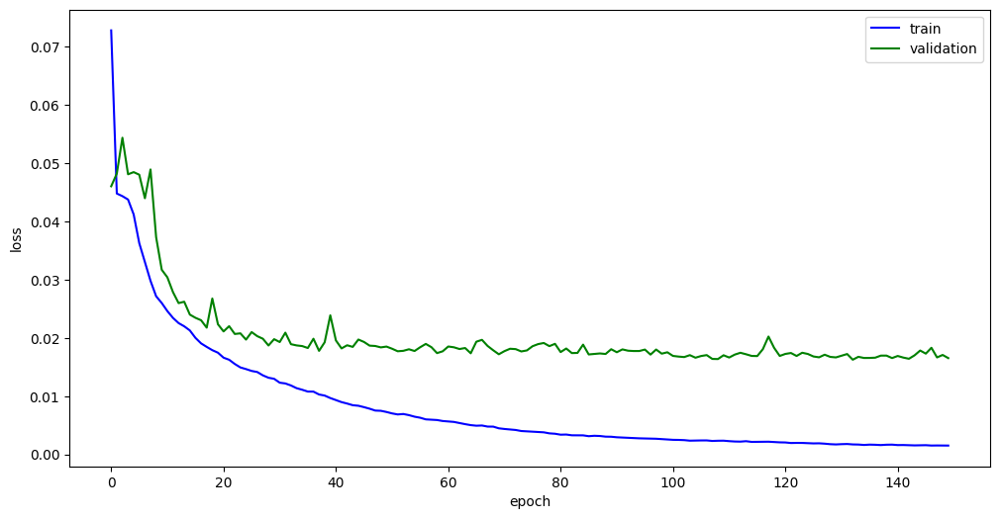

In [ ]:
!pip install mat73
import mat73
import cv2 as cvlib
import librosa
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy import signal
from google.colab import drive
drive.mount('/content/gdrive')
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder

EIT_98_dict=mat73.loadmat('/content/gdrive/MyDrive/ARKA/EIT_work/TbCS/15_sec_data/EITs_tbcs_15sec.mat')
EIT_98_sigs=EIT_98_dict['EITs_tbcs_15sec']

import pickle
def load_pickle_file(name_of_file):
    infile = open(name_of_file,'rb')
    wgt = pickle.load(infile)
    infile.close()
    return wgt

Melspecs= load_pickle_file('/content/gdrive/MyDrive/ARKA/EIT_work/TbCS/15_sec_data/Melspecs_tbcs_15sec')
Melspecs_re=np.expand_dims(Melspecs, axis=-1)
EITs_re = np.expand_dims(EIT_98_sigs.T, axis=-1)

print('shape of melspectrogram dataset'+str(np.shape(Melspecs_re)))
print('shape of EIT dataset'+str(np.shape(EITs_re)))

seed=10
X_train1, X_test, Y_train1,Y_test = train_test_split(Melspecs_re,EITs_re, test_size=0.1,random_state=seed)
X_train, X_valid,Y_train, Y_valid = train_test_split(X_train1,Y_train1,test_size=0.1,random_state=seed)


import tensorflow as tf
from tensorflow.keras.layers import Layer, Conv2D, BatchNormalization, Activation, GlobalAveragePooling2D, Dense, Reshape, Multiply,MaxPooling2D,MultiHeadAttention, LayerNormalization, Dropout, Flatten, Add, Input,GlobalAveragePooling1D, LSTM, Reshape
from tensorflow.keras.models import Model

class ResidualShrinkage(Layer):
    def __init__(self, filters, **kwargs):
        super(ResidualShrinkage, self).__init__(**kwargs)
        self.filters = filters

    def build(self, input_shape):
        self.global_avg_pool = GlobalAveragePooling2D()
        self.dense_1 = Dense(self.filters // 4, activation='relu')
        self.dense_2 = Dense(self.filters, activation='sigmoid')
        super(ResidualShrinkage, self).build(input_shape)

    def call(self, inputs):
        # Global average pooling
        x = self.global_avg_pool(inputs)

        # Fully connected layers for learning thresholds
        x = self.dense_1(x)
        scales = self.dense_2(x)

        # Reshape to match input dimensions
        scales = Reshape((1, 1, self.filters))(scales)

        # Apply soft thresholding
        residual = inputs - tf.sign(inputs) * tf.maximum(tf.abs(inputs) - scales, 0)
        return residual

def residual_shrinkage_block(inputs, filters, kernel_size=3, strides=1):
    x = Conv2D(filters, kernel_size, strides=strides, padding='same')(inputs)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    x = Conv2D(filters, kernel_size, strides=1, padding='same')(x)
    x = BatchNormalization()(x)

    if strides > 1 or inputs.shape[-1] != filters:
        inputs = Conv2D(filters, kernel_size=1, strides=strides, padding='same')(inputs)

    x = ResidualShrinkage(filters)(x)

    x = tf.keras.layers.add([x, inputs])
    x = Activation('relu')(x)

    return x

class TransformerBlock(Layer):
    def __init__(self, embed_dim, num_heads, ff_dim, rate=0.1):
        super(TransformerBlock, self).__init__()
        self.att = MultiHeadAttention(num_heads=num_heads, key_dim=embed_dim)
        self.ffn = tf.keras.Sequential(
            [Dense(ff_dim, activation="relu"), Dense(embed_dim),]
        )
        self.layernorm1 = LayerNormalization(epsilon=1e-6)
        self.layernorm2 = LayerNormalization(epsilon=1e-6)
        self.dropout1 = Dropout(rate)
        self.dropout2 = Dropout(rate)

    def call(self, inputs, training):
        attn_output = self.att(inputs, inputs)
        attn_output = self.dropout1(attn_output, training=training)
        out1 = self.layernorm1(inputs + attn_output)
        ffn_output = self.ffn(out1)
        ffn_output = self.dropout2(ffn_output, training=training)
        return self.layernorm2(out1 + ffn_output)

def build_model(input_shape):
    inputs = tf.keras.Input(shape=input_shape)
    x = Conv2D(16, kernel_size=3, strides=1)(inputs)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)
    x = MaxPooling2D((2, 2))(x)

    x = Conv2D(32, kernel_size=3, strides=1)(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    x = Conv2D(64, kernel_size=3, strides=1, padding='same')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)
    x = MaxPooling2D((2, 2))(x)

    x = residual_shrinkage_block(x, 64)
    x = MaxPooling2D((2, 2))(x)
    # Reshape the output to (batch_size, num_patches, embed_dim)
    x = Reshape((x.shape[1] * x.shape[2], x.shape[3]))(x)

    # Transformer Block
    x = TransformerBlock(embed_dim=64, num_heads=4, ff_dim=128)(x)

    x = LSTM(64, return_sequences=True)(x)
    x = LSTM(64)(x)

    outputs = Dense(EITs_re.shape[1])(x)
    outputs = Reshape((EITs_re.shape[1], 1))(outputs)
    model = Model(inputs, outputs)
    return model

EIT_model_tbcs_15sec= build_model((Melspecs_re.shape[1], Melspecs_re.shape[2], 1))
EIT_model_tbcs_15sec.compile(optimizer='adam', loss='mse')
EIT_model_tbcs_15sec.summary()

history = EIT_model_tbcs_15sec.fit(
    X_train, Y_train,
    epochs=150,
    batch_size=32,
    validation_data=(X_valid, Y_valid )
)

plt.figure(figsize=(12,6))
plt.plot(history.history['loss'],'b')
plt.plot(history.history['val_loss'],'g')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'validation',], loc='best')
plt.show()

In [ ]:
new_loc='/content/gdrive/MyDrive/ARKA/EIT_work/TbCS/15_sec_data'
# save the plot varriables
filepath_tloss=new_loc+'/train_loss_5sec_tbdb.txt'; np.savetxt(filepath_tloss,history.history['loss'])
filepath_vloss=new_loc+'/val_loss_5sec_tbdb.txt'; np.savetxt(filepath_vloss,history.history['val_loss'])

# Save the model architecture to a JSON file
model_json = EIT_model_tbdb_15sec.to_json()
with open("/content/gdrive/MyDrive/ARKA/EIT_work/TbCS/15_sec_data/EIT_model_tbcs_15sec.json", "w") as json_file:
    json_file.write(model_json)

# Save the model weights to an HDF5 file
EIT_model_tbdb_15sec.save_weights("/content/gdrive/MyDrive/ARKA/EIT_work/TbCS/15_sec_data/EIT_model_tbcs_15sec_weights.h5")


## **5-sec**

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).
shape of melspectrogram dataset(5208, 64, 39, 1)
shape of EIT dataset(5208, 165, 1)
Model: "model_5"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_6 (InputLayer)        [(None, 64, 39, 1)]          0         []                            
                                                                                                  
 conv2d_25 (Conv2D)          (None, 62, 37, 16)           160       ['input_6[0][0]']             
                                                                                                  
 batch_normalization_25 (Ba  (None, 62, 37, 16)           64        ['conv2d_25[0][0]']           
 tchNormalization)                                                         

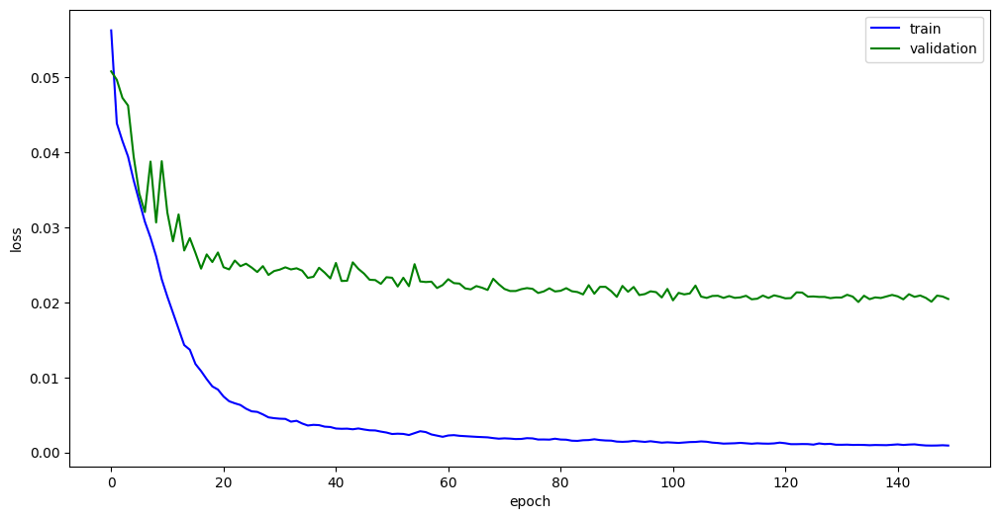

In [ ]:
!pip install mat73
import mat73
import cv2 as cvlib
import librosa
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy import signal
from google.colab import drive
drive.mount('/content/gdrive')
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder

EIT_98_dict=mat73.loadmat('/content/gdrive/MyDrive/ARKA/EIT_work/TbCS/5_sec_data/EITs_tbcs_5sec.mat')
EIT_98_sigs=EIT_98_dict['EITs_tbcs_5sec']

import pickle
def load_pickle_file(name_of_file):
    infile = open(name_of_file,'rb')
    wgt = pickle.load(infile)
    infile.close()
    return wgt

Melspecs= load_pickle_file('/content/gdrive/MyDrive/ARKA/EIT_work/TbCS/5_sec_data/Melspecs_tbcs_5sec')
Melspecs_re=np.expand_dims(Melspecs, axis=-1)
EITs_re = np.expand_dims(EIT_98_sigs.T, axis=-1)

print('shape of melspectrogram dataset'+str(np.shape(Melspecs_re)))
print('shape of EIT dataset'+str(np.shape(EITs_re)))

seed=10
X_train1, X_test, Y_train1,Y_test = train_test_split(Melspecs_re,EITs_re, test_size=0.1,random_state=seed)
X_train, X_valid,Y_train, Y_valid = train_test_split(X_train1,Y_train1,test_size=0.1,random_state=seed)


import tensorflow as tf
from tensorflow.keras.layers import Layer, Conv2D, BatchNormalization, Activation, GlobalAveragePooling2D, Dense, Reshape, Multiply,MaxPooling2D,MultiHeadAttention, LayerNormalization, Dropout, Flatten, Add, Input,GlobalAveragePooling1D, LSTM, Reshape
from tensorflow.keras.models import Model

class ResidualShrinkage(Layer):
    def __init__(self, filters, **kwargs):
        super(ResidualShrinkage, self).__init__(**kwargs)
        self.filters = filters

    def build(self, input_shape):
        self.global_avg_pool = GlobalAveragePooling2D()
        self.dense_1 = Dense(self.filters // 4, activation='relu')
        self.dense_2 = Dense(self.filters, activation='sigmoid')
        super(ResidualShrinkage, self).build(input_shape)

    def call(self, inputs):
        # Global average pooling
        x = self.global_avg_pool(inputs)

        # Fully connected layers for learning thresholds
        x = self.dense_1(x)
        scales = self.dense_2(x)

        # Reshape to match input dimensions
        scales = Reshape((1, 1, self.filters))(scales)

        # Apply soft thresholding
        residual = inputs - tf.sign(inputs) * tf.maximum(tf.abs(inputs) - scales, 0)
        return residual

def residual_shrinkage_block(inputs, filters, kernel_size=3, strides=1):
    x = Conv2D(filters, kernel_size, strides=strides, padding='same')(inputs)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    x = Conv2D(filters, kernel_size, strides=1, padding='same')(x)
    x = BatchNormalization()(x)

    if strides > 1 or inputs.shape[-1] != filters:
        inputs = Conv2D(filters, kernel_size=1, strides=strides, padding='same')(inputs)

    x = ResidualShrinkage(filters)(x)

    x = tf.keras.layers.add([x, inputs])
    x = Activation('relu')(x)

    return x

class TransformerBlock(Layer):
    def __init__(self, embed_dim, num_heads, ff_dim, rate=0.1):
        super(TransformerBlock, self).__init__()
        self.att = MultiHeadAttention(num_heads=num_heads, key_dim=embed_dim)
        self.ffn = tf.keras.Sequential(
            [Dense(ff_dim, activation="relu"), Dense(embed_dim),]
        )
        self.layernorm1 = LayerNormalization(epsilon=1e-6)
        self.layernorm2 = LayerNormalization(epsilon=1e-6)
        self.dropout1 = Dropout(rate)
        self.dropout2 = Dropout(rate)

    def call(self, inputs, training):
        attn_output = self.att(inputs, inputs)
        attn_output = self.dropout1(attn_output, training=training)
        out1 = self.layernorm1(inputs + attn_output)
        ffn_output = self.ffn(out1)
        ffn_output = self.dropout2(ffn_output, training=training)
        return self.layernorm2(out1 + ffn_output)

def build_model(input_shape):
    inputs = tf.keras.Input(shape=input_shape)
    x = Conv2D(16, kernel_size=3, strides=1)(inputs)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)
    x = MaxPooling2D((2, 2))(x)

    x = Conv2D(32, kernel_size=3, strides=1)(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    x = Conv2D(64, kernel_size=3, strides=1, padding='same')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)
    x = MaxPooling2D((2, 2))(x)

    x = residual_shrinkage_block(x, 64)
    x = MaxPooling2D((2, 2))(x)
    # Reshape the output to (batch_size, num_patches, embed_dim)
    x = Reshape((x.shape[1] * x.shape[2], x.shape[3]))(x)

    # Transformer Block
    x = TransformerBlock(embed_dim=64, num_heads=4, ff_dim=128)(x)

    x = LSTM(64, return_sequences=True)(x)
    x = LSTM(64)(x)

    outputs = Dense(EITs_re.shape[1])(x)
    outputs = Reshape((EITs_re.shape[1], 1))(outputs)
    model = Model(inputs, outputs)
    return model

EIT_model_tbcs_5sec= build_model((Melspecs_re.shape[1], Melspecs_re.shape[2], 1))
EIT_model_tbcs_5sec.compile(optimizer='adam', loss='mse')
EIT_model_tbcs_5sec.summary()

history = EIT_model_tbcs_5sec.fit(
    X_train, Y_train,
    epochs=150,
    batch_size=32,
    validation_data=(X_valid, Y_valid )
)

plt.figure(figsize=(12,6))
plt.plot(history.history['loss'],'b')
plt.plot(history.history['val_loss'],'g')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'validation',], loc='best')
plt.show()

In [ ]:
new_loc='/content/gdrive/MyDrive/ARKA/EIT_work/TbCS/5_sec_data'
# save the plot varriables
filepath_tloss=new_loc+'/train_loss_5sec_tbdb.txt'; np.savetxt(filepath_tloss,history.history['loss'])
filepath_vloss=new_loc+'/val_loss_5sec_tbdb.txt'; np.savetxt(filepath_vloss,history.history['val_loss'])

# Save the model architecture to a JSON file
model_json = EIT_model_tbdb_5sec.to_json()
with open("/content/gdrive/MyDrive/ARKA/EIT_work/TbCS/5_sec_data/EIT_model_tbcs_5sec.json", "w") as json_file:
    json_file.write(model_json)

# Save the model weights to an HDF5 file
EIT_model_tbdb_5sec.save_weights("/content/gdrive/MyDrive/ARKA/EIT_work/TbCS/5_sec_data/EIT_model_tbcs_5sec_weights.h5")


# **Training with combined data: TbDb + TbCS**

## **10 sec**

In [ ]:
!pip install mat73
import mat73
import cv2 as cvlib
import librosa
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy import signal
from google.colab import drive
drive.mount('/content/gdrive')
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [ ]:
import pickle
def load_pickle_file(name_of_file):
    infile = open(name_of_file,'rb')
    wgt = pickle.load(infile)
    infile.close()
    return wgt

EIT_tbdb_dict=mat73.loadmat('/content/gdrive/MyDrive/ARKA/EIT_work/TbDb/EIT_98d5ov_TbDb.mat')
EIT_tbdb_sigs=EIT_tbdb_dict['EITs_98d5ov']
Melspecs_tbdb= load_pickle_file('/content/gdrive/MyDrive/ARKA/EIT_work/TbDb/Melspecs_TbDb')

EIT_tbcs_dict=mat73.loadmat('/content/gdrive/MyDrive/ARKA/EIT_work/TbCS/EIT_tbcs.mat')
EIT_tbcs_sigs=EIT_tbcs_dict['EITs_tbcs']
Melspecs_tbcs= load_pickle_file('/content/gdrive/MyDrive/ARKA/EIT_work/TbCS/Melspecs_tbcs')


Melspec_tbdb_tbcs=np.concatenate((Melspecs_tbdb,Melspecs_tbcs),axis=0)
EIT_tbdb_tbcs_sigs=np.concatenate((EIT_tbdb_sigs,EIT_tbcs_sigs),axis=1)

Melspecs_re=np.expand_dims(Melspec_tbdb_tbcs, axis=-1)
EITs_re = np.expand_dims(EIT_tbdb_tbcs_sigs.T, axis=-1)

tbdb_labels=[]
for i in range (12904):
    tbdb_labels.append('TbDb')

tbcs_labels=[]
for i in range (12900):
    tbcs_labels.append('TbCS')

labels=tbdb_labels+tbcs_labels
labels=np.array(labels)

print('shape of melspectrogram TbCS+TbDb dataset'+str(np.shape(Melspecs_re)))
print('shape of EIT TbCS+TbDb dataset'+str(np.shape(EITs_re)))
print('shape of labels TbCS+TbDb dataset'+str(np.shape(labels)))

shape of melspectrogram TbCS+TbDb dataset(25804, 64, 77, 1)
shape of EIT TbCS+TbDb dataset(25804, 330, 1)
shape of labels TbCS+TbDb dataset(25804,)


In [ ]:
seed=10
X_train1, X_test, Y_train1,Y_test,l_train1,l_test = train_test_split(Melspecs_re,EITs_re,labels, test_size=0.1,random_state=seed)
X_train, X_valid,Y_train, Y_valid,l_train,l_valid = train_test_split(X_train1,Y_train1,l_train1,test_size=0.1,random_state=seed)

In [ ]:
import tensorflow as tf
from tensorflow.keras.layers import Layer, Conv2D, BatchNormalization, Activation, GlobalAveragePooling2D, Dense, Reshape, Multiply,MaxPooling2D,MultiHeadAttention, LayerNormalization, Dropout, Flatten, Add, Input,GlobalAveragePooling1D, LSTM, Reshape
from tensorflow.keras.models import Model

class ResidualShrinkage(Layer):
    def __init__(self, filters, **kwargs):
        super(ResidualShrinkage, self).__init__(**kwargs)
        self.filters = filters

    def build(self, input_shape):
        self.global_avg_pool = GlobalAveragePooling2D()
        self.dense_1 = Dense(self.filters // 4, activation='relu')
        self.dense_2 = Dense(self.filters, activation='sigmoid')
        super(ResidualShrinkage, self).build(input_shape)

    def call(self, inputs):
        # Global average pooling
        x = self.global_avg_pool(inputs)

        # Fully connected layers for learning thresholds
        x = self.dense_1(x)
        scales = self.dense_2(x)

        # Reshape to match input dimensions
        scales = Reshape((1, 1, self.filters))(scales)

        # Apply soft thresholding
        residual = inputs - tf.sign(inputs) * tf.maximum(tf.abs(inputs) - scales, 0)
        return residual

def residual_shrinkage_block(inputs, filters, kernel_size=3, strides=1):
    x = Conv2D(filters, kernel_size, strides=strides, padding='same')(inputs)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    x = Conv2D(filters, kernel_size, strides=1, padding='same')(x)
    x = BatchNormalization()(x)

    if strides > 1 or inputs.shape[-1] != filters:
        inputs = Conv2D(filters, kernel_size=1, strides=strides, padding='same')(inputs)

    x = ResidualShrinkage(filters)(x)

    x = tf.keras.layers.add([x, inputs])
    x = Activation('relu')(x)

    return x

class TransformerBlock(Layer):
    def __init__(self, embed_dim, num_heads, ff_dim, rate=0.1):
        super(TransformerBlock, self).__init__()
        self.att = MultiHeadAttention(num_heads=num_heads, key_dim=embed_dim)
        self.ffn = tf.keras.Sequential(
            [Dense(ff_dim, activation="relu"), Dense(embed_dim),]
        )
        self.layernorm1 = LayerNormalization(epsilon=1e-6)
        self.layernorm2 = LayerNormalization(epsilon=1e-6)
        self.dropout1 = Dropout(rate)
        self.dropout2 = Dropout(rate)

    def call(self, inputs, training):
        attn_output = self.att(inputs, inputs)
        attn_output = self.dropout1(attn_output, training=training)
        out1 = self.layernorm1(inputs + attn_output)
        ffn_output = self.ffn(out1)
        ffn_output = self.dropout2(ffn_output, training=training)
        return self.layernorm2(out1 + ffn_output)

def build_model(input_shape):
    inputs = tf.keras.Input(shape=input_shape)
    x = Conv2D(16, kernel_size=3, strides=1)(inputs)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)
    x = MaxPooling2D((2, 2))(x)

    x = Conv2D(32, kernel_size=3, strides=1)(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    x = Conv2D(64, kernel_size=3, strides=1, padding='same')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)
    x = MaxPooling2D((2, 2))(x)

    x = residual_shrinkage_block(x, 64)
    x = MaxPooling2D((2, 2))(x)
    # Reshape the output to (batch_size, num_patches, embed_dim)
    x = Reshape((x.shape[1] * x.shape[2], x.shape[3]))(x)

    # Transformer Block
    x = TransformerBlock(embed_dim=64, num_heads=4, ff_dim=128)(x)

    x = LSTM(64, return_sequences=True)(x)
    x = LSTM(64)(x)

    outputs = Dense(330)(x)
    outputs = Reshape((330, 1))(outputs)
    model = Model(inputs, outputs)
    return model

EIT_model_tbdb_tbcs= build_model((64, 77, 1))
EIT_model_tbdb_tbcs.compile(optimizer='adam', loss='mse')

history = EIT_model_tbdb_tbcs.fit(
    X_train, Y_train,
    epochs=150,
    batch_size=32,
    validation_data=(X_valid, Y_valid )
)

Epoch 1/150
654/654 [==============================] - 41s 37ms/step - loss: 0.0612 - val_loss: 0.0486
Epoch 2/150
654/654 [==============================] - 27s 41ms/step - loss: 0.0390 - val_loss: 0.0325
Epoch 3/150
654/654 [==============================] - 17s 26ms/step - loss: 0.0296 - val_loss: 0.0277
Epoch 4/150
654/654 [==============================] - 20s 30ms/step - loss: 0.0231 - val_loss: 0.0231
Epoch 5/150
654/654 [==============================] - 21s 32ms/step - loss: 0.0187 - val_loss: 0.0192
Epoch 6/150
654/654 [==============================] - 19s 29ms/step - loss: 0.0160 - val_loss: 0.0178
Epoch 7/150
654/654 [==============================] - 19s 28ms/step - loss: 0.0137 - val_loss: 0.0145
Epoch 8/150
654/654 [==============================] - 17s 26ms/step - loss: 0.0120 - val_loss: 0.0167
Epoch 9/150
654/654 [==============================] - 17s 26ms/step - loss: 0.0109 - val_loss: 0.0160
Epoch 10/150
654/654 [==============================] - 19s 30ms/step - l

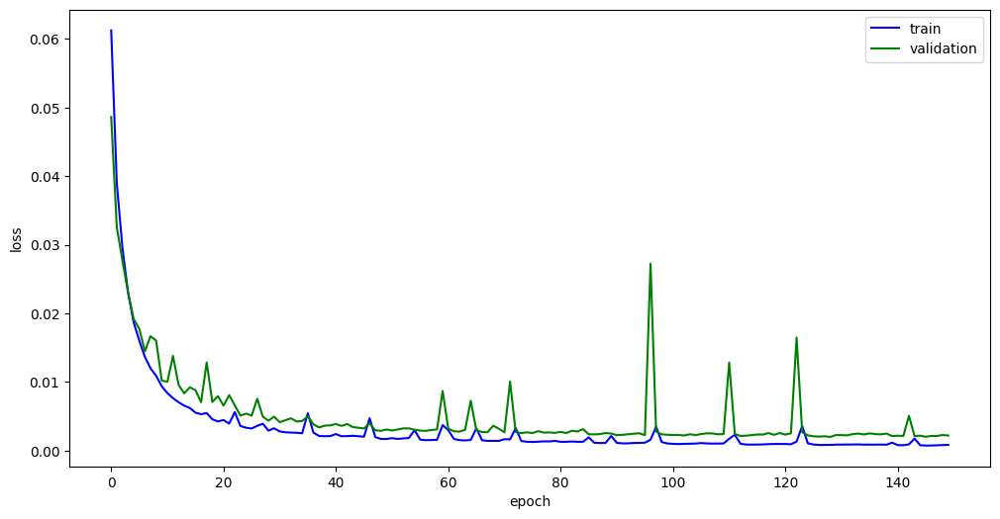

In [ ]:
plt.figure(figsize=(12,6))
plt.plot(history.history['loss'],'b')
plt.plot(history.history['val_loss'],'g')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'validation',], loc='best')
plt.show()

In [ ]:
predictions = EIT_model_tbdb_tbcs.predict(X_test)
# Print the outputs
print("Output Shape:", predictions.shape)

81/81 [==============================] - 2s 9ms/step
Output Shape: (2581, 330, 1)


In [ ]:
import matplotlib.pyplot as plt

# Plot actual and decoded EIT
for i in range (predictions.shape[0]):
    plt.figure(figsize=(10, 5))
    plt.subplot(121)
    plt.plot(Y_test[i])
    plt.title("Actual EIT")
    plt.subplot(122)
    plt.plot(predictions[i])
    plt.title("Predicted EIT")
    plt.suptitle(l_test[i], fontsize=16)  # Add a title to the subplot
    plt.show()

In [ ]:
# Save the model architecture to a JSON file
model_json = EIT_model_tbdb_tbcs.to_json()
with open("/content/gdrive/MyDrive/ARKA/EIT_work/Results/shrinkcnn_transformer_lstm/TbDb_TbCS/Model/EIT_model_tbdb_tbcs.json", "w") as json_file:
    json_file.write(model_json)

# Save the model weights to an HDF5 file
EIT_model_tbdb_tbcs.save_weights("/content/gdrive/MyDrive/ARKA/EIT_work/Results/shrinkcnn_transformer_lstm/TbDb_TbCS/Model/EIT_model_weights_tbdb_tbcs.h5")

In [ ]:
import matplotlib.pyplot as plt

filenames = []

for i in range(predictions.shape[0]):
    plt.figure(figsize=(10, 5))

    plt.subplot(121)
    plt.plot(Y_test[i])
    plt.title("Actual EIT")

    plt.subplot(122)
    plt.plot(predictions[i])
    plt.title("Predicted EIT")

    plt.suptitle(l_test[i], fontsize=16)

    filename = f'figure_{i}.png'
    plt.savefig(filename)
    plt.close()
    filenames.append(filename)

!pip install imageio
import imageio

# Create a GIF from the saved PNG images
with imageio.get_writer('/content/gdrive/MyDrive/ARKA/EIT_work/Results/shrinkcnn_transformer_lstm/TbDb_TbCS/Predicted_images/output.gif', mode='I', duration=0.5) as writer:
    for filename in filenames:
        image = imageio.imread(filename)
        writer.append_data(image)

# Optionally, clean up the PNG files after creating the GIF
import os
for filename in filenames:
    os.remove(filename)

In [ ]:
# Create a GIF from the saved PNG images
with imageio.get_writer('/content/gdrive/MyDrive/ARKA/EIT_work/Results/shrinkcnn_transformer_lstm/TbDb_TbCS/Predicted_images/output.gif', mode='I', duration=0.5) as writer:
    for filename in filenames:
        image = imageio.imread(filename)
        writer.append_data(image)

# Optionally, clean up the PNG files after creating the GIF
import os
for filename in filenames:
    os.remove(filename)

<ipython-input-10-906002d27f67>:4: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)
<ipython-input-10-906002d27f67>:4: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)
<ipython-input-10-906002d27f67>:4: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)
<ipython-input-10-906002d27f67>:4: Deprecat

## **15 sec**

shape of melspectrogram TbCS+TbDb dataset(6841, 64, 115, 1)
shape of EIT TbCS+TbDb dataset(6841, 495, 1)
shape of labels TbCS+TbDb dataset(6841,)
Model: "model_8"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_9 (InputLayer)        [(None, 64, 115, 1)]         0         []                            
                                                                                                  
 conv2d_40 (Conv2D)          (None, 62, 113, 16)          160       ['input_9[0][0]']             
                                                                                                  
 batch_normalization_40 (Ba  (None, 62, 113, 16)          64        ['conv2d_40[0][0]']           
 tchNormalization)                                                                                
                                             

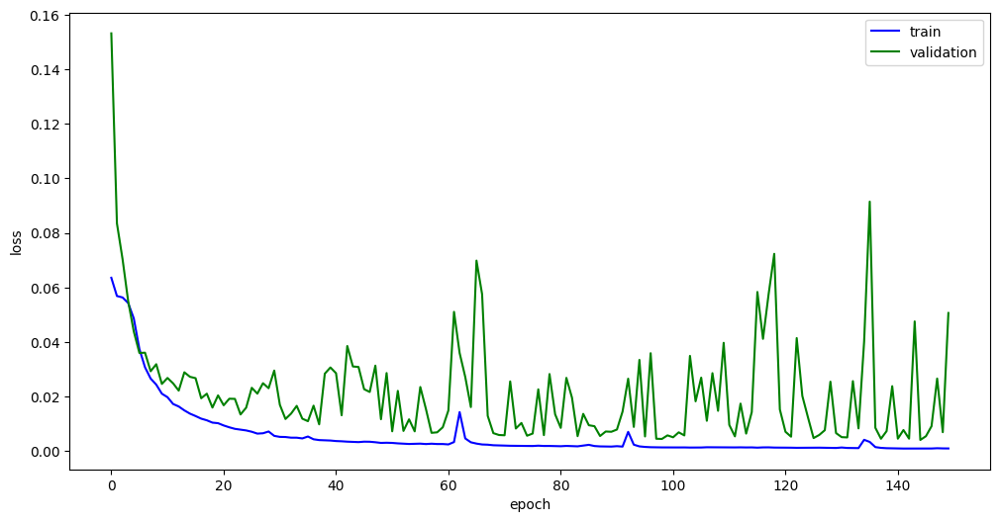

In [ ]:
import pickle
def load_pickle_file(name_of_file):
    infile = open(name_of_file,'rb')
    wgt = pickle.load(infile)
    infile.close()
    return wgt

EIT_tbdb_dict=mat73.loadmat('/content/gdrive/MyDrive/ARKA/EIT_work/TbDb/15_sec_data/EITs_TbDb_15sec.mat')
EIT_tbdb_sigs=EIT_tbdb_dict['EITs_TbDb_15sec']
Melspecs_tbdb= load_pickle_file('/content/gdrive/MyDrive/ARKA/EIT_work/TbDb/15_sec_data/Melspecs_TbDb_15sec')

EIT_tbcs_dict=mat73.loadmat('/content/gdrive/MyDrive/ARKA/EIT_work/TbCS/15_sec_data/EITs_tbcs_15sec.mat')
EIT_tbcs_sigs=EIT_tbcs_dict['EITs_tbcs_15sec']
Melspecs_tbcs= load_pickle_file('/content/gdrive/MyDrive/ARKA/EIT_work/TbCS/15_sec_data/Melspecs_tbcs_15sec')


Melspec_tbdb_tbcs=np.concatenate((Melspecs_tbdb,Melspecs_tbcs),axis=0)
EIT_tbdb_tbcs_sigs=np.concatenate((EIT_tbdb_sigs,EIT_tbcs_sigs),axis=1)

Melspecs_re=np.expand_dims(Melspec_tbdb_tbcs, axis=-1)
EITs_re = np.expand_dims(EIT_tbdb_tbcs_sigs.T, axis=-1)

tbdb_labels=[]
for i in range (Melspecs_tbdb.shape[0]):
    tbdb_labels.append('TbDb')

tbcs_labels=[]
for i in range (Melspecs_tbcs.shape[0]):
    tbcs_labels.append('TbCS')

labels=tbdb_labels+tbcs_labels
labels=np.array(labels)

print('shape of melspectrogram TbCS+TbDb dataset'+str(np.shape(Melspecs_re)))
print('shape of EIT TbCS+TbDb dataset'+str(np.shape(EITs_re)))
print('shape of labels TbCS+TbDb dataset'+str(np.shape(labels)))

seed=10
X_train1, X_test, Y_train1,Y_test = train_test_split(Melspecs_re,EITs_re, test_size=0.1,random_state=seed)
X_train, X_valid,Y_train, Y_valid = train_test_split(X_train1,Y_train1,test_size=0.1,random_state=seed)


import tensorflow as tf
from tensorflow.keras.layers import Layer, Conv2D, BatchNormalization, Activation, GlobalAveragePooling2D, Dense, Reshape, Multiply,MaxPooling2D,MultiHeadAttention, LayerNormalization, Dropout, Flatten, Add, Input,GlobalAveragePooling1D, LSTM, Reshape
from tensorflow.keras.models import Model

class ResidualShrinkage(Layer):
    def __init__(self, filters, **kwargs):
        super(ResidualShrinkage, self).__init__(**kwargs)
        self.filters = filters

    def build(self, input_shape):
        self.global_avg_pool = GlobalAveragePooling2D()
        self.dense_1 = Dense(self.filters // 4, activation='relu')
        self.dense_2 = Dense(self.filters, activation='sigmoid')
        super(ResidualShrinkage, self).build(input_shape)

    def call(self, inputs):
        # Global average pooling
        x = self.global_avg_pool(inputs)

        # Fully connected layers for learning thresholds
        x = self.dense_1(x)
        scales = self.dense_2(x)

        # Reshape to match input dimensions
        scales = Reshape((1, 1, self.filters))(scales)

        # Apply soft thresholding
        residual = inputs - tf.sign(inputs) * tf.maximum(tf.abs(inputs) - scales, 0)
        return residual

def residual_shrinkage_block(inputs, filters, kernel_size=3, strides=1):
    x = Conv2D(filters, kernel_size, strides=strides, padding='same')(inputs)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    x = Conv2D(filters, kernel_size, strides=1, padding='same')(x)
    x = BatchNormalization()(x)

    if strides > 1 or inputs.shape[-1] != filters:
        inputs = Conv2D(filters, kernel_size=1, strides=strides, padding='same')(inputs)

    x = ResidualShrinkage(filters)(x)

    x = tf.keras.layers.add([x, inputs])
    x = Activation('relu')(x)

    return x

class TransformerBlock(Layer):
    def __init__(self, embed_dim, num_heads, ff_dim, rate=0.1):
        super(TransformerBlock, self).__init__()
        self.att = MultiHeadAttention(num_heads=num_heads, key_dim=embed_dim)
        self.ffn = tf.keras.Sequential(
            [Dense(ff_dim, activation="relu"), Dense(embed_dim),]
        )
        self.layernorm1 = LayerNormalization(epsilon=1e-6)
        self.layernorm2 = LayerNormalization(epsilon=1e-6)
        self.dropout1 = Dropout(rate)
        self.dropout2 = Dropout(rate)

    def call(self, inputs, training):
        attn_output = self.att(inputs, inputs)
        attn_output = self.dropout1(attn_output, training=training)
        out1 = self.layernorm1(inputs + attn_output)
        ffn_output = self.ffn(out1)
        ffn_output = self.dropout2(ffn_output, training=training)
        return self.layernorm2(out1 + ffn_output)

def build_model(input_shape):
    inputs = tf.keras.Input(shape=input_shape)
    x = Conv2D(16, kernel_size=3, strides=1)(inputs)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)
    x = MaxPooling2D((2, 2))(x)

    x = Conv2D(32, kernel_size=3, strides=1)(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    x = Conv2D(64, kernel_size=3, strides=1, padding='same')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)
    x = MaxPooling2D((2, 2))(x)

    x = residual_shrinkage_block(x, 64)
    x = MaxPooling2D((2, 2))(x)
    # Reshape the output to (batch_size, num_patches, embed_dim)
    x = Reshape((x.shape[1] * x.shape[2], x.shape[3]))(x)

    # Transformer Block
    x = TransformerBlock(embed_dim=64, num_heads=4, ff_dim=128)(x)

    x = LSTM(64, return_sequences=True)(x)
    x = LSTM(64)(x)

    outputs = Dense(EITs_re.shape[1])(x)
    outputs = Reshape((EITs_re.shape[1], 1))(outputs)
    model = Model(inputs, outputs)
    return model

EIT_model_tbdb_tbcs_15sec= build_model((Melspecs_re.shape[1], Melspecs_re.shape[2], 1))
EIT_model_tbdb_tbcs_15sec.compile(optimizer='adam', loss='mse')
EIT_model_tbdb_tbcs_15sec.summary()

history = EIT_model_tbdb_tbcs_15sec.fit(
    X_train, Y_train,
    epochs=150,
    batch_size=32,
    validation_data=(X_valid, Y_valid )
)

plt.figure(figsize=(12,6))
plt.plot(history.history['loss'],'b')
plt.plot(history.history['val_loss'],'g')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'validation',], loc='best')
plt.show()

In [ ]:
new_loc='/content/gdrive/MyDrive/ARKA/EIT_work/TbDb_TbCS_results/15_sec'
# save the plot varriables
filepath_tloss=new_loc+'/train_loss_15sec_tbdb_tbcs.txt'; np.savetxt(filepath_tloss,history.history['loss'])
filepath_vloss=new_loc+'/val_loss_15sec_tbdb_tbcs.txt'; np.savetxt(filepath_vloss,history.history['val_loss'])

# Save the model architecture to a JSON file
model_json = EIT_model_tbdb_tbcs_15sec.to_json()
with open("/content/gdrive/MyDrive/ARKA/EIT_work/TbDb_TbCS_results/15_sec/EIT_model_tbdb_tbcs_15sec.json", "w") as json_file:
    json_file.write(model_json)

# Save the model weights to an HDF5 file
EIT_model_tbdb_tbcs_15sec.save_weights("/content/gdrive/MyDrive/ARKA/EIT_work/TbDb_TbCS_results/15_sec/EIT_model_tbdb_tbcs_15sec_weights.h5")


## **5 sec**

shape of melspectrogram TbCS+TbDb dataset(10416, 64, 39, 1)
shape of EIT TbCS+TbDb dataset(10416, 165, 1)
shape of labels TbCS+TbDb dataset(10416,)
Model: "model_9"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_10 (InputLayer)       [(None, 64, 39, 1)]          0         []                            
                                                                                                  
 conv2d_45 (Conv2D)          (None, 62, 37, 16)           160       ['input_10[0][0]']            
                                                                                                  
 batch_normalization_45 (Ba  (None, 62, 37, 16)           64        ['conv2d_45[0][0]']           
 tchNormalization)                                                                                
                                           

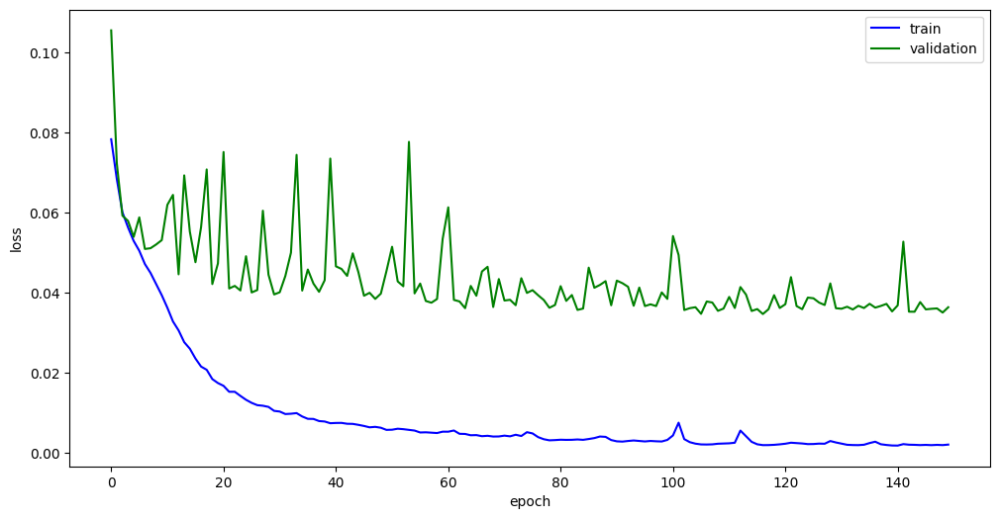

In [ ]:
import pickle
def load_pickle_file(name_of_file):
    infile = open(name_of_file,'rb')
    wgt = pickle.load(infile)
    infile.close()
    return wgt

EIT_tbdb_dict=mat73.loadmat('/content/gdrive/MyDrive/ARKA/EIT_work/TbDb/5_sec_data/EITs_TbDb_5sec.mat')
EIT_tbdb_sigs=EIT_tbdb_dict['EITs_TbDb_5sec']
Melspecs_tbdb= load_pickle_file('/content/gdrive/MyDrive/ARKA/EIT_work/TbDb/5_sec_data/Melspecs_TbDb_5sec')

EIT_tbcs_dict=mat73.loadmat('/content/gdrive/MyDrive/ARKA/EIT_work/TbCS/5_sec_data/EITs_tbcs_5sec.mat')
EIT_tbcs_sigs=EIT_tbcs_dict['EITs_tbcs_5sec']
Melspecs_tbcs= load_pickle_file('/content/gdrive/MyDrive/ARKA/EIT_work/TbCS/5_sec_data/Melspecs_tbcs_5sec')


Melspec_tbdb_tbcs=np.concatenate((Melspecs_tbdb,Melspecs_tbcs),axis=0)
EIT_tbdb_tbcs_sigs=np.concatenate((EIT_tbdb_sigs,EIT_tbcs_sigs),axis=1)

Melspecs_re=np.expand_dims(Melspec_tbdb_tbcs, axis=-1)
EITs_re = np.expand_dims(EIT_tbdb_tbcs_sigs.T, axis=-1)

tbdb_labels=[]
for i in range (Melspecs_tbdb.shape[0]):
    tbdb_labels.append('TbDb')

tbcs_labels=[]
for i in range (Melspecs_tbcs.shape[0]):
    tbcs_labels.append('TbCS')

labels=tbdb_labels+tbcs_labels
labels=np.array(labels)

print('shape of melspectrogram TbCS+TbDb dataset'+str(np.shape(Melspecs_re)))
print('shape of EIT TbCS+TbDb dataset'+str(np.shape(EITs_re)))
print('shape of labels TbCS+TbDb dataset'+str(np.shape(labels)))

seed=10
X_train1, X_test, Y_train1,Y_test = train_test_split(Melspecs_re,EITs_re, test_size=0.1,random_state=seed)
X_train, X_valid,Y_train, Y_valid = train_test_split(X_train1,Y_train1,test_size=0.1,random_state=seed)


import tensorflow as tf
from tensorflow.keras.layers import Layer, Conv2D, BatchNormalization, Activation, GlobalAveragePooling2D, Dense, Reshape, Multiply,MaxPooling2D,MultiHeadAttention, LayerNormalization, Dropout, Flatten, Add, Input,GlobalAveragePooling1D, LSTM, Reshape
from tensorflow.keras.models import Model

class ResidualShrinkage(Layer):
    def __init__(self, filters, **kwargs):
        super(ResidualShrinkage, self).__init__(**kwargs)
        self.filters = filters

    def build(self, input_shape):
        self.global_avg_pool = GlobalAveragePooling2D()
        self.dense_1 = Dense(self.filters // 4, activation='relu')
        self.dense_2 = Dense(self.filters, activation='sigmoid')
        super(ResidualShrinkage, self).build(input_shape)

    def call(self, inputs):
        # Global average pooling
        x = self.global_avg_pool(inputs)

        # Fully connected layers for learning thresholds
        x = self.dense_1(x)
        scales = self.dense_2(x)

        # Reshape to match input dimensions
        scales = Reshape((1, 1, self.filters))(scales)

        # Apply soft thresholding
        residual = inputs - tf.sign(inputs) * tf.maximum(tf.abs(inputs) - scales, 0)
        return residual

def residual_shrinkage_block(inputs, filters, kernel_size=3, strides=1):
    x = Conv2D(filters, kernel_size, strides=strides, padding='same')(inputs)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    x = Conv2D(filters, kernel_size, strides=1, padding='same')(x)
    x = BatchNormalization()(x)

    if strides > 1 or inputs.shape[-1] != filters:
        inputs = Conv2D(filters, kernel_size=1, strides=strides, padding='same')(inputs)

    x = ResidualShrinkage(filters)(x)

    x = tf.keras.layers.add([x, inputs])
    x = Activation('relu')(x)

    return x

class TransformerBlock(Layer):
    def __init__(self, embed_dim, num_heads, ff_dim, rate=0.1):
        super(TransformerBlock, self).__init__()
        self.att = MultiHeadAttention(num_heads=num_heads, key_dim=embed_dim)
        self.ffn = tf.keras.Sequential(
            [Dense(ff_dim, activation="relu"), Dense(embed_dim),]
        )
        self.layernorm1 = LayerNormalization(epsilon=1e-6)
        self.layernorm2 = LayerNormalization(epsilon=1e-6)
        self.dropout1 = Dropout(rate)
        self.dropout2 = Dropout(rate)

    def call(self, inputs, training):
        attn_output = self.att(inputs, inputs)
        attn_output = self.dropout1(attn_output, training=training)
        out1 = self.layernorm1(inputs + attn_output)
        ffn_output = self.ffn(out1)
        ffn_output = self.dropout2(ffn_output, training=training)
        return self.layernorm2(out1 + ffn_output)

def build_model(input_shape):
    inputs = tf.keras.Input(shape=input_shape)
    x = Conv2D(16, kernel_size=3, strides=1)(inputs)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)
    x = MaxPooling2D((2, 2))(x)

    x = Conv2D(32, kernel_size=3, strides=1)(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    x = Conv2D(64, kernel_size=3, strides=1, padding='same')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)
    x = MaxPooling2D((2, 2))(x)

    x = residual_shrinkage_block(x, 64)
    x = MaxPooling2D((2, 2))(x)
    # Reshape the output to (batch_size, num_patches, embed_dim)
    x = Reshape((x.shape[1] * x.shape[2], x.shape[3]))(x)

    # Transformer Block
    x = TransformerBlock(embed_dim=64, num_heads=4, ff_dim=128)(x)

    x = LSTM(64, return_sequences=True)(x)
    x = LSTM(64)(x)

    outputs = Dense(EITs_re.shape[1])(x)
    outputs = Reshape((EITs_re.shape[1], 1))(outputs)
    model = Model(inputs, outputs)
    return model

EIT_model_tbdb_tbcs_5sec= build_model((Melspecs_re.shape[1], Melspecs_re.shape[2], 1))
EIT_model_tbdb_tbcs_5sec.compile(optimizer='adam', loss='mse')
EIT_model_tbdb_tbcs_5sec.summary()

history = EIT_model_tbdb_tbcs_5sec.fit(
    X_train, Y_train,
    epochs=150,
    batch_size=32,
    validation_data=(X_valid, Y_valid )
)

plt.figure(figsize=(12,6))
plt.plot(history.history['loss'],'b')
plt.plot(history.history['val_loss'],'g')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'validation',], loc='best')
plt.show()

In [ ]:
new_loc='/content/gdrive/MyDrive/ARKA/EIT_work/TbDb_TbCS_results/5_sec'
# save the plot varriables
filepath_tloss=new_loc+'/train_loss_5sec_tbdb_tbcs.txt'; np.savetxt(filepath_tloss,history.history['loss'])
filepath_vloss=new_loc+'/val_loss_5sec_tbdb_tbcs.txt'; np.savetxt(filepath_vloss,history.history['val_loss'])

# Save the model architecture to a JSON file
model_json = EIT_model_tbdb_tbcs_5sec.to_json()
with open("/content/gdrive/MyDrive/ARKA/EIT_work/TbDb_TbCS_results/5_sec/EIT_model_tbdb_tbcs_5sec.json", "w") as json_file:
    json_file.write(model_json)

# Save the model weights to an HDF5 file
EIT_model_tbdb_tbcs_5sec.save_weights("/content/gdrive/MyDrive/ARKA/EIT_work/TbDb_TbCS_results/5_sec/EIT_model_tbdb_tbcs_5sec_weights.h5")


# **Tasks of RS-2-BP:**
***Task-1: Train on TbDb and Test on TbDb***

***Task-2: Train on TbDb and Test on TbCS***

***Task-3: Train on TbCS and Test on TbCS***

***Task-4: Train on TbCS and Test on TbDb***

***Task-5: Train on TbDb + TbCS and Test on TbDb + TbCS***

## **Cross dataset testing Helper function**

In [ ]:
import numpy as np
from scipy.stats import pearsonr

# Define functions to calculate the required metrics
def mae(y_true, y_pred):
    return np.mean(np.abs(y_true - y_pred))

def mse(y_true, y_pred):
    return np.mean((y_true - y_pred) ** 2)

def rmse(y_true, y_pred):
    return np.sqrt(mse(y_true, y_pred))

def pcc(y_true, y_pred):
    return pearsonr(y_true, y_pred)[0]

def results_gen(Melspec_path, EIT_path, model_path, model_weight_path):
    EIT_98_dict=mat73.loadmat(EIT_path)
    key_dict = list(EIT_98_dict.keys())
    EIT_98_sigs = EIT_98_dict[key_dict [0]]

    import pickle
    def load_pickle_file(name_of_file):
        infile = open(name_of_file,'rb')
        wgt = pickle.load(infile)
        infile.close()
        return wgt

    Melspecs= load_pickle_file(Melspec_path)
    Melspecs_re=np.expand_dims(Melspecs, axis=-1)
    EITs_re = np.expand_dims(EIT_98_sigs.T, axis=-1)

    print('shape of melspectrogram dataset'+str(np.shape(Melspecs_re)))
    print('shape of EIT dataset'+str(np.shape(EITs_re)))

    seed=10
    X_train1, X_test, Y_train1,Y_test = train_test_split(Melspecs_re,EITs_re, test_size=0.1,random_state=seed)
    X_train, X_valid,Y_train, Y_valid = train_test_split(X_train1,Y_train1,test_size=0.1,random_state=seed)


    import tensorflow as tf
    from tensorflow.keras.layers import Layer, Conv2D, BatchNormalization, Activation, GlobalAveragePooling2D, Dense, Reshape, Add, MaxPooling2D, MultiHeadAttention, LayerNormalization, Dropout, LSTM, Input
    from tensorflow.keras.models import Model
    from tensorflow.keras.models import model_from_json
    @tf.keras.utils.register_keras_serializable()
    class ResidualShrinkage(Layer):
        def __init__(self, filters, **kwargs):
            super(ResidualShrinkage, self).__init__(**kwargs)
            self.filters = filters

        def build(self, input_shape):
            self.global_avg_pool = GlobalAveragePooling2D()
            self.dense_1 = Dense(self.filters // 4, activation='relu')
            self.dense_2 = Dense(self.filters, activation='sigmoid')
            super(ResidualShrinkage, self).build(input_shape)

        def call(self, inputs):
            # Global average pooling
            x = self.global_avg_pool(inputs)

            # Fully connected layers for learning thresholds
            x = self.dense_1(x)
            scales = self.dense_2(x)

            # Reshape to match input dimensions
            scales = Reshape((1, 1, self.filters))(scales)

            # Apply soft thresholding
            residual = inputs - tf.sign(inputs) * tf.maximum(tf.abs(inputs) - scales, 0)
            return residual

    def residual_shrinkage_block(inputs, filters, kernel_size=3, strides=1):
        x = Conv2D(filters, kernel_size, strides=strides, padding='same')(inputs)
        x = BatchNormalization()(x)
        x = Activation('relu')(x)

        x = Conv2D(filters, kernel_size, strides=1, padding='same')(x)
        x = BatchNormalization()(x)

        if strides > 1 or inputs.shape[-1] != filters:
            inputs = Conv2D(filters, kernel_size=1, strides=strides, padding='same')(inputs)

        x = ResidualShrinkage(filters)(x)

        x = Add()([x, inputs])
        x = Activation('relu')(x)

        return x

    @tf.keras.utils.register_keras_serializable()
    class TransformerBlock(Layer):
        def __init__(self, embed_dim, num_heads, ff_dim, rate=0.1):
            super(TransformerBlock, self).__init__()
            self.att = MultiHeadAttention(num_heads=num_heads, key_dim=embed_dim)
            self.ffn = tf.keras.Sequential(
                [Dense(ff_dim, activation="relu"), Dense(embed_dim)]
            )
            self.layernorm1 = LayerNormalization(epsilon=1e-6)
            self.layernorm2 = LayerNormalization(epsilon=1e-6)
            self.dropout1 = Dropout(rate)
            self.dropout2 = Dropout(rate)

        def call(self, inputs, training):
            attn_output = self.att(inputs, inputs)
            attn_output = self.dropout1(attn_output, training=training)
            out1 = self.layernorm1(inputs + attn_output)
            ffn_output = self.ffn(out1)
            ffn_output = self.dropout2(ffn_output, training=training)
            return self.layernorm2(out1 + ffn_output)

    def build_model(input_shape):
        inputs = Input(shape=input_shape)
        x = Conv2D(16, kernel_size=3, strides=1)(inputs)
        x = BatchNormalization()(x)
        x = Activation('relu')(x)
        x = MaxPooling2D((2, 2))(x)

        x = Conv2D(32, kernel_size=3, strides=1)(x)
        x = BatchNormalization()(x)
        x = Activation('relu')(x)

        x = Conv2D(64, kernel_size=3, strides=1, padding='same')(x)
        x = BatchNormalization()(x)
        x = Activation('relu')(x)
        x = MaxPooling2D((2, 2))(x)

        x = residual_shrinkage_block(x, 64)
        x = MaxPooling2D((2, 2))(x)
        # Reshape the output to (batch_size, num_patches, embed_dim)
        x = Reshape((x.shape[1] * x.shape[2], x.shape[3]))(x)

        # Transformer Block
        x = TransformerBlock(embed_dim=64, num_heads=4, ff_dim=128)(x)

        x = LSTM(64, return_sequences=True)(x)
        x = LSTM(64)(x)

        outputs = Dense(EITs_re.shape[1])(x)
        outputs = Reshape((EITs_re.shape[1], 1))(outputs)
        model = Model(inputs, outputs)
        return model

    EIT_model = build_model((Melspecs_re.shape[1], Melspecs_re.shape[2], 1))
    EIT_model.compile(optimizer='adam', loss='mse')

    # Load json
    json_file = open(model_path, 'r')
    EIT_model_json = json_file.read()
    json_file.close()

    # Register custom objects
    custom_objects = {
        'ResidualShrinkage': ResidualShrinkage,
        'TransformerBlock': TransformerBlock
    }

    # Load model
    EIT_model = model_from_json(EIT_model_json, custom_objects=custom_objects)
    EIT_model.load_weights(model_weight_path)

    predictions = EIT_model.predict(X_test)

    mae_list = []
    mse_list = []
    rmse_list = []
    pcc_list = []

    for i in range(predictions.shape[0]):
        y_true = Y_test[i].flatten()
        y_pred = predictions[i].flatten()

        mae_list.append(mae(y_true, y_pred))
        mse_list.append(mse(y_true, y_pred))
        rmse_list.append(rmse(y_true, y_pred))
        pcc_list.append(pcc(y_true, y_pred))

    for i in range (50):
        plt.figure(figsize=(10, 5))
        plt.subplot(121)
        plt.plot(Y_test[i])
        plt.title("Actual EIT")
        plt.subplot(122)
        plt.plot(predictions[i])
        plt.title("Predicted EIT")
        plt.suptitle(str('itertaion==>'+str(i)), fontsize=16)
        plt.show()

    mae_avg = np.mean(mae_list)
    mse_avg = np.mean(mse_list)
    rmse_avg = np.mean(rmse_list)
    pcc_avg = np.mean(pcc_list)

    std_mae = np.std(mae_list)
    std_mse = np.std(mse_list)
    std_rmse = np.std(rmse_list)
    std_pcc = np.std(pcc_list)

    print(f"Average MAE: {mae_avg}")
    print(f"Standard Deviation MAE: {std_mae}")

    print(f"Average MSE: {mse_avg}")
    print(f"Standard Deviation MSE: {std_mse}")

    print(f"Average RMSE: {rmse_avg}")
    print(f"Standard Deviation RMSE: {std_rmse}")

    print(f"Average PCC: {pcc_avg}")
    print(f"Standard Deviation PCC: {std_pcc}")

    pred_sqz=np.squeeze(predictions,axis=-1);
    true=np.squeeze(Y_test,axis=-1)


    plt.plot(true[1,:]);plt.plot(pred_sqz[1,:],'k--'); plt.show()

    np.savetxt('/content/gdrive/MyDrive/ARKA/EIT_work/TbCS/10_sec_data/TbDb_true_10sec.txt',true)
    np.savetxt('/content/gdrive/MyDrive/ARKA/EIT_work/TbCS/10_sec_data/TbDb_preds_10sec.txt',pred_sqz)

## **Task-1: TbDb Train TbDb test**

### **10 sec**

shape of melspectrogram dataset(12904, 64, 77, 1)
shape of EIT dataset(12904, 330, 1)
41/41 [==============================] - 4s 70ms/step


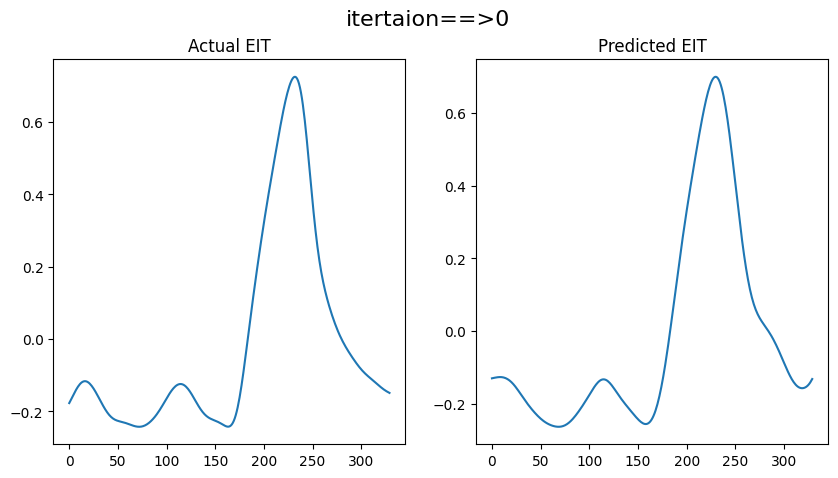

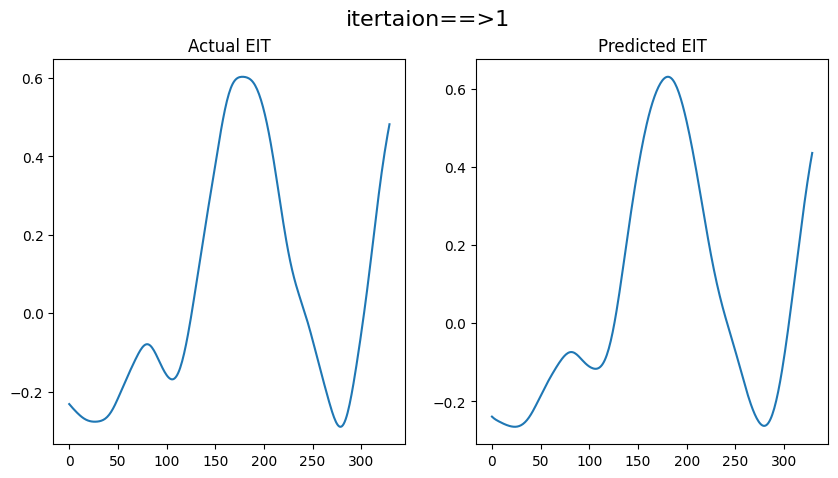

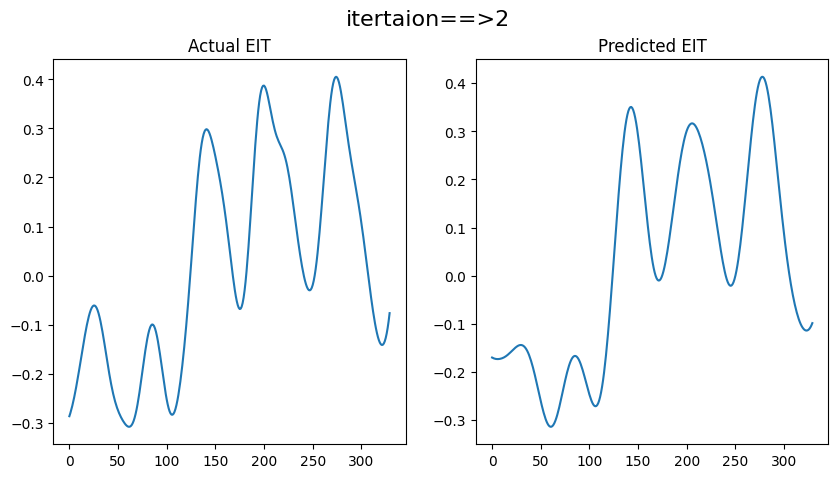

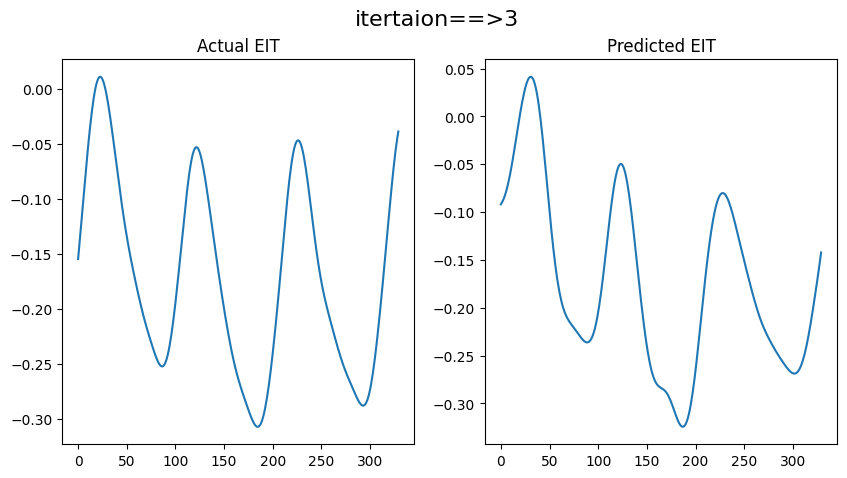

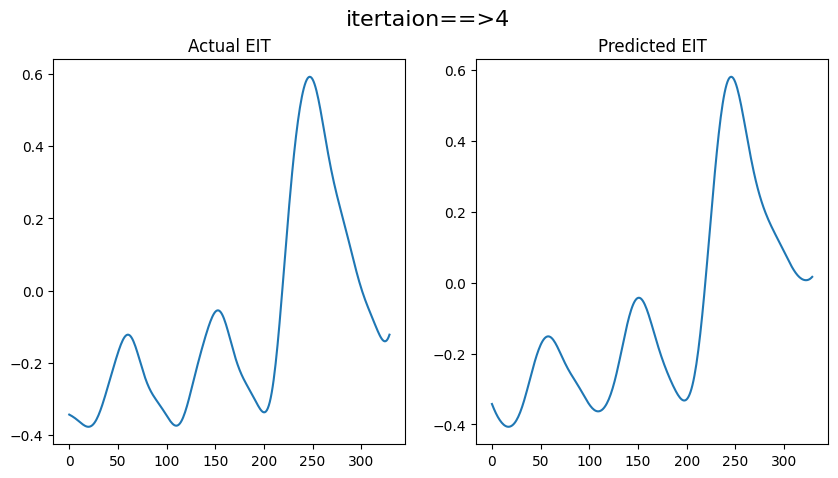

...

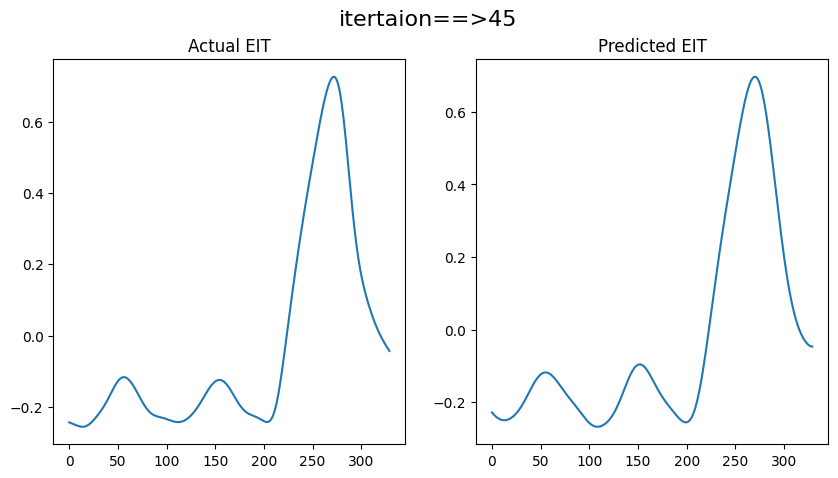

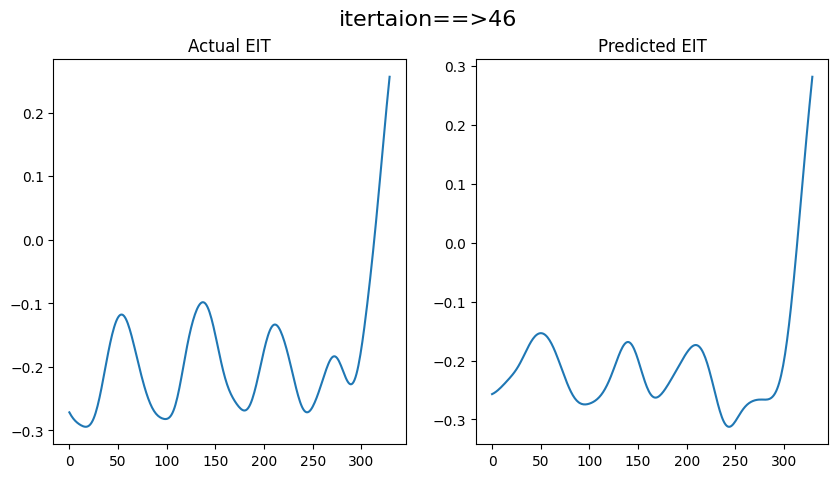

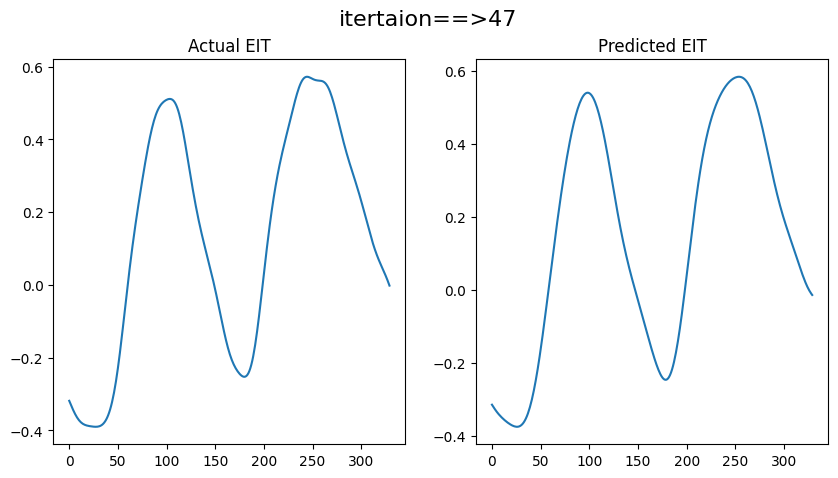

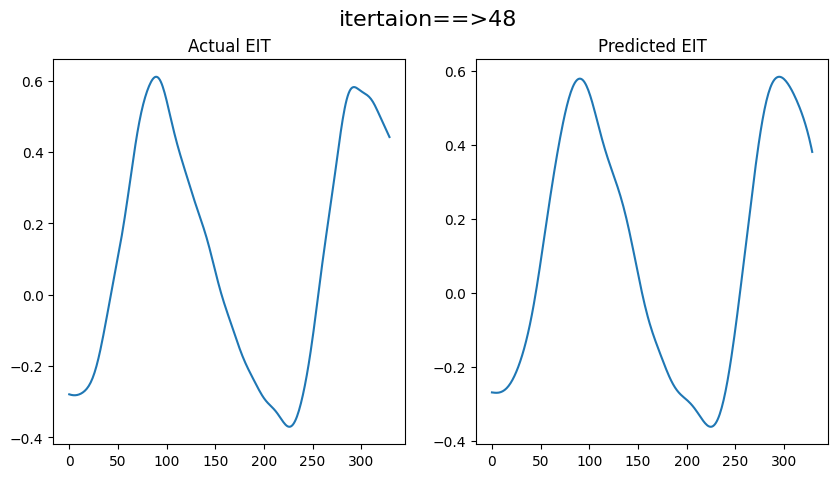

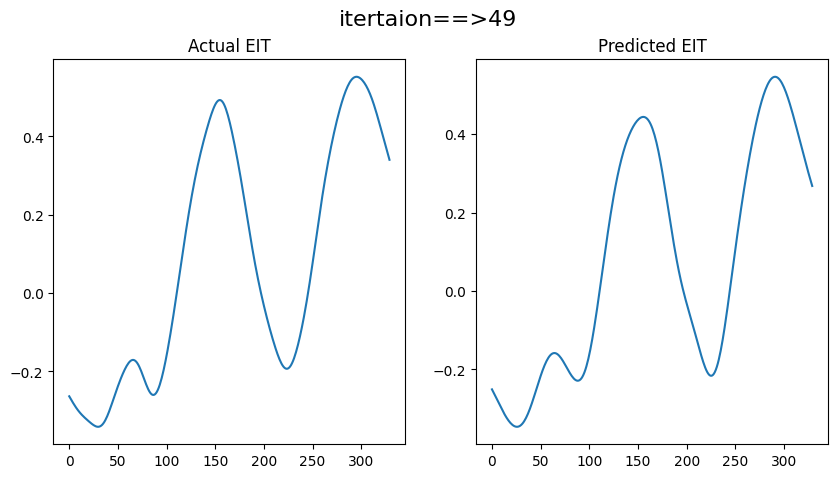

Average MAE: 0.024993440628906117
Standard Deviation MAE: 0.01181011374846319
Average MSE: 0.0012678398793527874
Standard Deviation MSE: 0.002151494912784652
Average RMSE: 0.03199022391801408
Standard Deviation RMSE: 0.01563539104173948
Average PCC: 0.9890705719544578
Standard Deviation PCC: 0.02203943085017878


In [ ]:
TbDb_10sec_model_json_path='/content/gdrive/MyDrive/ARKA/EIT_work/Results/shrinkcnn_transformer_lstm/TbDb/Model/EIT_model.json'
TbDb_10sec_model_weight_path='/content/gdrive/MyDrive/ARKA/EIT_work/Results/shrinkcnn_transformer_lstm/TbDb/Model/EIT_model_weights.h5'

TbDb_EIT_10sec_data_path='/content/gdrive/MyDrive/ARKA/EIT_work/TbDb/10_sec_data/EIT_98d5ov_TbDb.mat'
TbDb_Melspec_10sec_data_path='/content/gdrive/MyDrive/ARKA/EIT_work/TbDb/10_sec_data/Melspecs_TbDb'


results_gen(TbDb_Melspec_10sec_data_path,TbDb_EIT_10sec_data_path,TbDb_10sec_model_json_path,TbDb_10sec_model_weight_path)

### **5 sec**

shape of melspectrogram dataset(5208, 64, 39, 1)
shape of EIT dataset(5208, 165, 1)
17/17 [==============================] - 3s 115ms/step


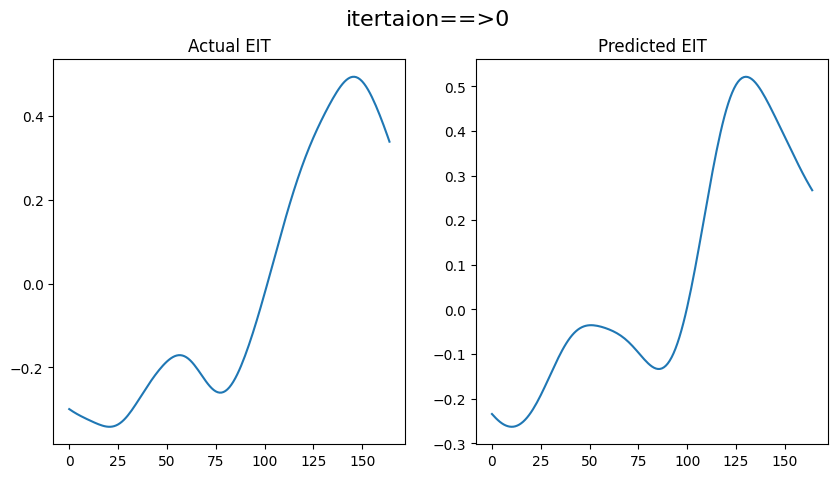

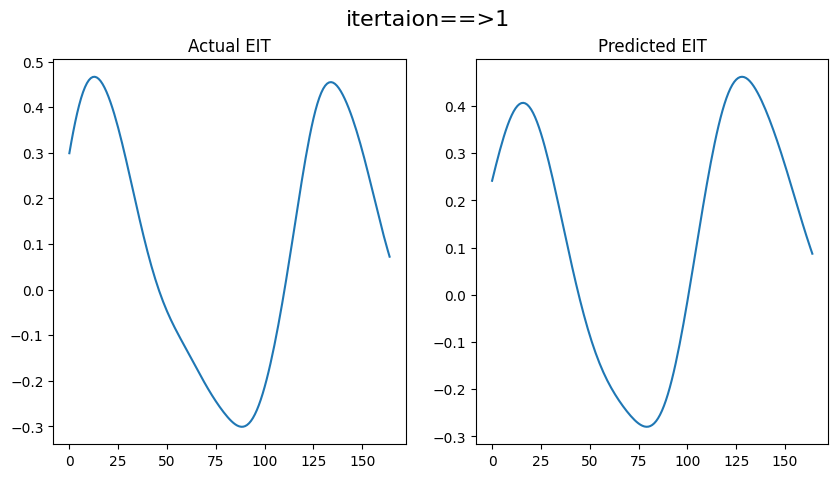

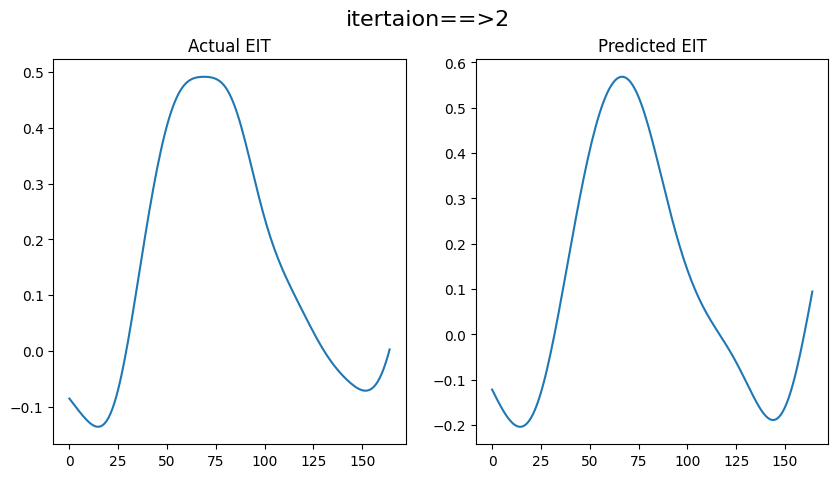

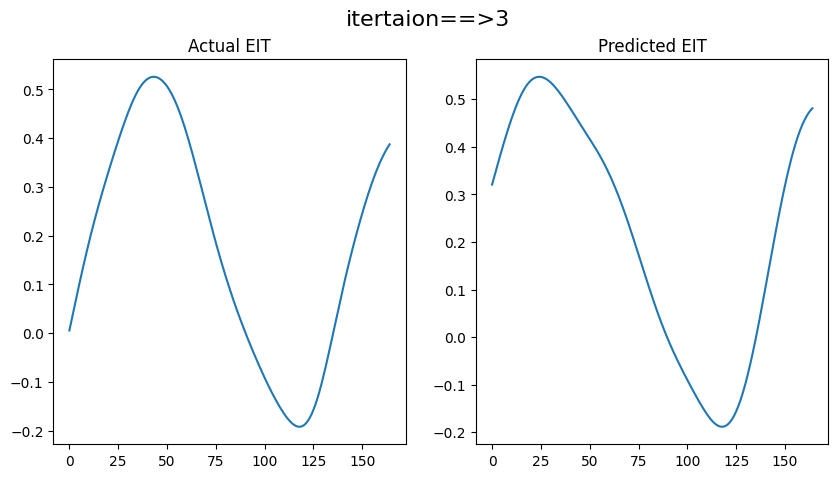

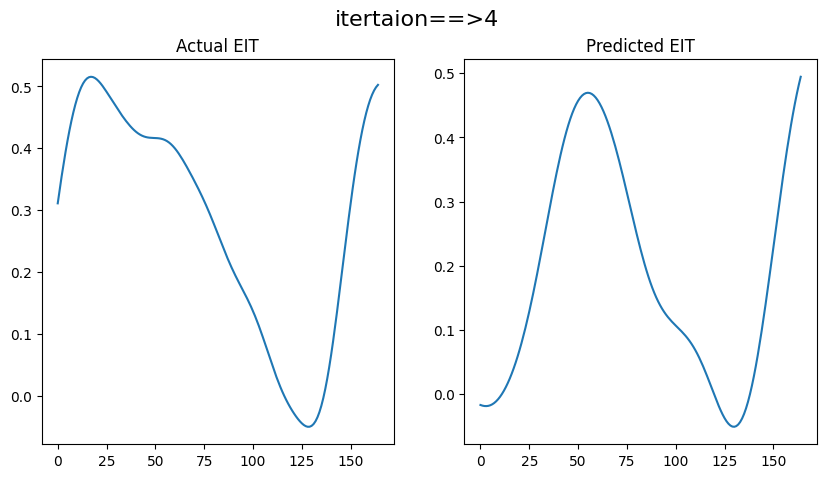

...

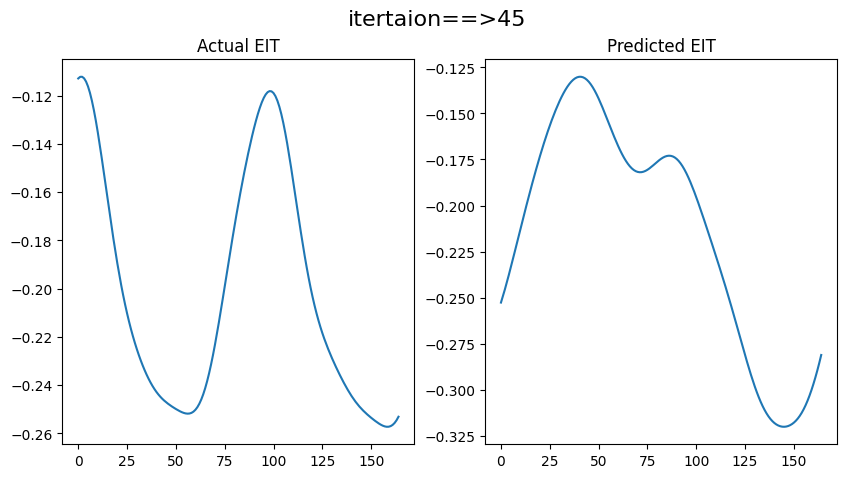

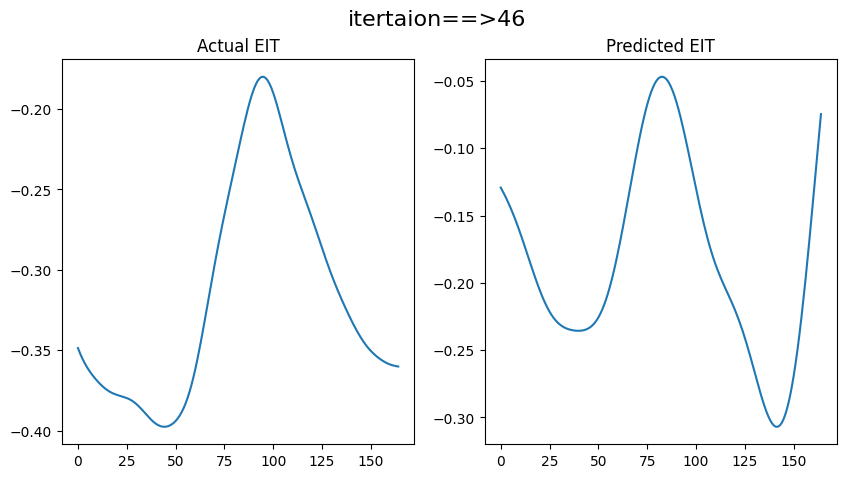

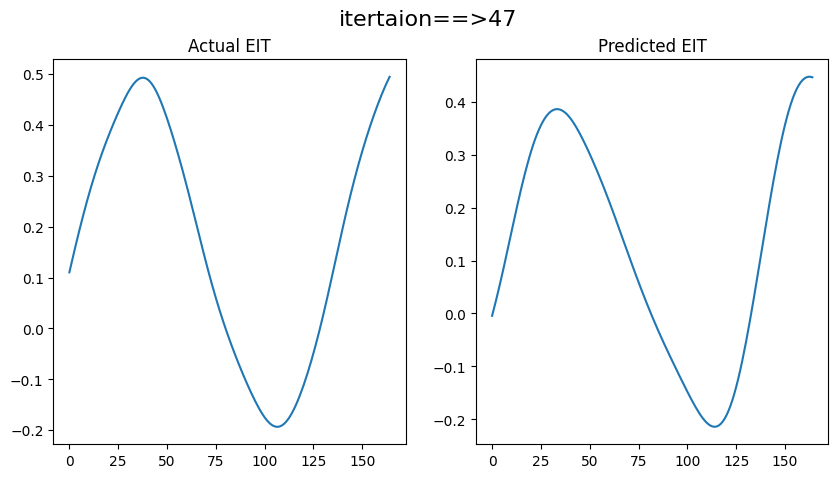

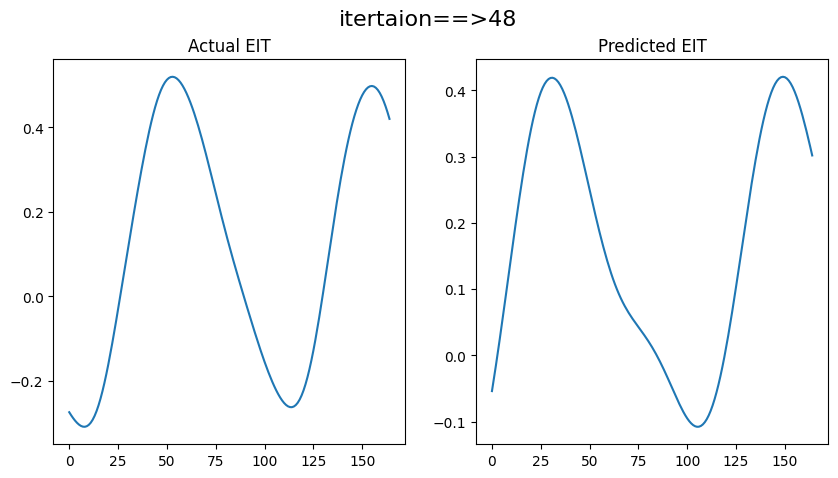

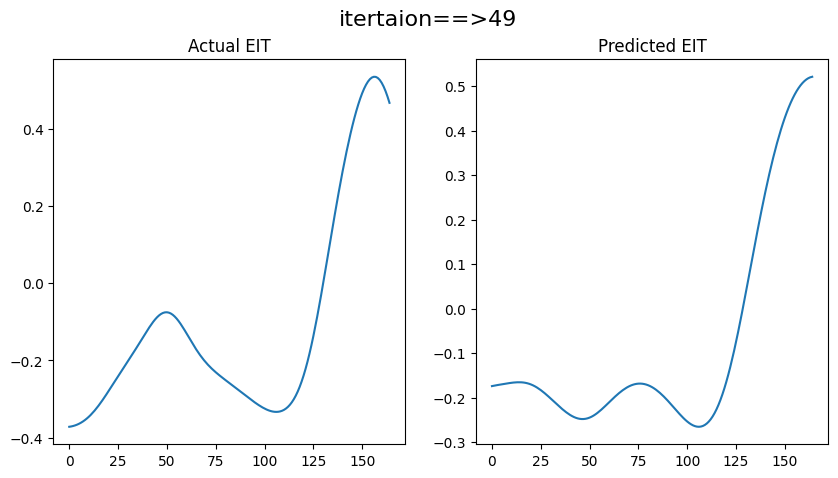

Average MAE: 0.11255842313334956
Standard Deviation MAE: 0.05981916438646691
Average MSE: 0.02291543676759779
Standard Deviation MSE: 0.024789885830903243
Average RMSE: 0.13496716288207117
Standard Deviation RMSE: 0.0685514530200656
Average PCC: 0.7156400259901843
Standard Deviation PCC: 0.39359756376380634


In [ ]:
TbDb_5sec_model_json_path='/content/gdrive/MyDrive/ARKA/EIT_work/TbDb/5_sec_data/EIT_model_tbdb_5sec.json'
TbDb_5sec_model_weight_path='/content/gdrive/MyDrive/ARKA/EIT_work/TbDb/5_sec_data/EIT_model_tbdb_5sec_weights.h5'

TbDb_EIT_5sec_data_path='/content/gdrive/MyDrive/ARKA/EIT_work/TbDb/5_sec_data/EITs_TbDb_5sec.mat'
TbDb_Melspec_5sec_data_path='/content/gdrive/MyDrive/ARKA/EIT_work/TbDb/5_sec_data/Melspecs_TbDb_5sec'


results_gen(TbDb_Melspec_5sec_data_path,TbDb_EIT_5sec_data_path,TbDb_5sec_model_json_path,TbDb_5sec_model_weight_path)

### **15 sec**

shape of melspectrogram dataset(4561, 64, 115, 1)
shape of EIT dataset(4561, 495, 1)
15/15 [==============================] - 2s 93ms/step


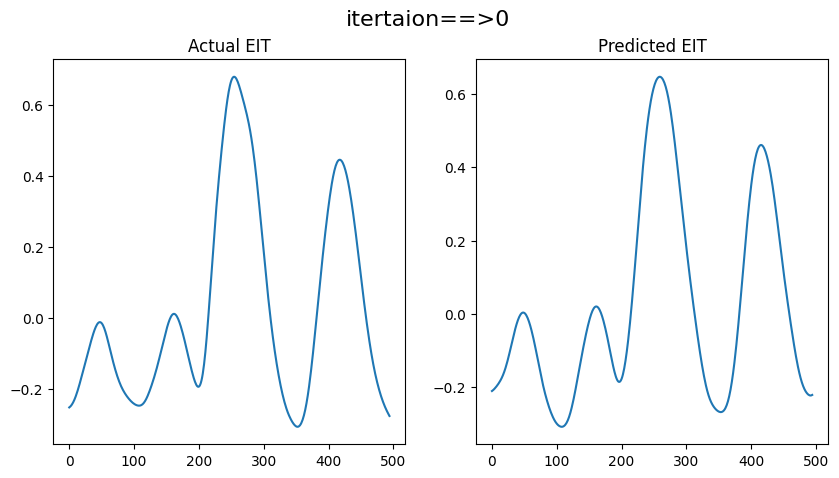

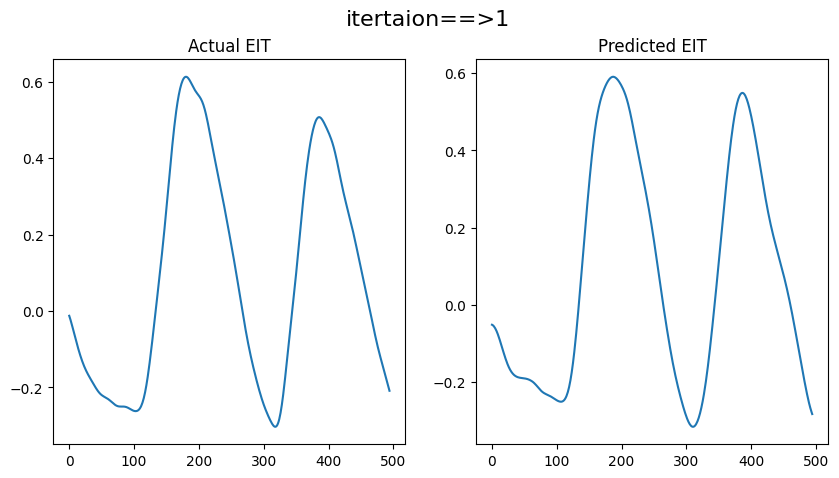

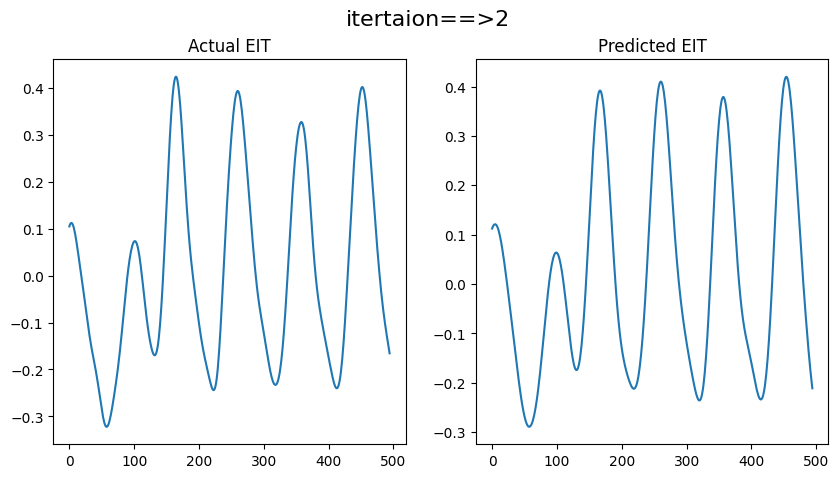

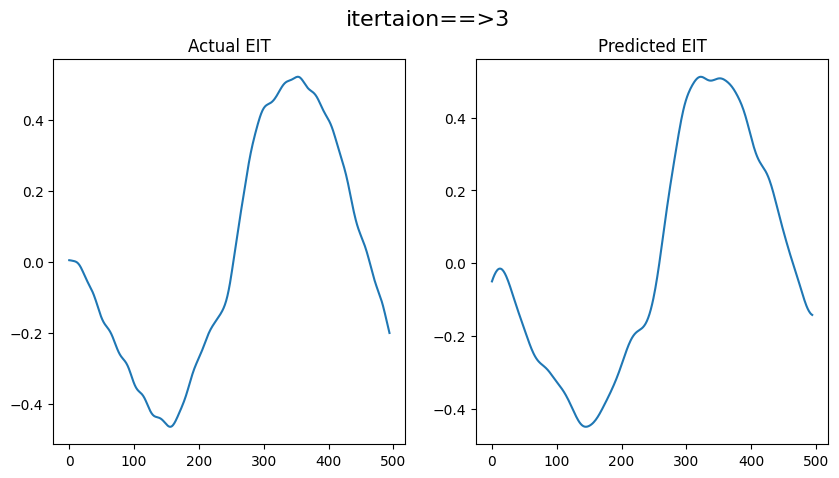

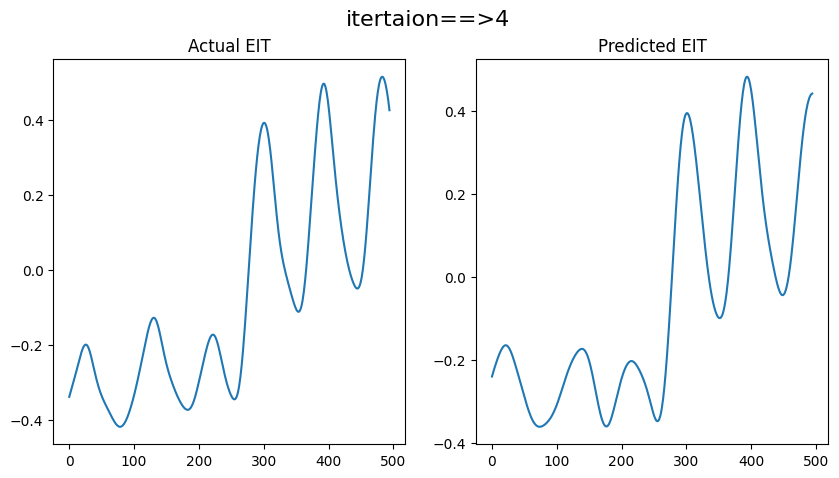

...

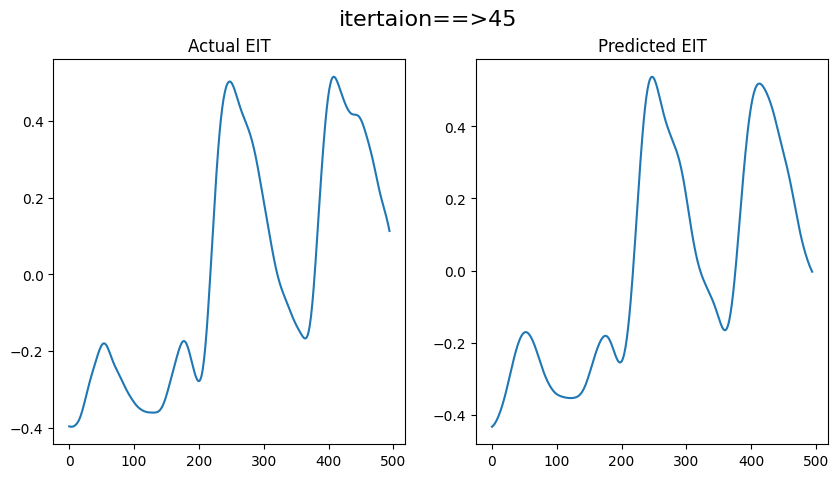

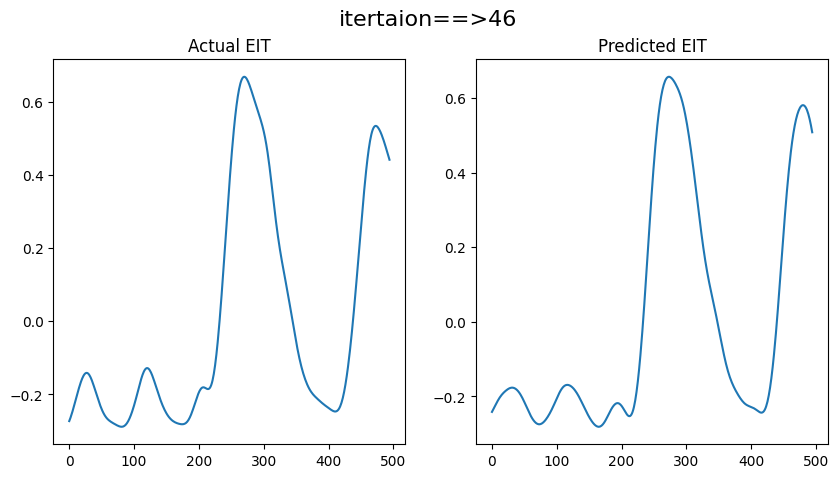

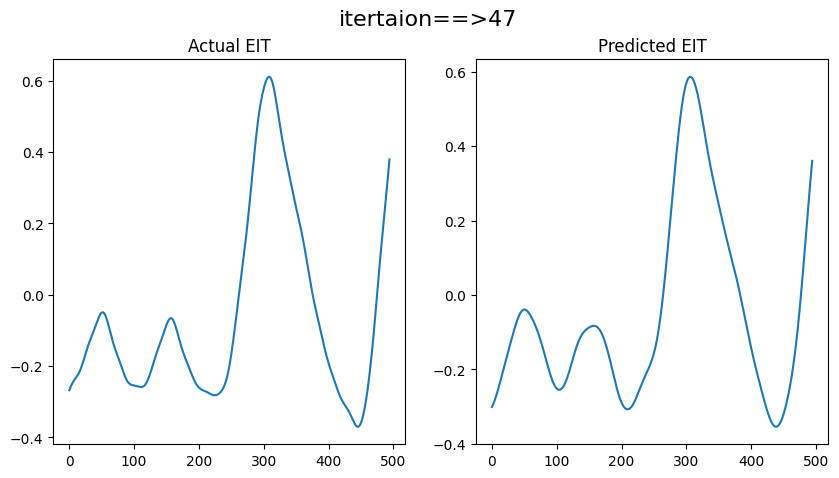

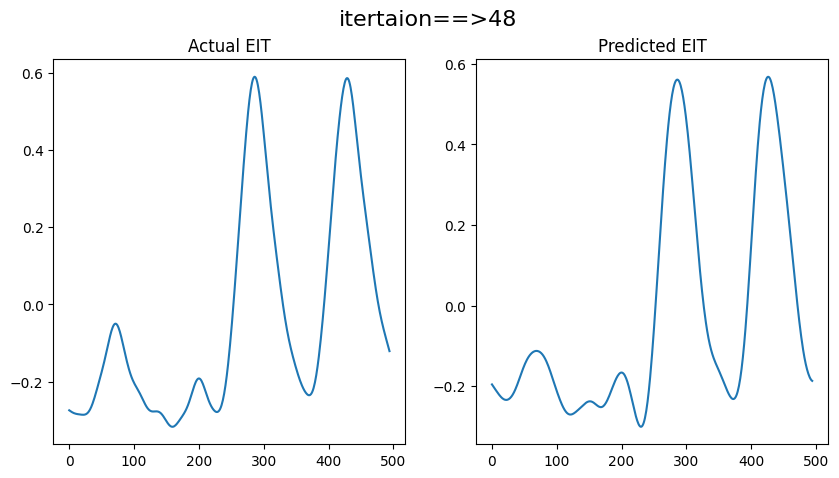

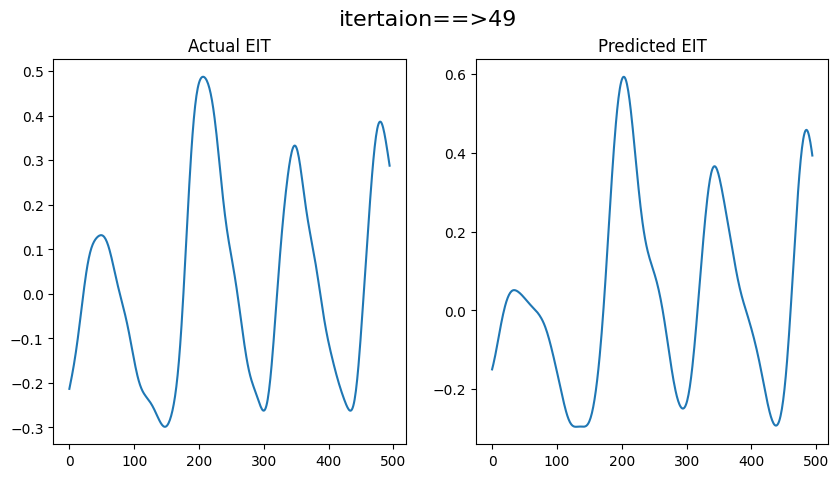

Average MAE: 0.03179005475257951
Standard Deviation MAE: 0.015233702238862947
Average MSE: 0.002132446648832626
Standard Deviation MSE: 0.005035007894849481
Average RMSE: 0.040944887561722355
Standard Deviation RMSE: 0.021353286196521118
Average PCC: 0.9849484066401323
Standard Deviation PCC: 0.038114253038170835


In [ ]:
TbDb_15sec_model_json_path='/content/gdrive/MyDrive/ARKA/EIT_work/TbDb/15_sec_data/EIT_model_tbdb_15sec.json'
TbDb_15sec_model_weight_path='/content/gdrive/MyDrive/ARKA/EIT_work/TbDb/15_sec_data/EIT_model_tbdb_15sec_weights.h5'

TbDb_EIT_15sec_data_path='/content/gdrive/MyDrive/ARKA/EIT_work/TbDb/15_sec_data/EITs_TbDb_15sec.mat'
TbDb_Melspec_15sec_data_path='/content/gdrive/MyDrive/ARKA/EIT_work/TbDb/15_sec_data/Melspecs_TbDb_15sec'


results_gen(TbDb_Melspec_15sec_data_path,TbDb_EIT_15sec_data_path,TbDb_15sec_model_json_path,TbDb_15sec_model_weight_path)

## **Task-3: TbCS train TbCS test**

### **10 sec**

shape of melspectrogram dataset(12900, 64, 77, 1)
shape of EIT dataset(12900, 330, 1)
41/41 [==============================] - 4s 82ms/step


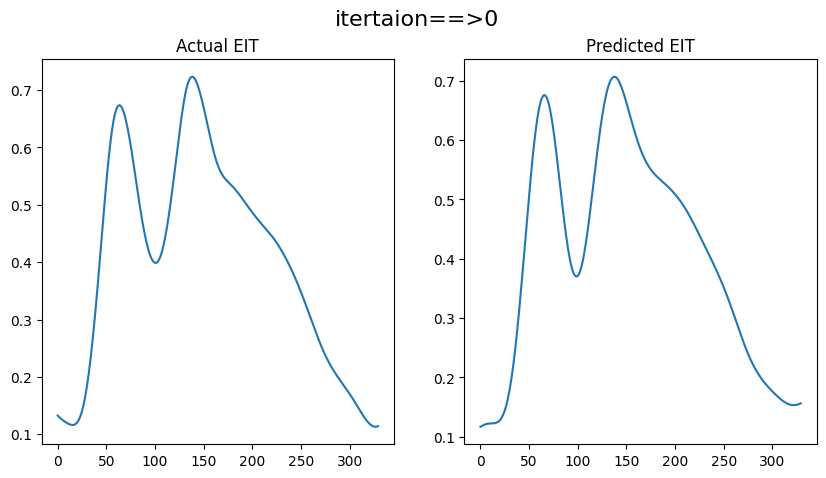

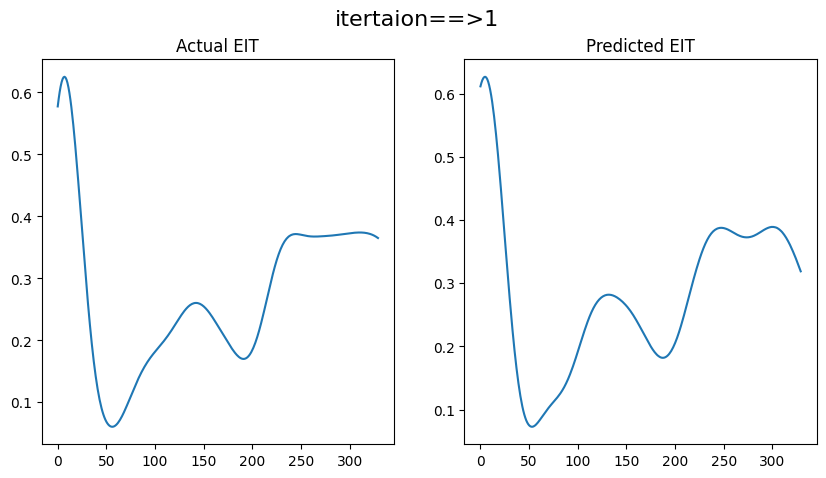

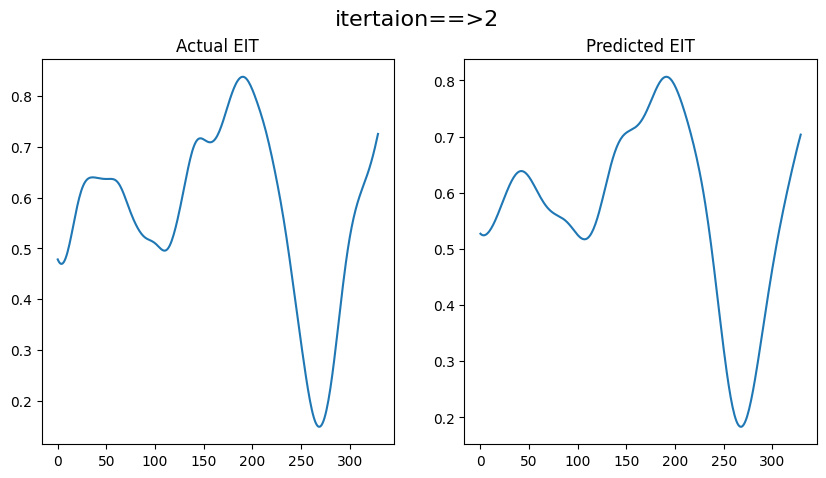

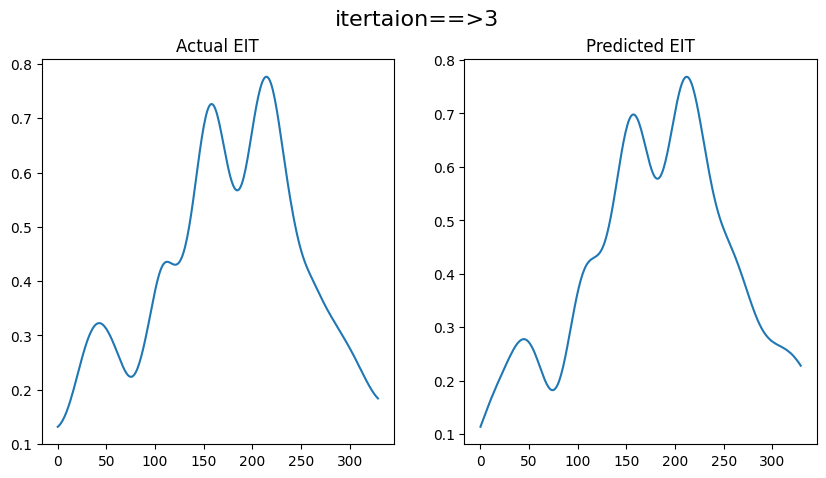

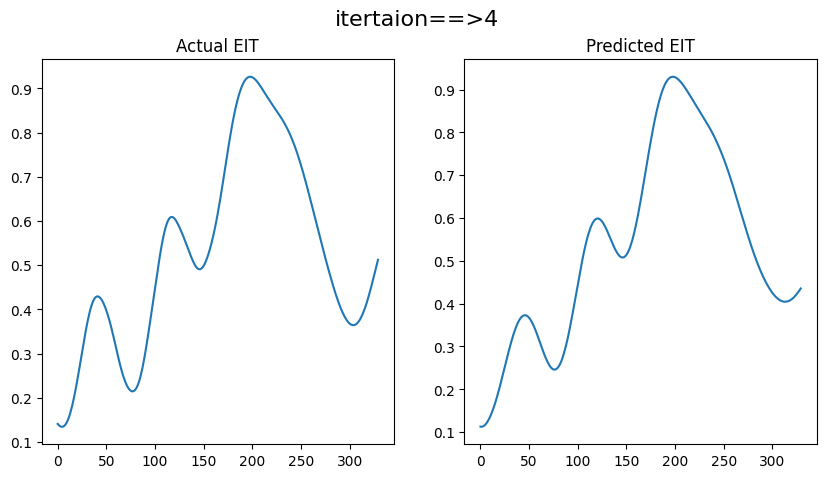

...

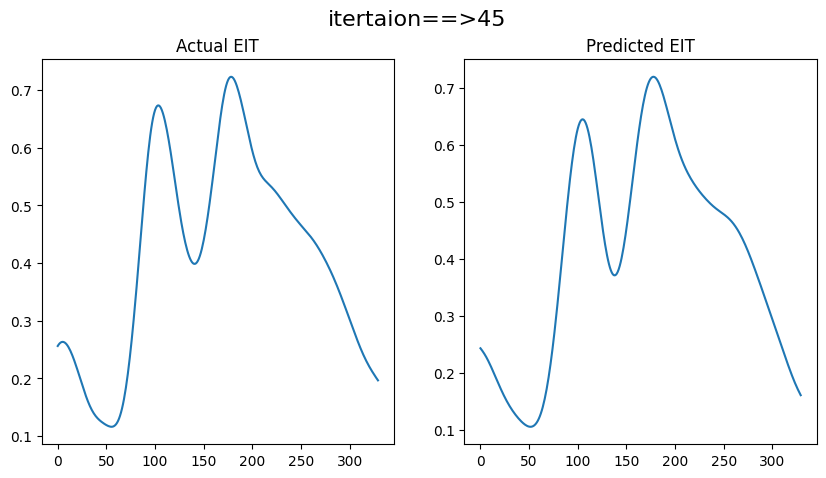

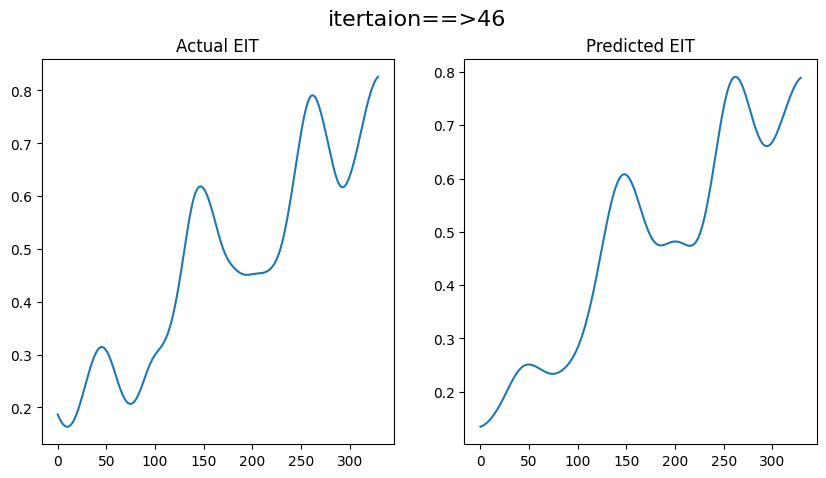

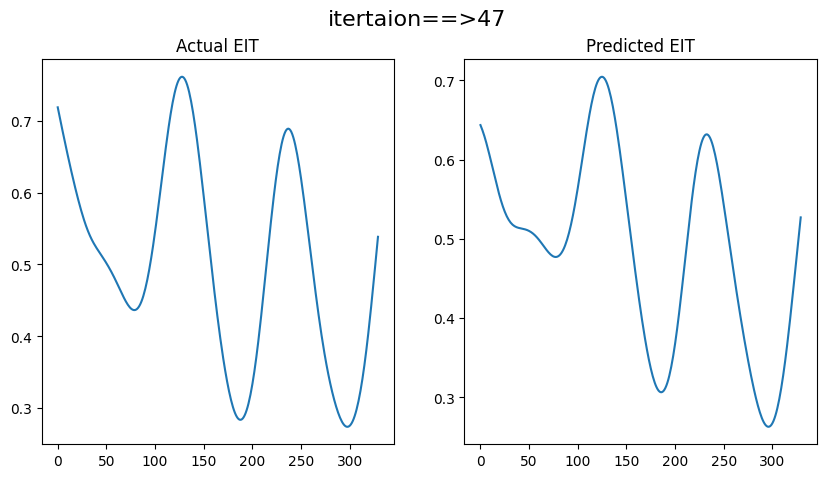

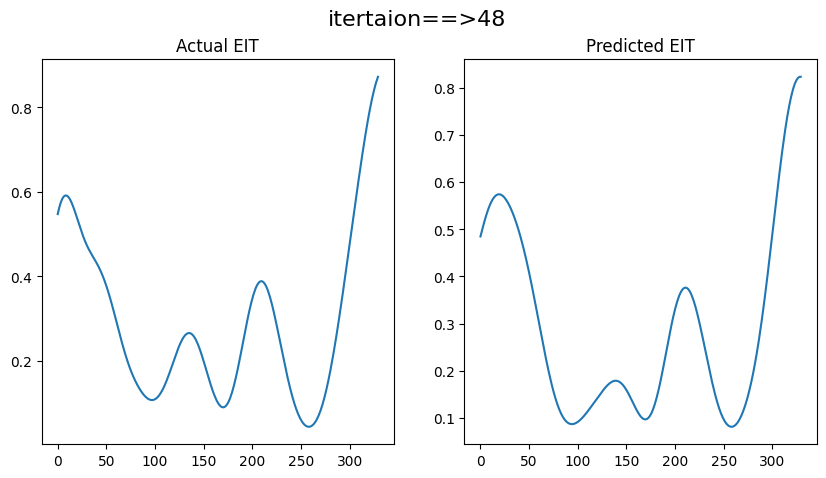

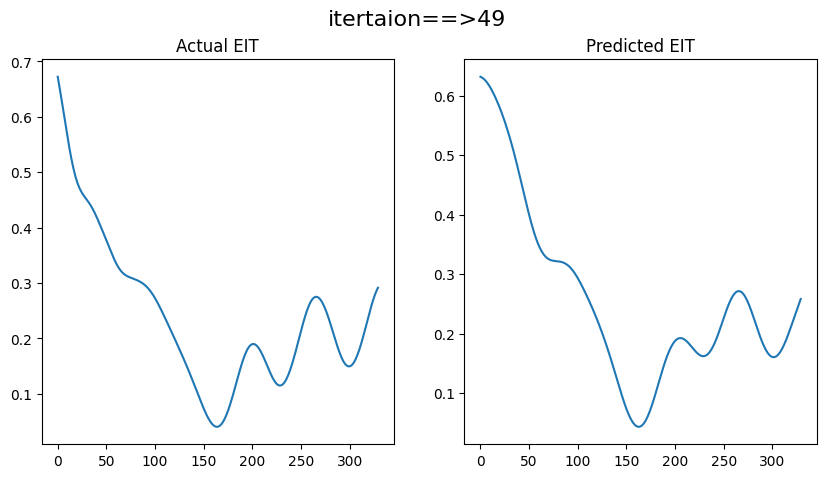

Average MAE: 0.020631608167700387
Standard Deviation MAE: 0.0115198813047533
Average MSE: 0.0008847058006714029
Standard Deviation MSE: 0.0018901684860718262
Average RMSE: 0.02607203651713172
Standard Deviation RMSE: 0.014316239468545967
Average PCC: 0.9852943619870167
Standard Deviation PCC: 0.030604881440616422


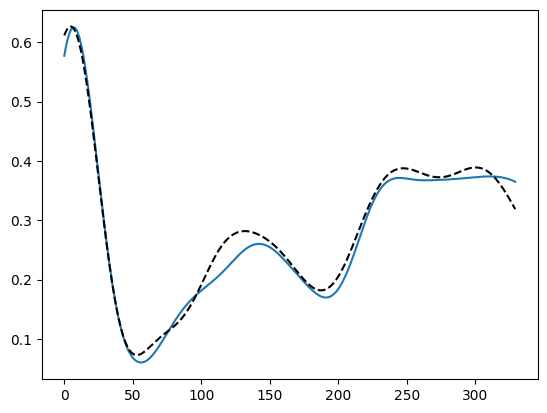

In [ ]:
TbCS_10sec_model_json_path='/content/gdrive/MyDrive/ARKA/EIT_work/Results/shrinkcnn_transformer_lstm/TbCS/Model/EIT_model_tbcs.json'
TbCS_10sec_model_weight_path='/content/gdrive/MyDrive/ARKA/EIT_work/Results/shrinkcnn_transformer_lstm/TbCS/Model/EIT_model_weights_tbcs.h5'

TbCS_EIT_10sec_data_path='/content/gdrive/MyDrive/ARKA/EIT_work/TbCS/10_sec_data/EIT_tbcs.mat'
TbCS_Melspec_10sec_data_path='/content/gdrive/MyDrive/ARKA/EIT_work/TbCS/10_sec_data/Melspecs_tbcs'


results_gen(TbCS_Melspec_10sec_data_path,TbCS_EIT_10sec_data_path,TbCS_10sec_model_json_path,TbCS_10sec_model_weight_path)

### **15 sec**

shape of melspectrogram dataset(2280, 64, 115, 1)
shape of EIT dataset(2280, 495, 1)
8/8 [==============================] - 2s 98ms/step


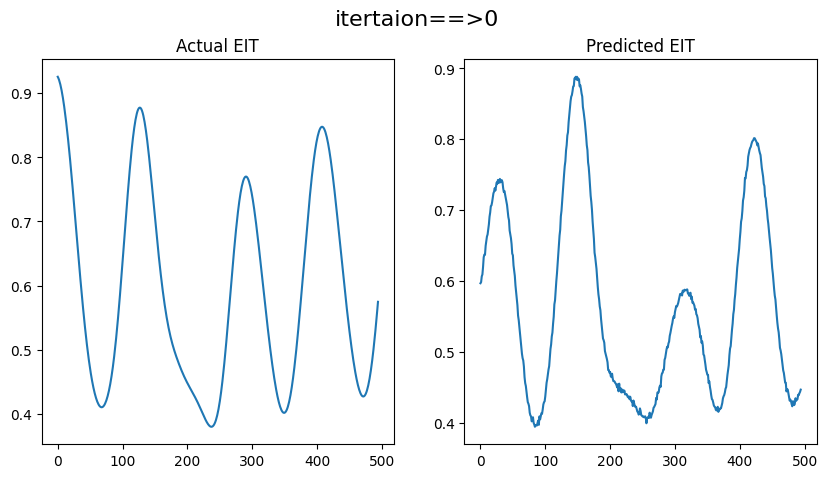

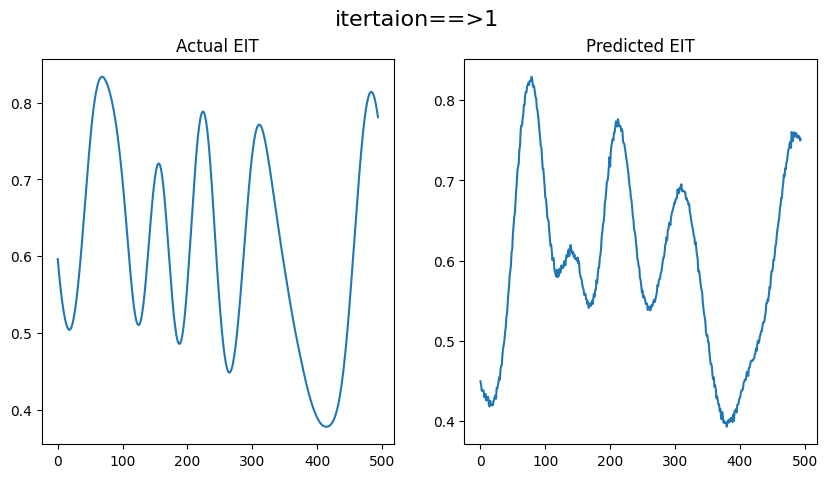

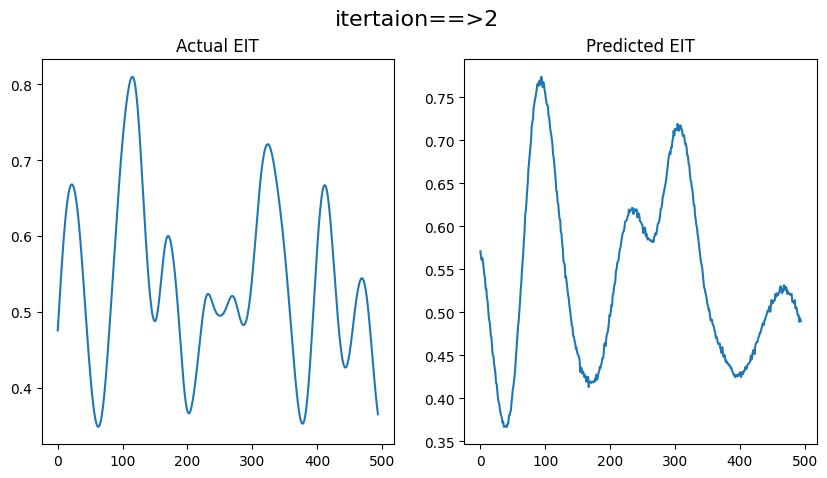

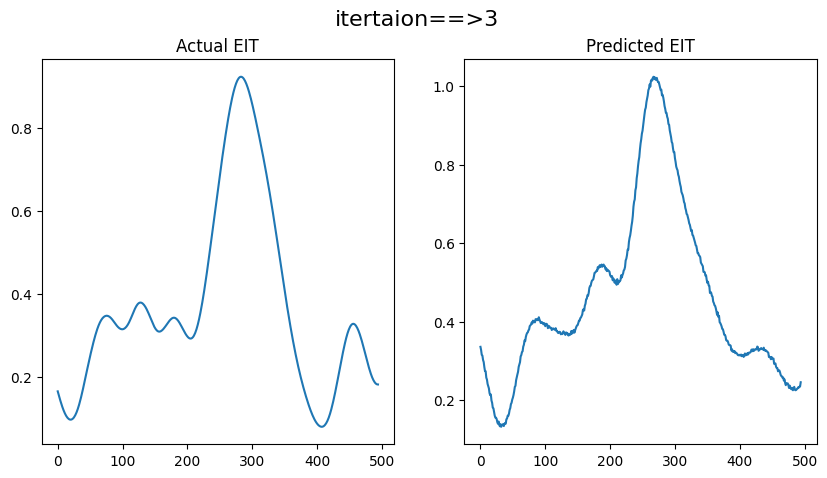

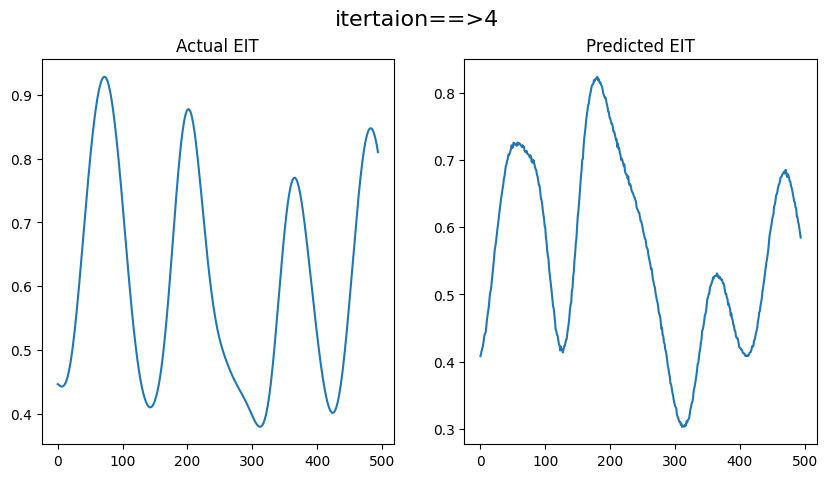

...

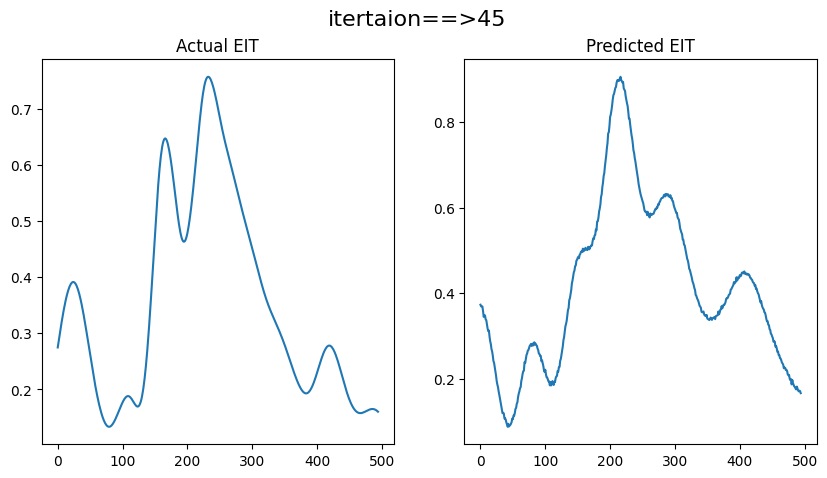

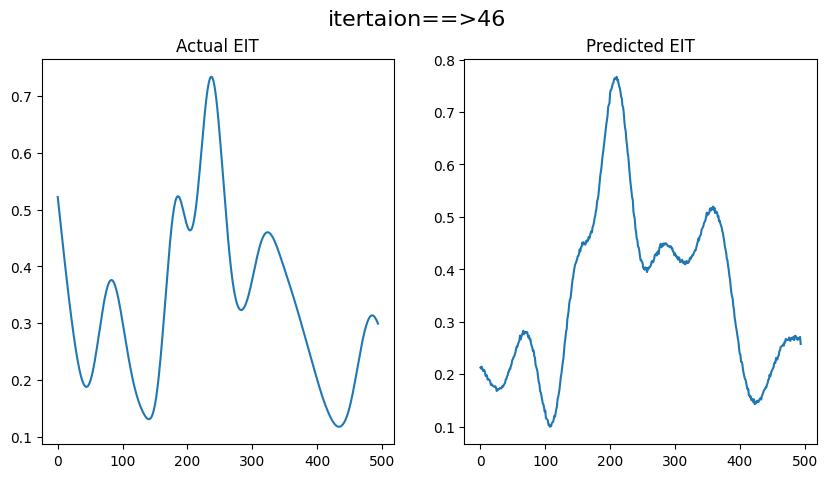

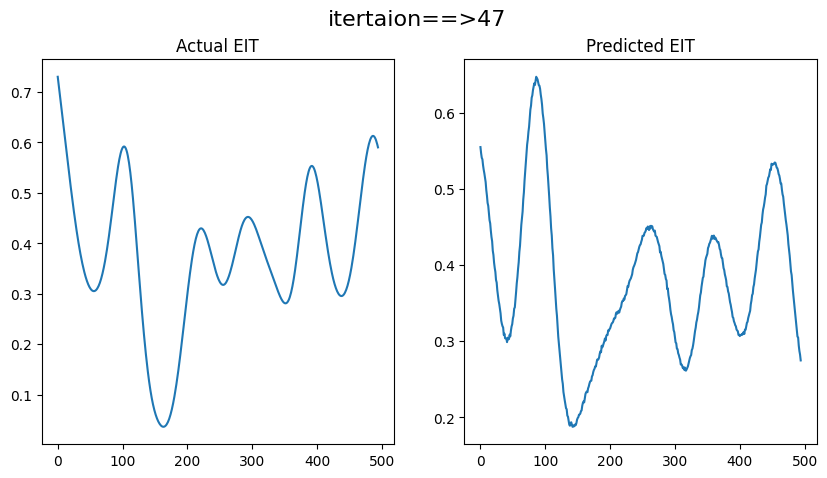

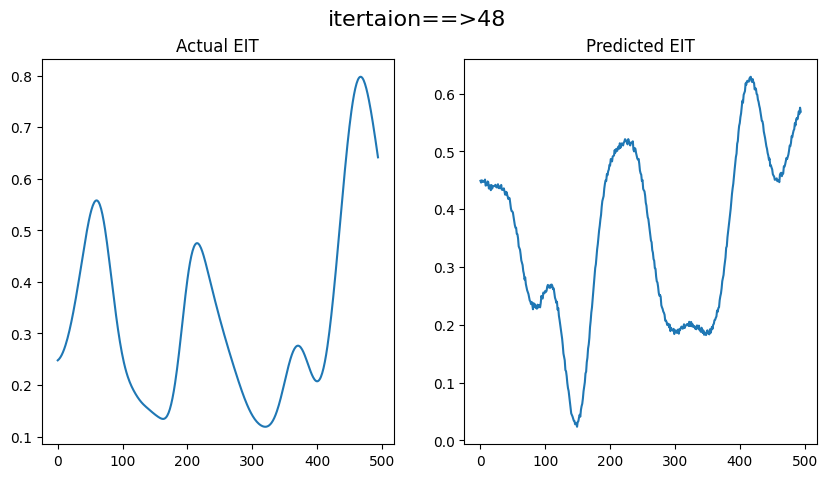

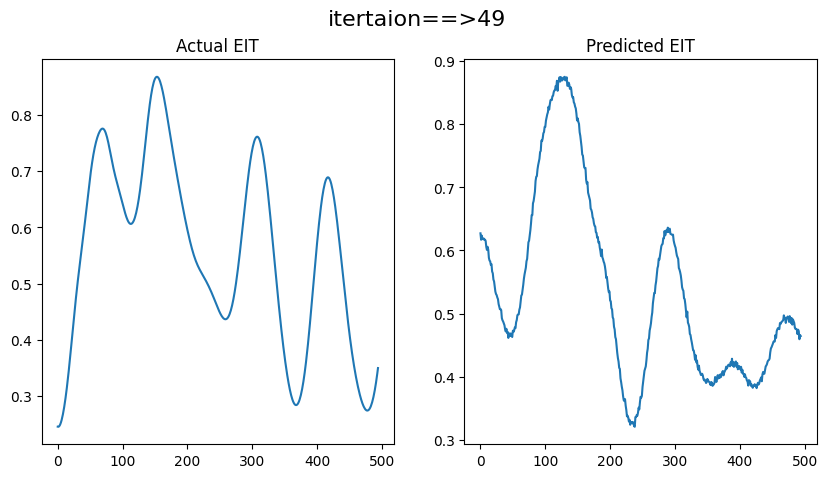

Average MAE: 0.10252620637569904
Standard Deviation MAE: 0.03367950706829445
Average MSE: 0.017752749917132153
Standard Deviation MSE: 0.012064830203151298
Average RMSE: 0.12711006265641756
Standard Deviation RMSE: 0.03994723881088344
Average PCC: 0.7312389489792736
Standard Deviation PCC: 0.19438312705066335


In [ ]:
TbCS_15sec_model_json_path='/content/gdrive/MyDrive/ARKA/EIT_work/TbCS/15_sec_data/EIT_model_tbcs_15sec.json'
TbCS_15sec_model_weight_path='/content/gdrive/MyDrive/ARKA/EIT_work/TbCS/15_sec_data/EIT_model_tbcs_15sec_weights.h5'

TbCS_EIT_15sec_data_path='/content/gdrive/MyDrive/ARKA/EIT_work/TbCS/15_sec_data/EITs_tbcs_15sec.mat'
TbCS_Melspec_15sec_data_path='/content/gdrive/MyDrive/ARKA/EIT_work/TbCS/15_sec_data/Melspecs_tbcs_15sec'

results_gen(TbCS_Melspec_15sec_data_path,TbCS_EIT_15sec_data_path,TbCS_15sec_model_json_path,TbCS_15sec_model_weight_path)

### **5 sec**

shape of melspectrogram dataset(5208, 64, 39, 1)
shape of EIT dataset(5208, 165, 1)
17/17 [==============================] - 3s 138ms/step


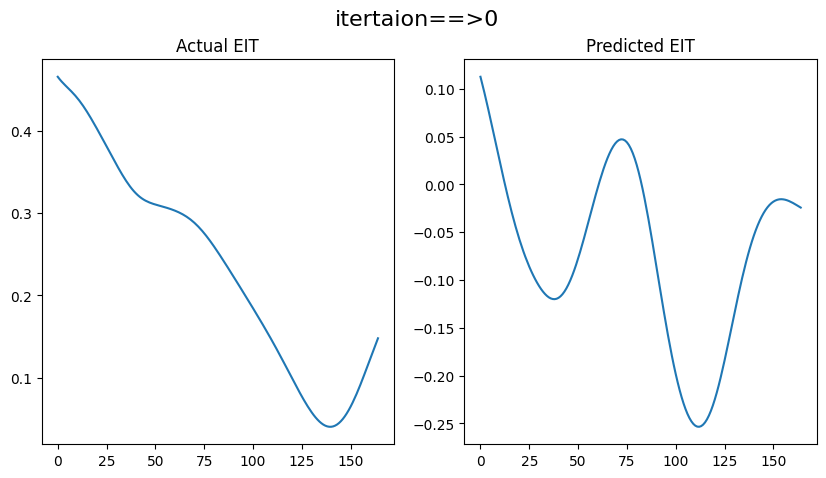

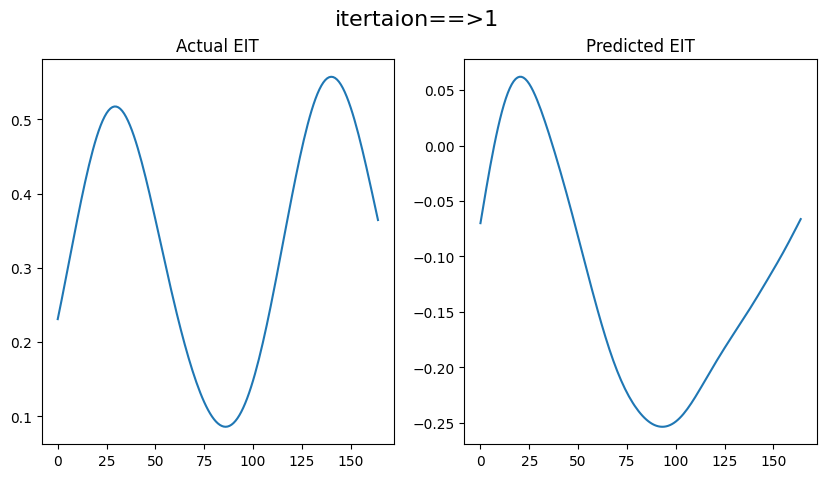

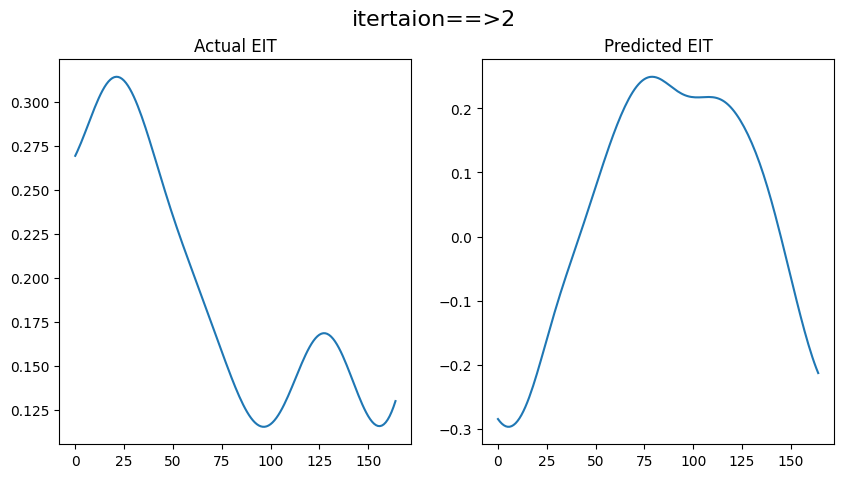

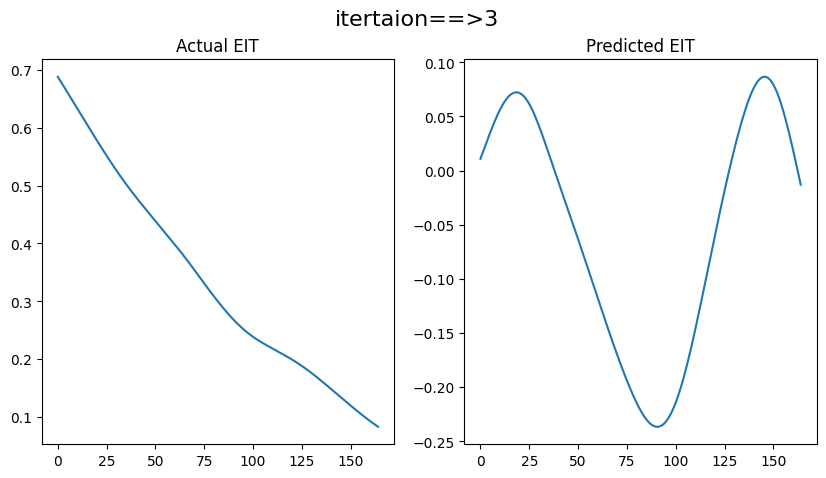

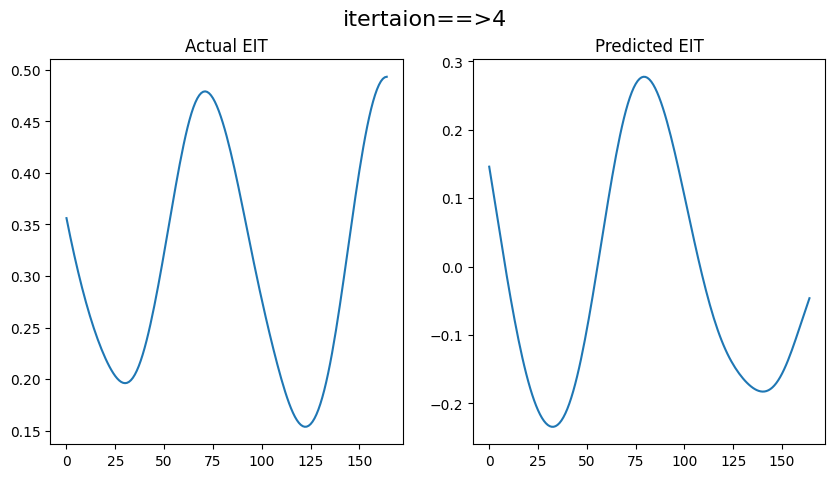

...

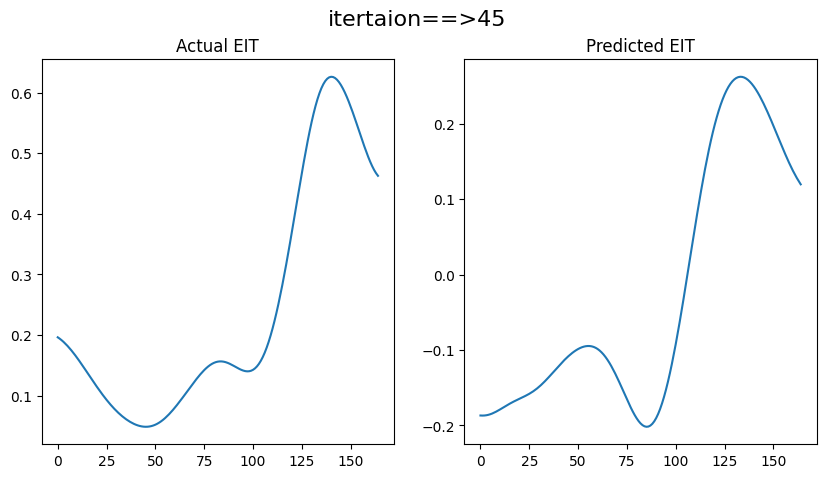

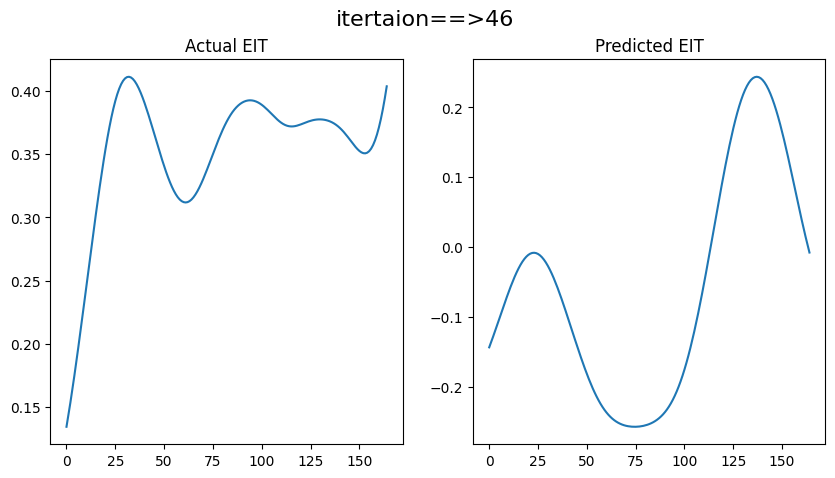

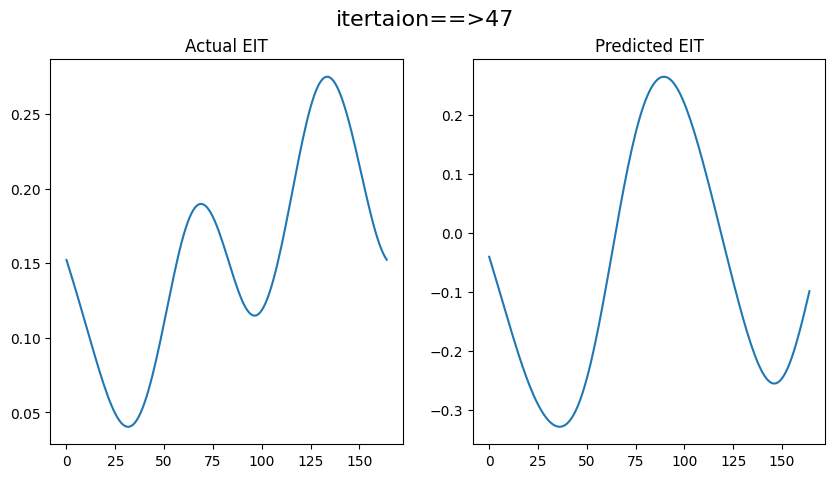

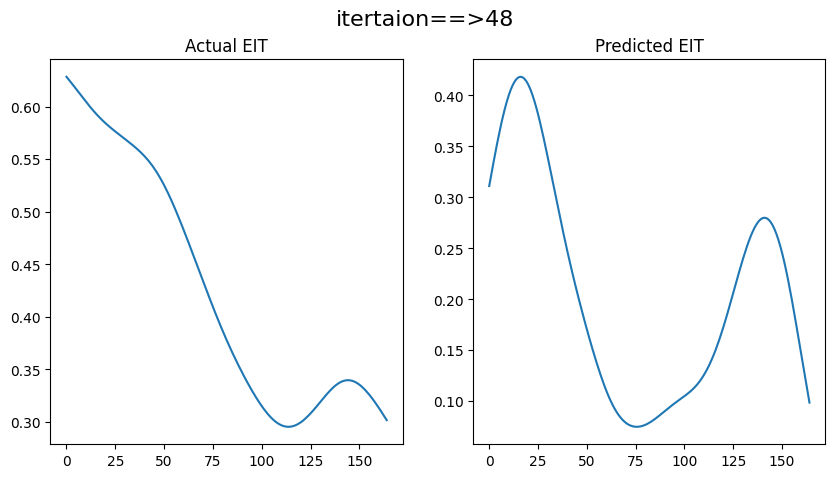

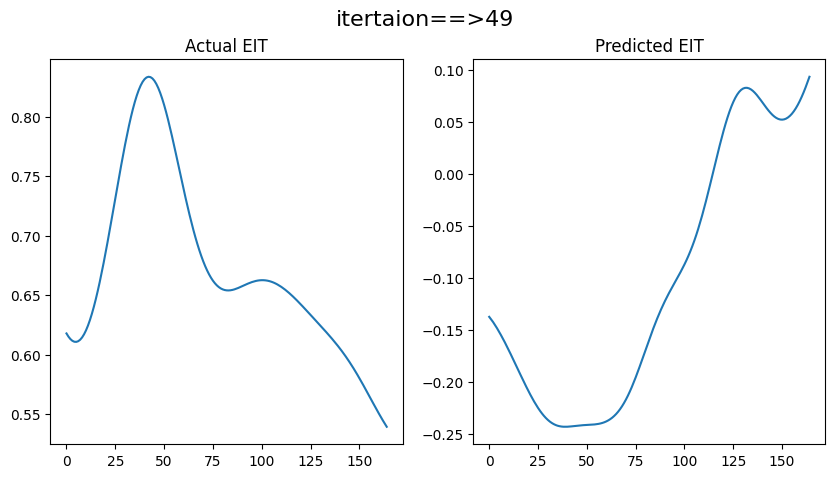

Average MAE: 0.42911674834531366
Standard Deviation MAE: 0.1588428673489137
Average MSE: 0.2437782362121716
Standard Deviation MSE: 0.15192494926633912
Average RMSE: 0.4681626163986602
Standard Deviation RMSE: 0.15685024966168404
Average PCC: 0.05632074967169817
Standard Deviation PCC: 0.5105661893789427


In [ ]:
TbCS_5sec_model_json_path='/content/gdrive/MyDrive/ARKA/EIT_work/TbCS/5_sec_data/EIT_model_tbcs_5sec.json'
TbCS_5sec_model_weight_path='/content/gdrive/MyDrive/ARKA/EIT_work/TbCS/5_sec_data/EIT_model_tbcs_5sec_weights.h5'

TbCS_EIT_5sec_data_path='/content/gdrive/MyDrive/ARKA/EIT_work/TbCS/5_sec_data/EITs_tbcs_5sec.mat'
TbCS_Melspec_5sec_data_path='/content/gdrive/MyDrive/ARKA/EIT_work/TbCS/5_sec_data/Melspecs_tbcs_5sec'

results_gen(TbCS_Melspec_5sec_data_path,TbCS_EIT_5sec_data_path,TbCS_5sec_model_json_path,TbCS_5sec_model_weight_path)

## **Task-5: TbDb+TbCS train; TbDb+TbCS test**

In [ ]:
import numpy as np
from scipy.stats import pearsonr

# Define functions to calculate the required metrics
def mae(y_true, y_pred):
    return np.mean(np.abs(y_true - y_pred))

def mse(y_true, y_pred):
    return np.mean((y_true - y_pred) ** 2)

def rmse(y_true, y_pred):
    return np.sqrt(mse(y_true, y_pred))

def pcc(y_true, y_pred):
    return pearsonr(y_true, y_pred)[0]

def results_gen(Melspec_tbdb_path, EIT_tbdb_path, Melspec_tbcs_path, EIT_tbcs_path, model_path, model_weight_path):

    EIT_tbdb_dict=mat73.loadmat(EIT_tbdb_path)
    key_dict_tbdb = list(EIT_tbdb_dict.keys())
    EIT_tbdb_sigs=EIT_tbdb_dict[key_dict_tbdb[0]]
    Melspecs_tbdb= load_pickle_file(Melspec_tbdb_path)

    EIT_tbcs_dict=mat73.loadmat(EIT_tbcs_path)
    key_dict_tbcs = list(EIT_tbcs_dict.keys())
    EIT_tbcs_sigs=EIT_tbcs_dict[key_dict_tbcs[0]]
    Melspecs_tbcs= load_pickle_file(Melspec_tbcs_path)


    Melspec_tbdb_tbcs=np.concatenate((Melspecs_tbdb,Melspecs_tbcs),axis=0)
    EIT_tbdb_tbcs_sigs=np.concatenate((EIT_tbdb_sigs,EIT_tbcs_sigs),axis=1)

    Melspecs_re=np.expand_dims(Melspec_tbdb_tbcs, axis=-1)
    EITs_re = np.expand_dims(EIT_tbdb_tbcs_sigs.T, axis=-1)

    tbdb_labels=[]
    for i in range (Melspecs_tbdb.shape[0]):
        tbdb_labels.append('TbDb')

    tbcs_labels=[]
    for i in range (Melspecs_tbcs.shape[0]):
        tbcs_labels.append('TbCS')

    labels=tbdb_labels+tbcs_labels
    labels=np.array(labels)

    print('shape of melspectrogram TbCS+TbDb dataset'+str(np.shape(Melspecs_re)))
    print('shape of EIT TbCS+TbDb dataset'+str(np.shape(EITs_re)))
    print('shape of labels TbCS+TbDb dataset'+str(np.shape(labels)))


    seed=10
    X_train1, X_test, Y_train1,Y_test,l_train1,l_test = train_test_split(Melspecs_re,EITs_re,labels, test_size=0.1,random_state=seed)
    X_train, X_valid,Y_train, Y_valid,l_train,l_valid = train_test_split(X_train1,Y_train1,l_train1,test_size=0.1,random_state=seed)


    import tensorflow as tf
    from tensorflow.keras.layers import Layer, Conv2D, BatchNormalization, Activation, GlobalAveragePooling2D, Dense, Reshape, Add, MaxPooling2D, MultiHeadAttention, LayerNormalization, Dropout, LSTM, Input
    from tensorflow.keras.models import Model
    from tensorflow.keras.models import model_from_json
    @tf.keras.utils.register_keras_serializable()
    class ResidualShrinkage(Layer):
        def __init__(self, filters, **kwargs):
            super(ResidualShrinkage, self).__init__(**kwargs)
            self.filters = filters

        def build(self, input_shape):
            self.global_avg_pool = GlobalAveragePooling2D()
            self.dense_1 = Dense(self.filters // 4, activation='relu')
            self.dense_2 = Dense(self.filters, activation='sigmoid')
            super(ResidualShrinkage, self).build(input_shape)

        def call(self, inputs):
            # Global average pooling
            x = self.global_avg_pool(inputs)

            # Fully connected layers for learning thresholds
            x = self.dense_1(x)
            scales = self.dense_2(x)

            # Reshape to match input dimensions
            scales = Reshape((1, 1, self.filters))(scales)

            # Apply soft thresholding
            residual = inputs - tf.sign(inputs) * tf.maximum(tf.abs(inputs) - scales, 0)
            return residual

    def residual_shrinkage_block(inputs, filters, kernel_size=3, strides=1):
        x = Conv2D(filters, kernel_size, strides=strides, padding='same')(inputs)
        x = BatchNormalization()(x)
        x = Activation('relu')(x)

        x = Conv2D(filters, kernel_size, strides=1, padding='same')(x)
        x = BatchNormalization()(x)

        if strides > 1 or inputs.shape[-1] != filters:
            inputs = Conv2D(filters, kernel_size=1, strides=strides, padding='same')(inputs)

        x = ResidualShrinkage(filters)(x)

        x = Add()([x, inputs])
        x = Activation('relu')(x)

        return x

    @tf.keras.utils.register_keras_serializable()
    class TransformerBlock(Layer):
        def __init__(self, embed_dim, num_heads, ff_dim, rate=0.1):
            super(TransformerBlock, self).__init__()
            self.att = MultiHeadAttention(num_heads=num_heads, key_dim=embed_dim)
            self.ffn = tf.keras.Sequential(
                [Dense(ff_dim, activation="relu"), Dense(embed_dim)]
            )
            self.layernorm1 = LayerNormalization(epsilon=1e-6)
            self.layernorm2 = LayerNormalization(epsilon=1e-6)
            self.dropout1 = Dropout(rate)
            self.dropout2 = Dropout(rate)

        def call(self, inputs, training):
            attn_output = self.att(inputs, inputs)
            attn_output = self.dropout1(attn_output, training=training)
            out1 = self.layernorm1(inputs + attn_output)
            ffn_output = self.ffn(out1)
            ffn_output = self.dropout2(ffn_output, training=training)
            return self.layernorm2(out1 + ffn_output)

    def build_model(input_shape):
        inputs = Input(shape=input_shape)
        x = Conv2D(16, kernel_size=3, strides=1)(inputs)
        x = BatchNormalization()(x)
        x = Activation('relu')(x)
        x = MaxPooling2D((2, 2))(x)

        x = Conv2D(32, kernel_size=3, strides=1)(x)
        x = BatchNormalization()(x)
        x = Activation('relu')(x)

        x = Conv2D(64, kernel_size=3, strides=1, padding='same')(x)
        x = BatchNormalization()(x)
        x = Activation('relu')(x)
        x = MaxPooling2D((2, 2))(x)

        x = residual_shrinkage_block(x, 64)
        x = MaxPooling2D((2, 2))(x)
        # Reshape the output to (batch_size, num_patches, embed_dim)
        x = Reshape((x.shape[1] * x.shape[2], x.shape[3]))(x)

        # Transformer Block
        x = TransformerBlock(embed_dim=64, num_heads=4, ff_dim=128)(x)

        x = LSTM(64, return_sequences=True)(x)
        x = LSTM(64)(x)

        outputs = Dense(EITs_re.shape[1])(x)
        outputs = Reshape((EITs_re.shape[1], 1))(outputs)
        model = Model(inputs, outputs)
        return model

    EIT_model = build_model((Melspecs_re.shape[1], Melspecs_re.shape[2], 1))
    EIT_model.compile(optimizer='adam', loss='mse')

    # Load json
    json_file = open(model_path, 'r')
    EIT_model_json = json_file.read()
    json_file.close()

    # Register custom objects
    custom_objects = {
        'ResidualShrinkage': ResidualShrinkage,
        'TransformerBlock': TransformerBlock
    }

    # Load model
    EIT_model = model_from_json(EIT_model_json, custom_objects=custom_objects)
    EIT_model.load_weights(model_weight_path)

    predictions = EIT_model.predict(X_test)

    mae_list = []
    mse_list = []
    rmse_list = []
    pcc_list = []

    for i in range(predictions.shape[0]):
        y_true = Y_test[i].flatten()
        y_pred = predictions[i].flatten()

        mae_list.append(mae(y_true, y_pred))
        mse_list.append(mse(y_true, y_pred))
        rmse_list.append(rmse(y_true, y_pred))
        pcc_list.append(pcc(y_true, y_pred))

    for i in range (50):
        plt.figure(figsize=(10, 5))
        plt.subplot(121)
        plt.plot(Y_test[i])
        plt.title("Actual EIT")
        plt.subplot(122)
        plt.plot(predictions[i])
        plt.title("Predicted EIT")
        plt.suptitle(str('itertaion==>'+str(i)), fontsize=16)
        plt.show()

    mae_avg = np.mean(mae_list)
    mse_avg = np.mean(mse_list)
    rmse_avg = np.mean(rmse_list)
    pcc_avg = np.mean(pcc_list)

    std_mae = np.std(mae_list)
    std_mse = np.std(mse_list)
    std_rmse = np.std(rmse_list)
    std_pcc = np.std(pcc_list)

    print(f"Average MAE: {mae_avg}")
    print(f"Standard Deviation MAE: {std_mae}")

    print(f"Average MSE: {mse_avg}")
    print(f"Standard Deviation MSE: {std_mse}")

    print(f"Average RMSE: {rmse_avg}")
    print(f"Standard Deviation RMSE: {std_rmse}")

    print(f"Average PCC: {pcc_avg}")
    print(f"Standard Deviation PCC: {std_pcc}")

    # pred_sqz=np.squeeze(predictions,axis=-1);
    # true=np.squeeze(Y_test,axis=-1)


    # plt.plot(true[1,:]);plt.plot(pred_sqz[1,:],'k--'); plt.show()

    # np.savetxt('/content/gdrive/MyDrive/ARKA/EIT_work/TbDb_TbCS_results/10_sec/TbDb_TbCS_true_10sec.txt',true)
    # np.savetxt('/content/gdrive/MyDrive/ARKA/EIT_work/TbDb_TbCS_results/10_sec/TbDb_TbCS_preds_10sec.txt',pred_sqz)

### **10-sec**

shape of melspectrogram TbCS+TbDb dataset(25804, 64, 77, 1)
shape of EIT TbCS+TbDb dataset(25804, 330, 1)
shape of labels TbCS+TbDb dataset(25804,)
81/81 [==============================] - 7s 74ms/step


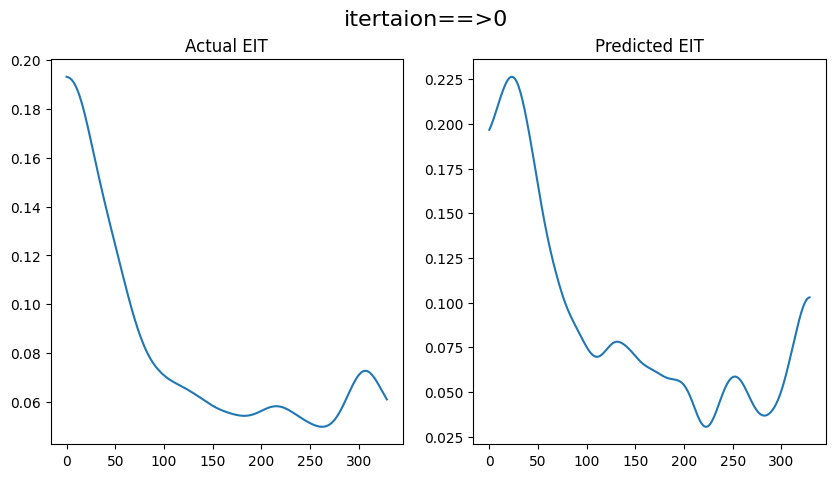

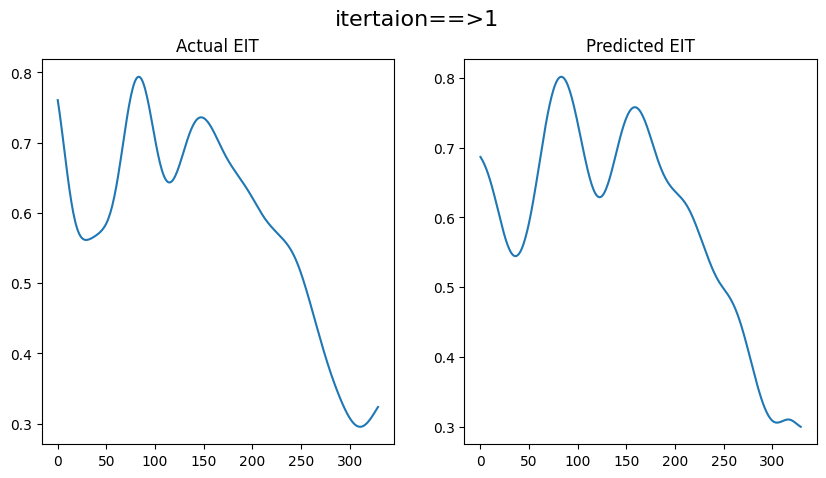

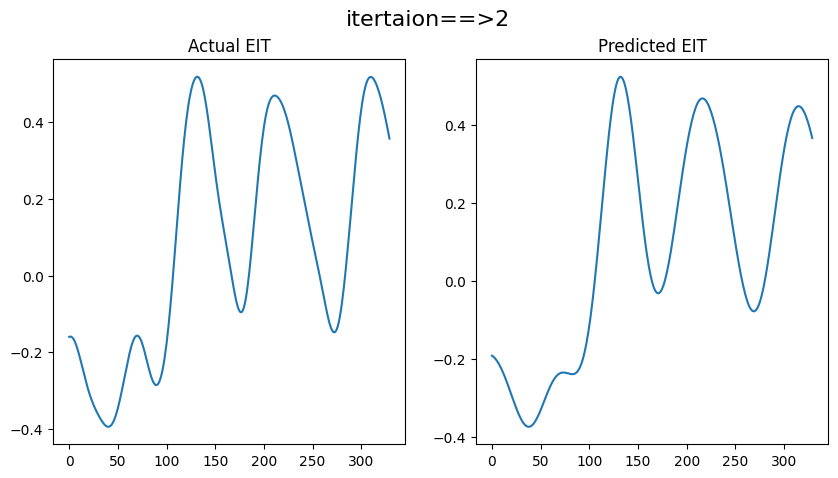

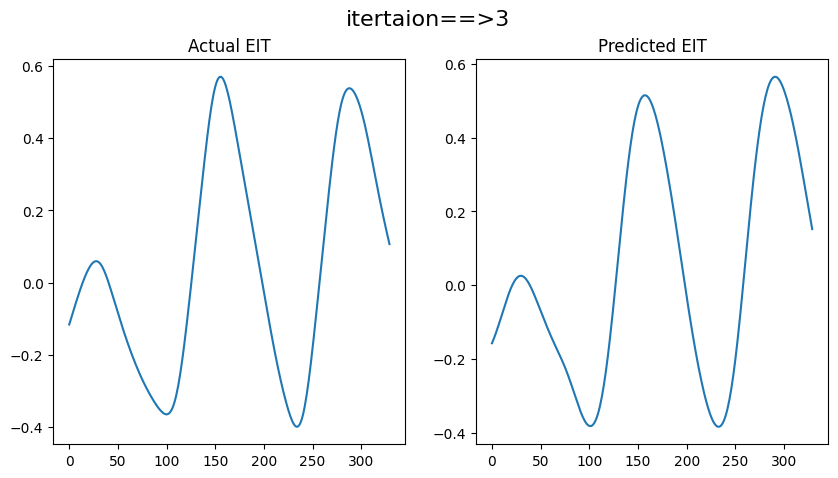

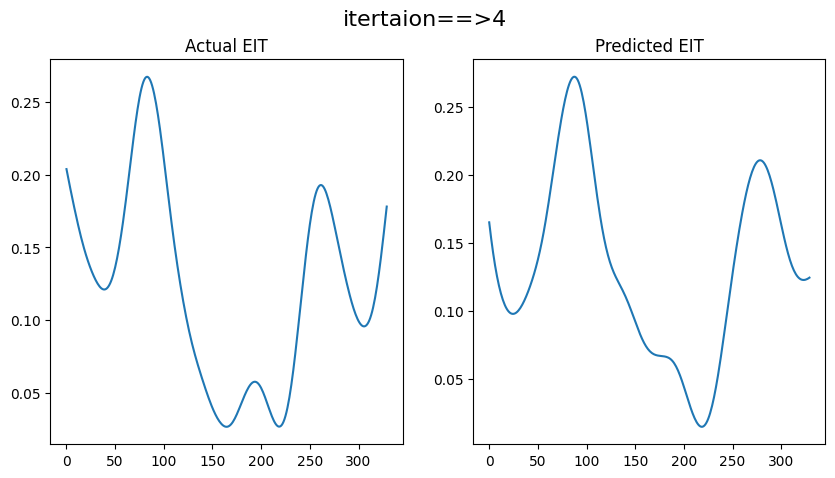

...

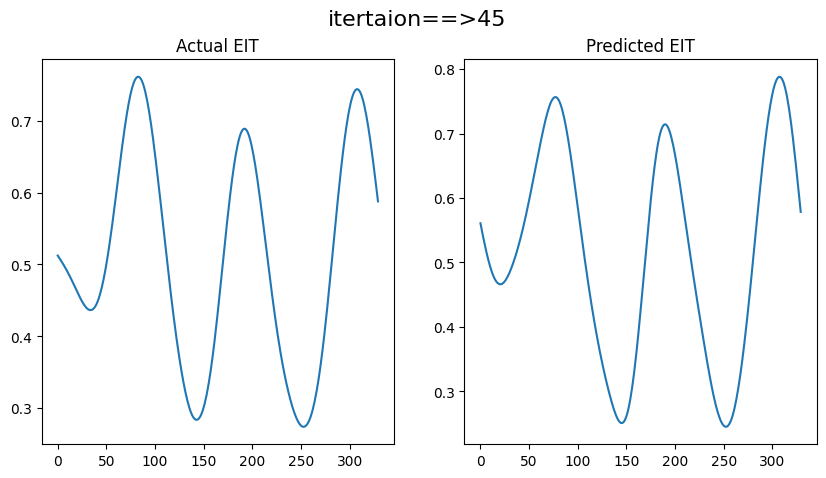

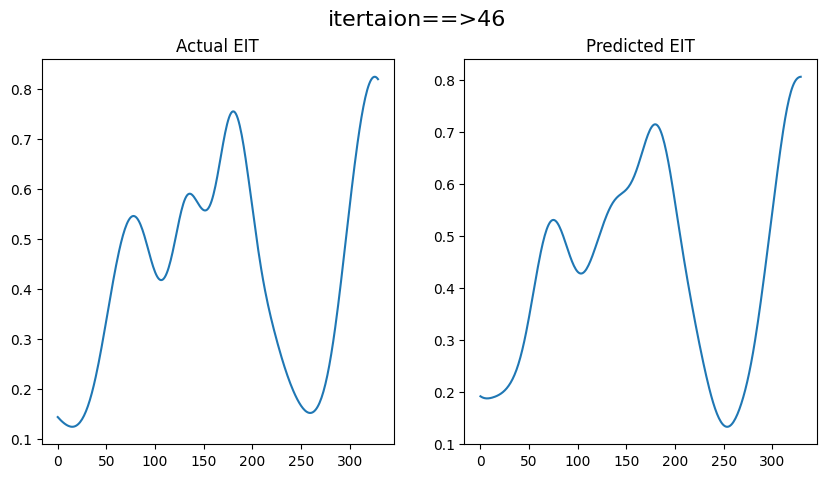

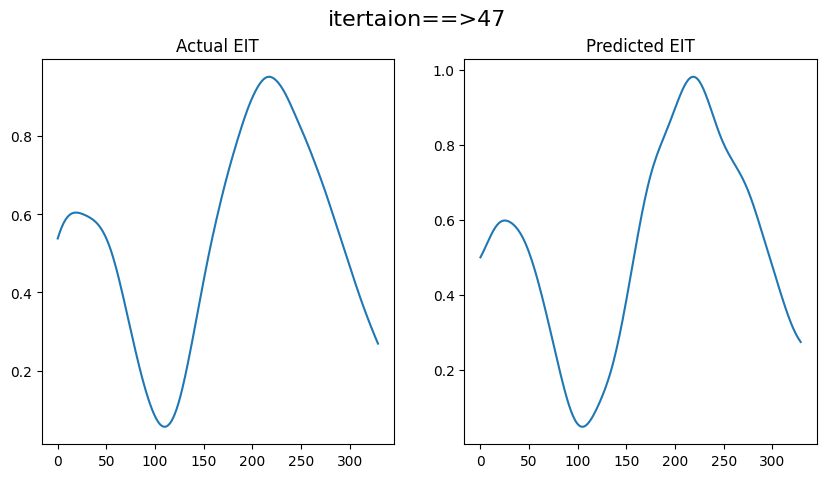

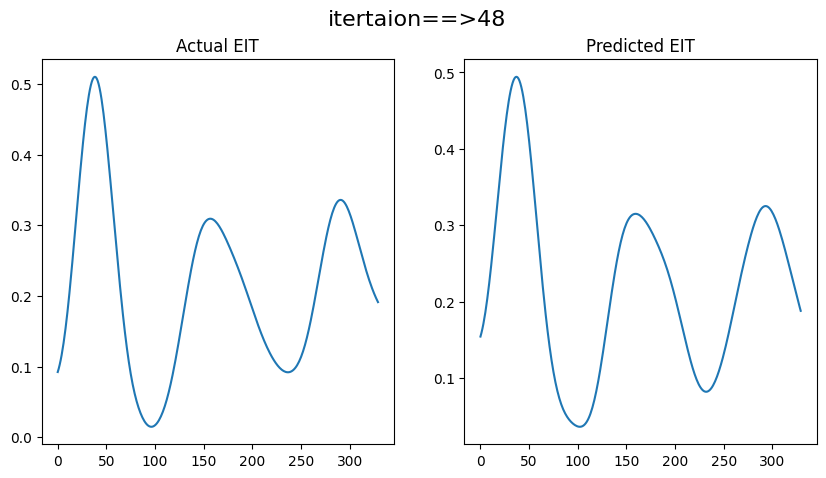

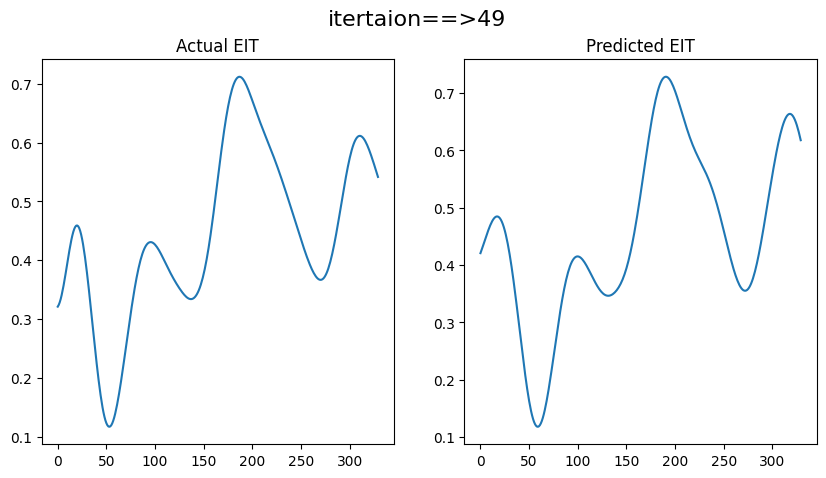

Average MAE: 0.03140799895842561
Standard Deviation MAE: 0.019456800073305806
Average MSE: 0.002055784078062788
Standard Deviation MSE: 0.008260957976853204
Average RMSE: 0.03953111651394481
Standard Deviation RMSE: 0.022205290027912456
Average PCC: 0.9776504821672295
Standard Deviation PCC: 0.043206861896717796


In [ ]:
EIT_tbdb_path_10sec='/content/gdrive/MyDrive/ARKA/EIT_work/TbDb/10_sec_data/EIT_98d5ov_TbDb.mat'
Melspec_tbdb_path_10sec='/content/gdrive/MyDrive/ARKA/EIT_work/TbDb/10_sec_data/Melspecs_TbDb'
EIT_tbcs_path_10sec='/content/gdrive/MyDrive/ARKA/EIT_work/TbCS/10_sec_data/EIT_tbcs.mat'
Melspec_tbcs_path_10sec='/content/gdrive/MyDrive/ARKA/EIT_work/TbCS/10_sec_data/Melspecs_tbcs'

model_tbdb_tbcs_path_10sec='/content/gdrive/MyDrive/ARKA/EIT_work/Results/shrinkcnn_transformer_lstm/TbDb_TbCS/Model/EIT_model_tbdb_tbcs.json'
model_tbdb_tbcs_weight_path_10sec='/content/gdrive/MyDrive/ARKA/EIT_work/Results/shrinkcnn_transformer_lstm/TbDb_TbCS/Model/EIT_model_weights_tbdb_tbcs.h5'

results_gen(Melspec_tbdb_path_10sec, EIT_tbdb_path_10sec, Melspec_tbcs_path_10sec, EIT_tbcs_path_10sec, model_tbdb_tbcs_path_10sec, model_tbdb_tbcs_weight_path_10sec)

### **15-sec**

shape of melspectrogram TbCS+TbDb dataset(6841, 64, 115, 1)
shape of EIT TbCS+TbDb dataset(6841, 495, 1)
shape of labels TbCS+TbDb dataset(6841,)
22/22 [==============================] - 4s 156ms/step


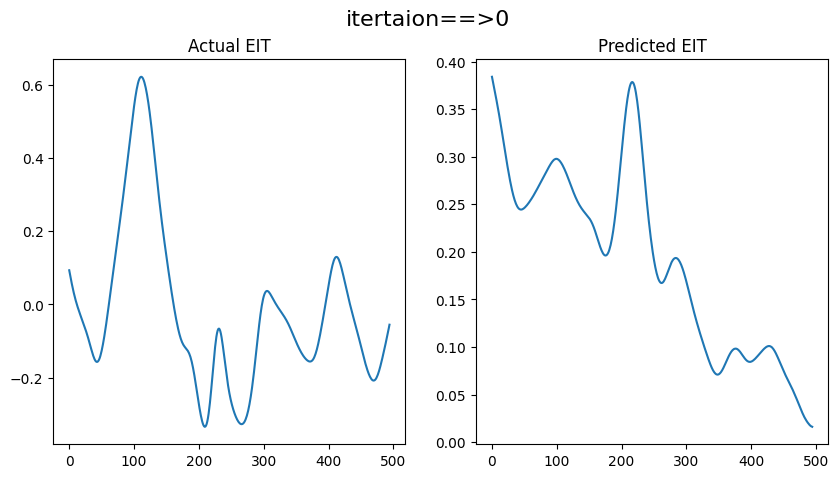

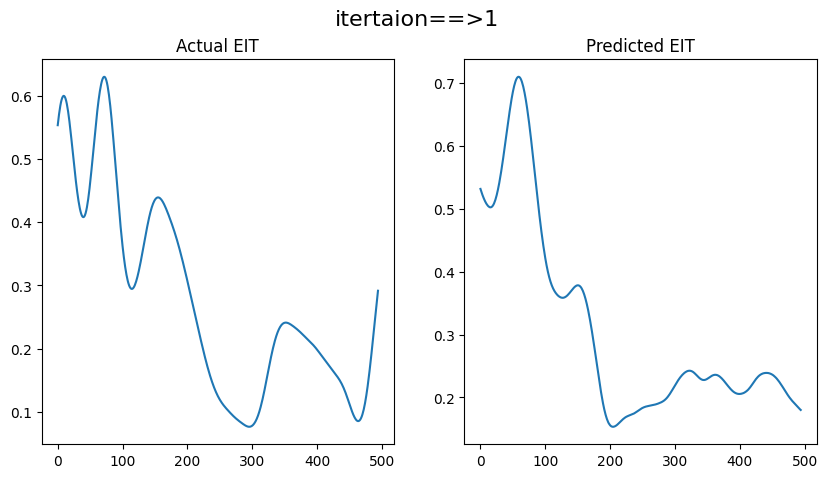

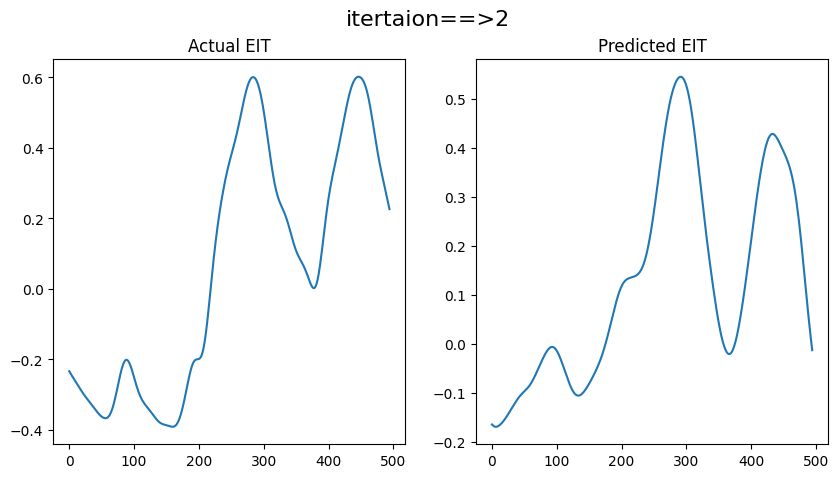

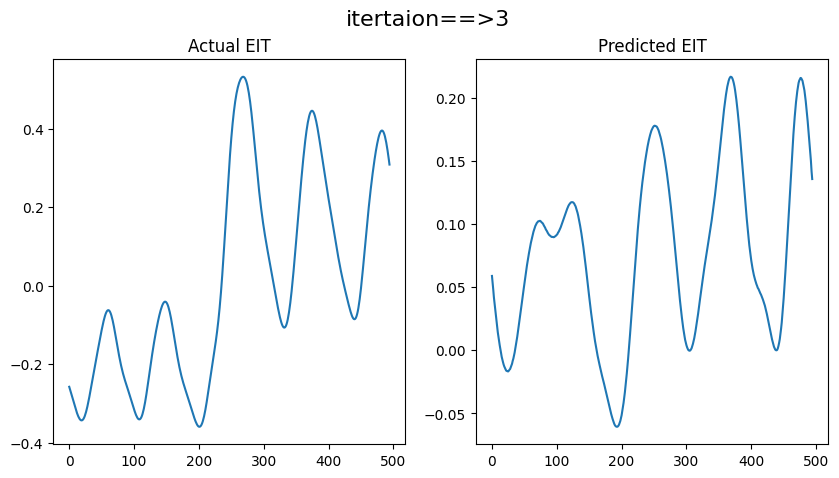

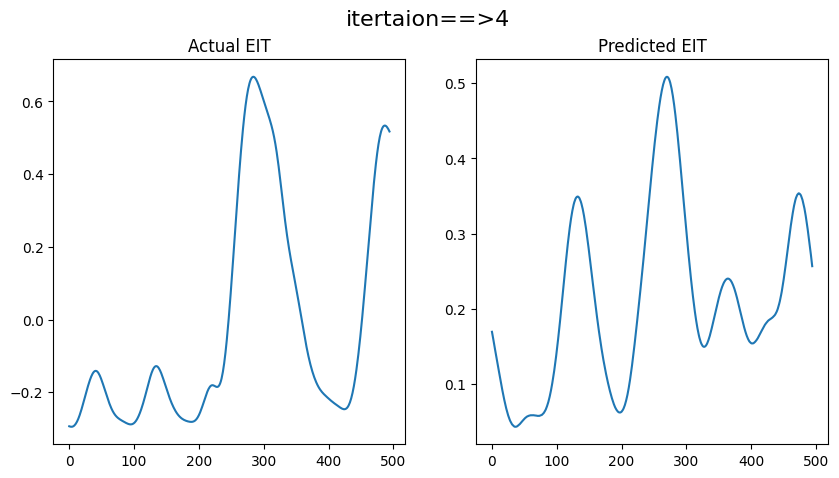

...

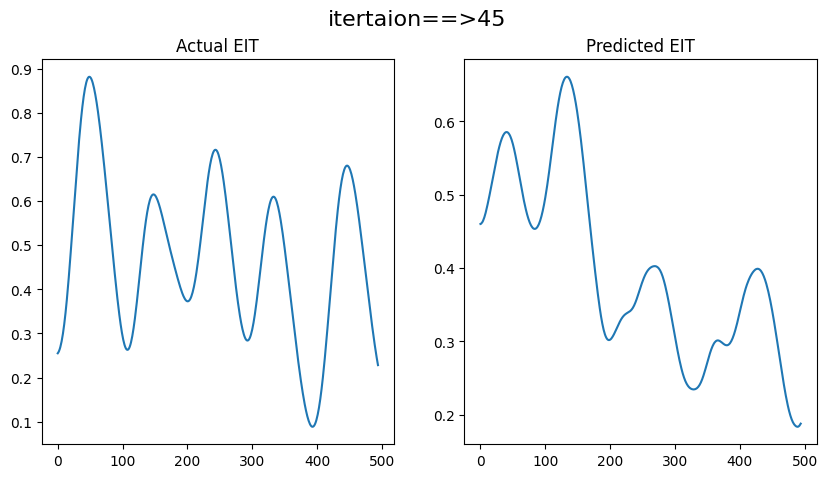

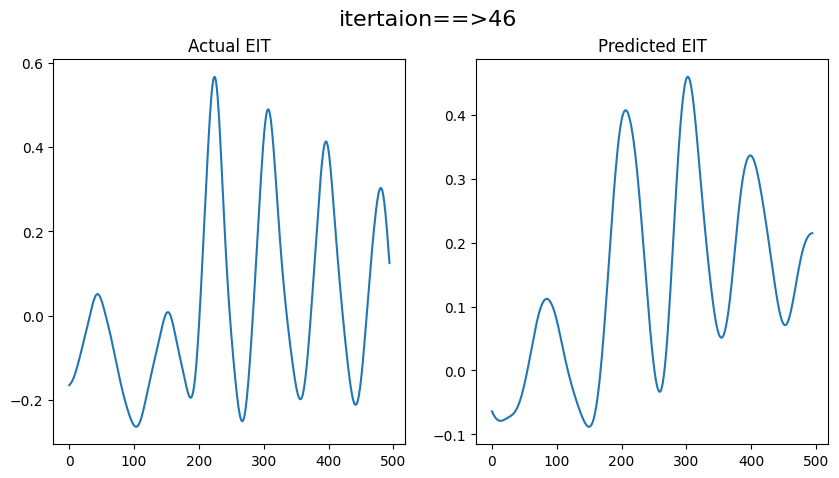

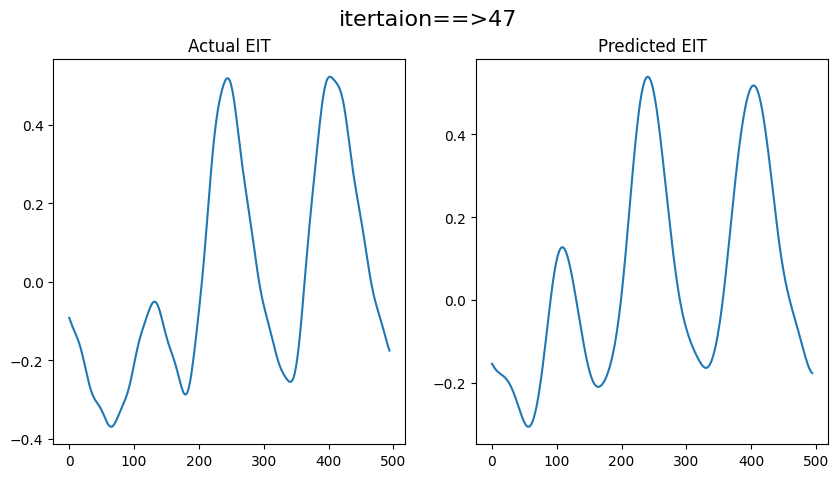

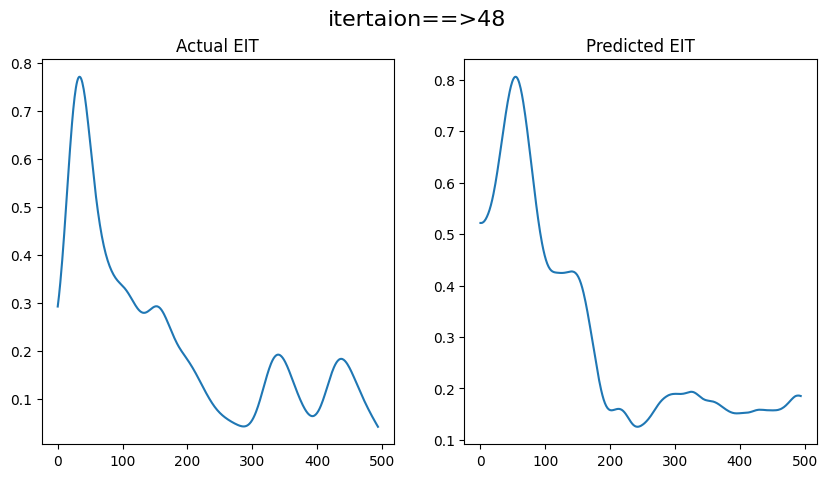

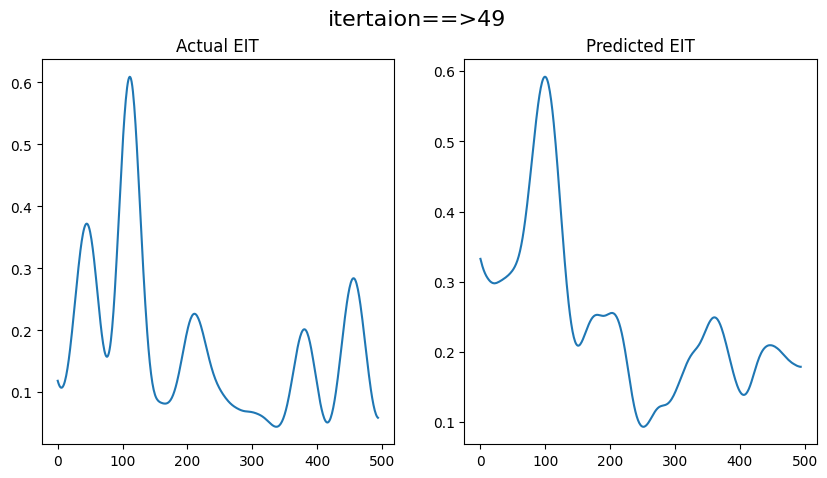

Average MAE: 0.1791818951216103
Standard Deviation MAE: 0.07646261104987137
Average MSE: 0.050814734403364197
Standard Deviation MSE: 0.03733773746208071
Average RMSE: 0.21020132064702093
Standard Deviation RMSE: 0.08142566672501052
Average PCC: 0.6397339499685281
Standard Deviation PCC: 0.2606183080714153


In [ ]:
Melspec_tbdb_path_15sec='/content/gdrive/MyDrive/ARKA/EIT_work/TbDb/15_sec_data/Melspecs_TbDb_15sec'
EIT_tbdb_path_15sec='/content/gdrive/MyDrive/ARKA/EIT_work/TbDb/15_sec_data/EITs_TbDb_15sec.mat'
Melspec_tbcs_path_15sec='/content/gdrive/MyDrive/ARKA/EIT_work/TbCS/15_sec_data/Melspecs_tbcs_15sec'
EIT_tbcs_path_15sec='/content/gdrive/MyDrive/ARKA/EIT_work/TbCS/15_sec_data/EITs_tbcs_15sec.mat'

model_tbdb_tbcs_path_15sec='/content/gdrive/MyDrive/ARKA/EIT_work/TbDb_TbCS_results/15_sec/EIT_model_tbdb_tbcs_15sec.json'
model_tbdb_tbcs_weight_path_15sec='/content/gdrive/MyDrive/ARKA/EIT_work/TbDb_TbCS_results/15_sec/EIT_model_tbdb_tbcs_15sec_weights.h5'

results_gen(Melspec_tbdb_path_15sec, EIT_tbdb_path_15sec, Melspec_tbcs_path_15sec, EIT_tbcs_path_15sec, model_tbdb_tbcs_path_15sec, model_tbdb_tbcs_weight_path_15sec)